In [1]:
import scanpy as sc
import pandas as pd 
import numpy as np
from scipy.sparse import csr_matrix
import scipy.stats as stats
import matplotlib.pyplot as plt
import matplotlib as mpl
import warnings
from nero import Harmonia
import seaborn as sns
from matplotlib import cm
from matplotlib import colors

In [ ]:
# merge clusters 
#adata.obs['louvain']=adata.obs['louvain'].where(adata.obs['louvain']!='CD14+ Mono2','CD14+ Mono')

# Make scanpy colors

In [365]:
vega_10 = list(map(colors.to_hex, cm.tab10.colors))
vega_10_scanpy = vega_10.copy()
vega_10_scanpy[2] = '#279e68'  # green
vega_10_scanpy[4] = '#aa40fc'  # purple
vega_10_scanpy[8] = '#b5bd61'  # kakhi

# default matplotlib 2.0 palette
# see 'category20' on https://github.com/vega/vega/wiki/Scales#scale-range-literals
vega_20 = list(map(colors.to_hex, cm.tab20.colors))
vega_20_scanpy = [
    *vega_20[0:14:2], *vega_20[16::2],  # dark without grey
    *vega_20[1:15:2], *vega_20[17::2],  # light without grey
    '#ad494a', '#8c6d31',  # manual additions
]
vega_20_scanpy[2] = vega_10_scanpy[2]
vega_20_scanpy[4] = vega_10_scanpy[4]
vega_20_scanpy[7] = vega_10_scanpy[8] 

In [543]:
vega_20_scanpy

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#ff9896',
 '#c5b0d5',
 '#c49c94',
 '#f7b6d2',
 '#dbdb8d',
 '#9edae5',
 '#ad494a',
 '#8c6d31']

In [2]:
# might need this, the most recent version of jupterlab I installed installed the most recent version of jedi which has been having problems with autocomplete
# see thread here: https://github.com/ipython/ipython/issues/10493
%config Completer.use_jedi = False

sc.settings.verbosity = 4
sc.settings.set_figure_params(dpi=80)

In [880]:
sc.set_figure_params(dpi_save=1000,figsize=[5,5])

In [ ]:
cytof_umap_proportions_001 = [0.2254,
0.1817,
0.1349,
0.0698,
0.0919,
0.084,
0.1064,
0.0161,
0.0345,
0.0461,
0.0091]

In [ ]:
cytof_umap_proportions_003 = [0.2851,
0.0544,
0.1418,
0.1199,
0.1745,
0.0706,
0.0582,
0.0177,
0.0393,
0.0087,
0.0295]

# 100k data

In [648]:
meta_df = pd.read_table('/wynton/group/ye/david/Cyto-seq/200204/100K_meta_ab_cell_matrix-2.txt',sep=',')
adt_df = pd.read_table('/wynton/group/ye/david/Cyto-seq/200204/100K_selected_ab_cell_matrix-2.txt',sep=',')           

In [4]:
meta_df.shape

(53644, 7)

In [5]:
adt_df.shape

(28, 53644)

In [6]:
meta_df.head()

,orig.ident,nCount_RNA,nFeature_RNA,Batch,Type,nCount_ADT,nFeature_ADT
X13,SeuratProject,1923,27,Batch1,Doublet,1923,27
X21,SeuratProject,1610,24,Batch1,Doublet,1610,24
X39,SeuratProject,1153,27,Batch1,Singlet,1153,27
X45,SeuratProject,1523,25,Batch1,Singlet,1523,25
X48,SeuratProject,1106,25,Batch1,Doublet,1106,25


In [7]:
adt_df.T.head()

,1,2,3,4,5,6,7,8,9,10,...,19,20,21,22,23,24,25,26,27,28
X13,537,2,9,4,12,3,3,391,29,1,...,7,4,175,20,2,2,65,97,1,3
X21,389,5,84,0,7,0,0,469,16,3,...,5,2,214,8,5,2,56,34,2,3
X39,298,1,3,2,5,1,2,308,15,5,...,2,3,79,6,3,3,21,11,1,2
X45,345,1,2,0,181,1,0,4,1,364,...,3,133,10,8,2,1,11,2,4,2
X48,356,4,3,2,8,3,1,296,15,8,...,0,1,72,8,1,2,28,25,1,3


In [649]:
adt_from_R_adata = sc.AnnData(adt_df.T)
adt_from_R_adata.obs = meta_df
adt_from_R_adata.obs

sc.pp.normalize_per_cell(adt_from_R_adata, counts_per_cell_after=1e4)

Transforming to str index.


In [650]:
batch1 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch1']
batch2 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch2']
batch3 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch3']
batch4 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch4']
batch5 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch5']
batch6 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch6']
batch7 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch7']
batch8 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch8']
batch9 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch9']
batch10 = adt_from_R_adata[adt_from_R_adata.obs['Batch']=='Batch10']

sc.pp.log1p(batch1)
sc.pp.log1p(batch2)
sc.pp.log1p(batch3)
sc.pp.log1p(batch4)
sc.pp.log1p(batch5)
sc.pp.log1p(batch6)
sc.pp.log1p(batch7)
sc.pp.log1p(batch8)
sc.pp.log1p(batch9)
sc.pp.log1p(batch10)

sc.pp.scale(batch1, max_value=10)
sc.pp.scale(batch2, max_value=10)
sc.pp.scale(batch3, max_value=10)
sc.pp.scale(batch4, max_value=10)
sc.pp.scale(batch5, max_value=10)
sc.pp.scale(batch6, max_value=10)
sc.pp.scale(batch7, max_value=10)
sc.pp.scale(batch8, max_value=10)
sc.pp.scale(batch9, max_value=10)
sc.pp.scale(batch10, max_value=10)

per_batch_norm_from_R_adata = batch1.concatenate(batch2,batch3,batch4,batch5,batch6,batch7,batch8,batch9,batch10)

/wynton/home/ye/davidslee/anaconda3/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:298: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(data)


In [651]:
per_batch_norm_from_R_adata.var_names_make_unique()

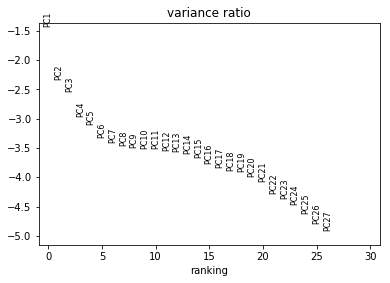

In [652]:
sc.tl.pca(per_batch_norm_from_R_adata, svd_solver='arpack', use_highly_variable=None)
sc.pl.pca_variance_ratio(per_batch_norm_from_R_adata, log=True)

In [653]:
sc.pp.neighbors(per_batch_norm_from_R_adata, n_neighbors=10, n_pcs=15)
sc.tl.leiden(per_batch_norm_from_R_adata,resolution=0.65)
sc.tl.umap(per_batch_norm_from_R_adata)

/wynton/home/ye/davidslee/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../home/ye/davidslee/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


In [654]:
ptn_names =pd.DataFrame(['CD45','CD235','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'])

ptn_names.columns=['Antibody']
ptn_names = ptn_names.set_index('Antibody')

per_batch_norm_from_R_adata.var = ptn_names

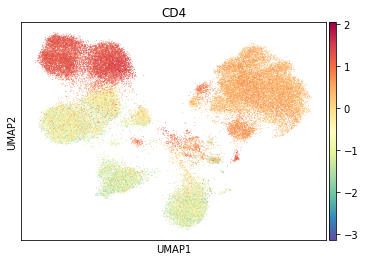

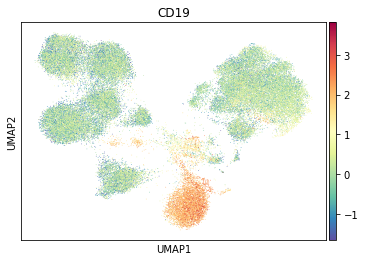

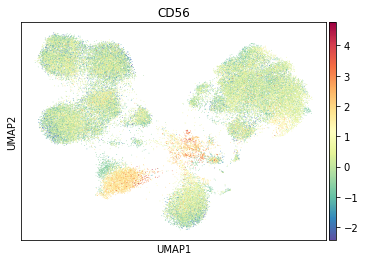

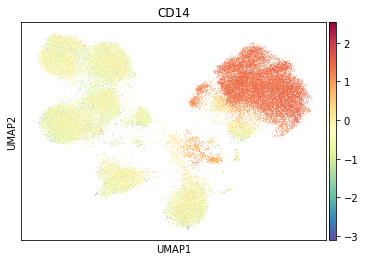

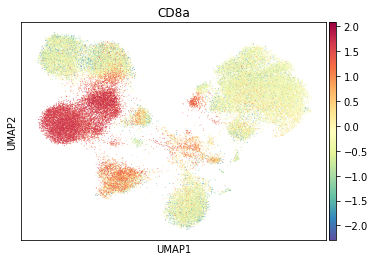

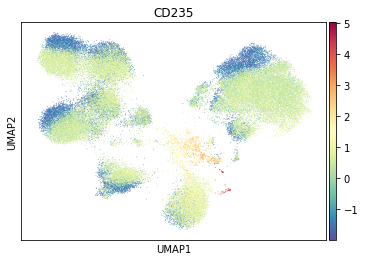

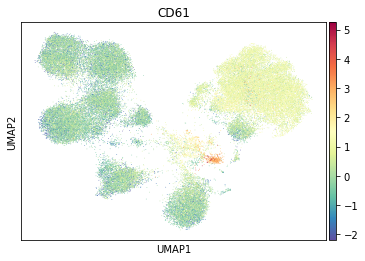

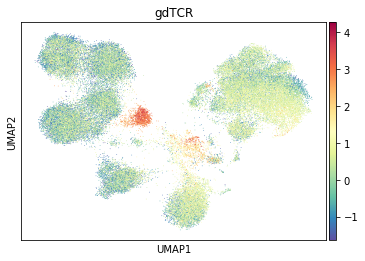

In [60]:
sc.pl.umap(per_batch_norm_from_R_adata, color=['CD4'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd4_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata, color=['CD19'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd19_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata, color=['CD56'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd56_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata, color=['CD14'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd14_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata, color=['CD8a'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd8a_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata, color=['CD235'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd235_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata, color=['CD61'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd61_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata, color=['gdTCR'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd61_resolved.png")

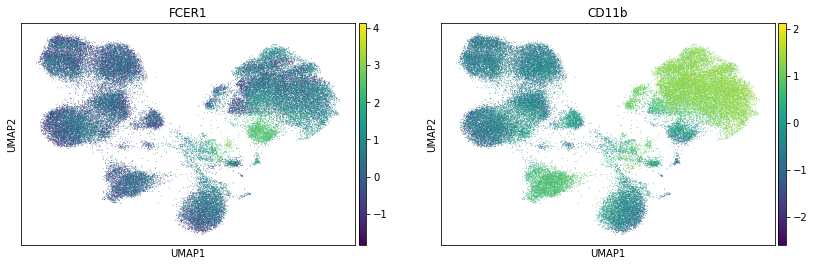

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

In [815]:
sc.pl.umap(tester,color = ['FCER1','CD11b'])


Trying to set attribute `.uns` of view, copying.


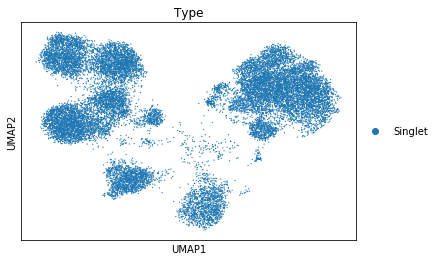

Trying to set attribute `.uns` of view, copying.


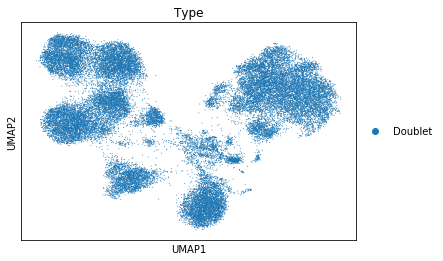

In [816]:
sc.pl.umap(per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['Type']== 'Singlet'], color = 'Type',ncols =3)
sc.pl.umap(per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['Type']== 'Doublet'], color = 'Type')

In [889]:
singlet_norm = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['Type']== 'Singlet']
multiplet_norm = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['Type']== 'Doublet']

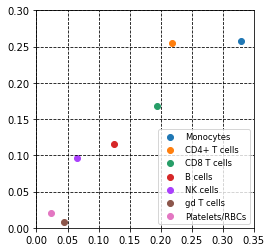

In [461]:
fig, ax = plt.subplots()
x = multiplet_proportion
y = cytof_proportions
names = ['CD14','CD4','CD8a','CD19','CD56','gdT','plat_RBC']

colors = vega_20_scanpy[0:7]
CD14 = plt.scatter(multiplet_proportion[0], cytof_proportions[0], marker='o', color=colors[0])
CD4 = plt.scatter(multiplet_proportion[1], cytof_proportions[1], marker='o', color=colors[1])
CD8a  = plt.scatter(multiplet_proportion[2], cytof_proportions[2], marker='o', color=colors[2])
CD19  = plt.scatter(multiplet_proportion[3], cytof_proportions[3], marker='o', color=colors[3])
CD56  = plt.scatter(multiplet_proportion[4], cytof_proportions[4], marker='o', color=colors[4])
gdT = plt.scatter(multiplet_proportion[5], cytof_proportions[5], marker='o', color=colors[5])
plat_RBC = plt.scatter(multiplet_proportion[6], cytof_proportions[6], marker='o', color=colors[6])

plt.legend((CD14,CD4,CD8a,CD19,CD56,gdT,plat_RBC),
           ('Monocytes','CD4+ T cells','CD8 T cells','B cells','NK cells','gd T cells','Platelets/RBCs'), loc = 'lower right', fontsize ='small')
  


ax.set_xlim((0,.35))
ax.set_ylim((0,.3))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('multiplet_cytof_correlation_100k.png', dpi=600)



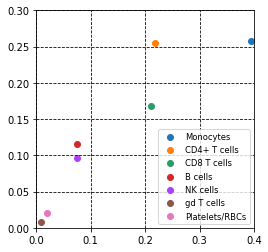

In [462]:
fig, ax = plt.subplots()
x = singlet_proportion
y = cytof_proportions

colors = vega_20_scanpy[0:7]
CD14 = plt.scatter(singlet_proportion[0], cytof_proportions[0], marker='o', color=colors[0])
CD4 = plt.scatter(singlet_proportion[1], cytof_proportions[1], marker='o', color=colors[1])
CD8a  = plt.scatter(singlet_proportion[2], cytof_proportions[2], marker='o', color=colors[2])
CD19  = plt.scatter(singlet_proportion[3], cytof_proportions[3], marker='o', color=colors[3])
CD56  = plt.scatter(singlet_proportion[4], cytof_proportions[4], marker='o', color=colors[4])
gdT = plt.scatter(singlet_proportion[5], cytof_proportions[5], marker='o', color=colors[5])
plat_RBC = plt.scatter(singlet_proportion[6], cytof_proportions[6], marker='o', color=colors[6])

plt.legend((CD14,CD4,CD8a,CD19,CD56,gdT,plat_RBC),
           ('Monocytes','CD4+ T cells','CD8 T cells','B cells','NK cells','gd T cells','Platelets/RBCs'),loc = 'lower right', fontsize = 'small')
  


ax.set_xlim((0,.4))
ax.set_ylim((0,.3))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('singlet_cytof_correlation_100k.png', dpi=600)



In [516]:
colors = vega_20_scanpy[0:7]

In [517]:
colors

['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#e377c2']

In [375]:
cytof_proportions

[0.258, 0.255, 0.168, 0.116, 0.0958, 0.021, 0.0075]

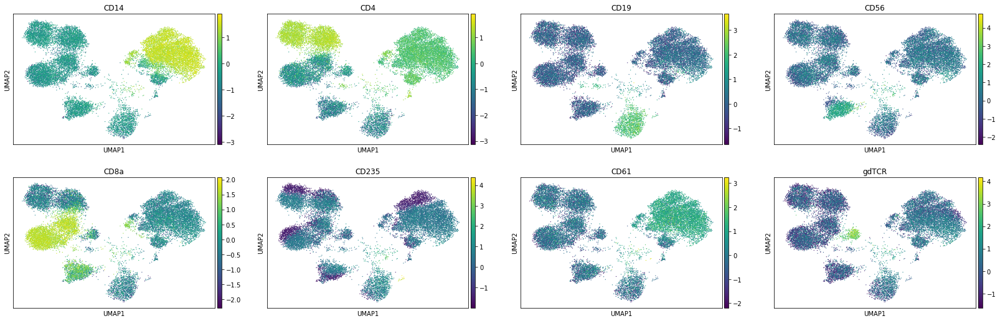

In [370]:
sc.pl.umap(singlet_norm, color = ['CD14','CD4','CD19','CD56','CD8a','CD235','CD61','gdTCR'])

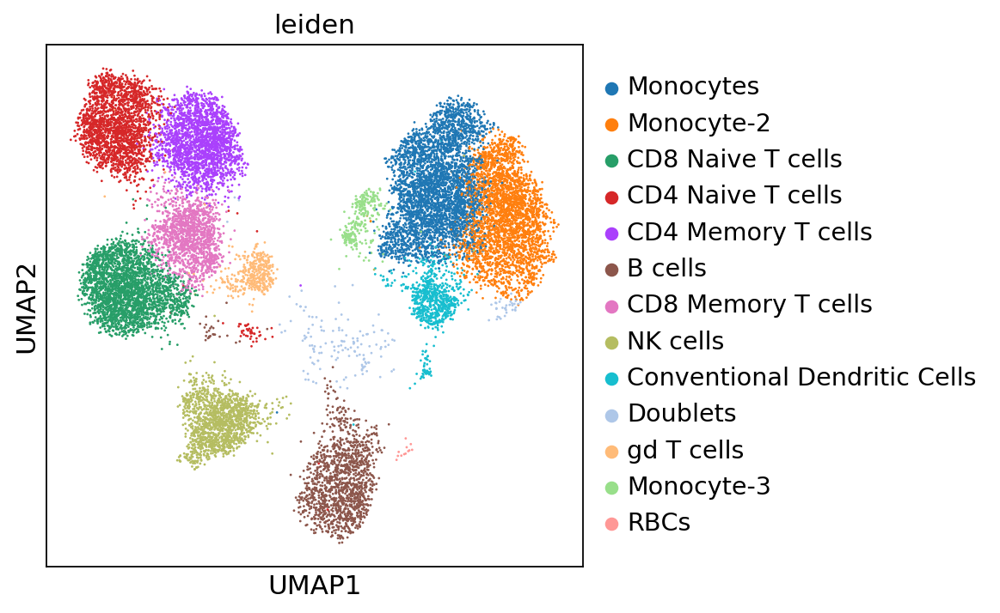

In [890]:
sc.pl.umap(singlet_norm,color = 'leiden')

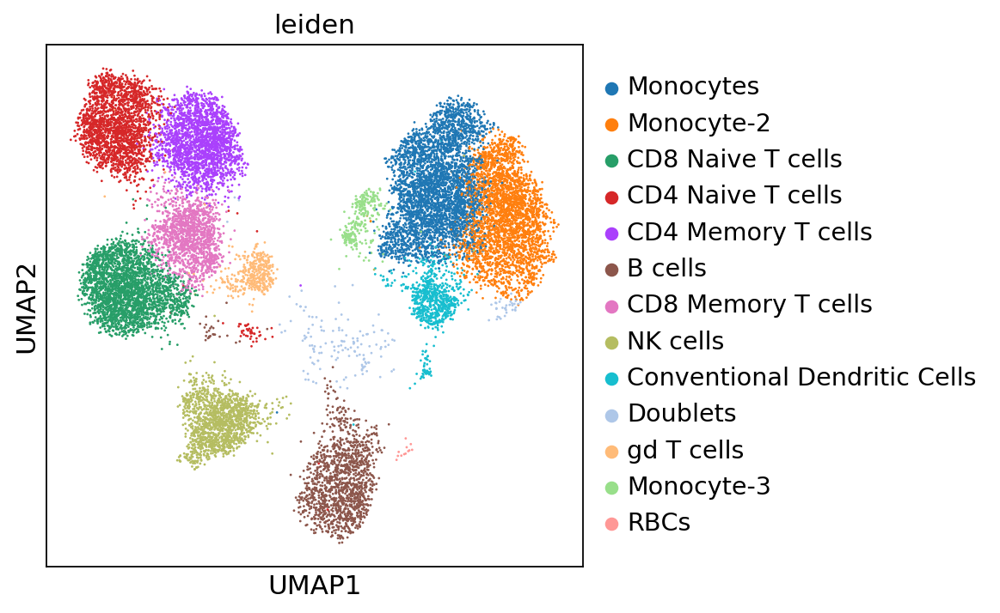

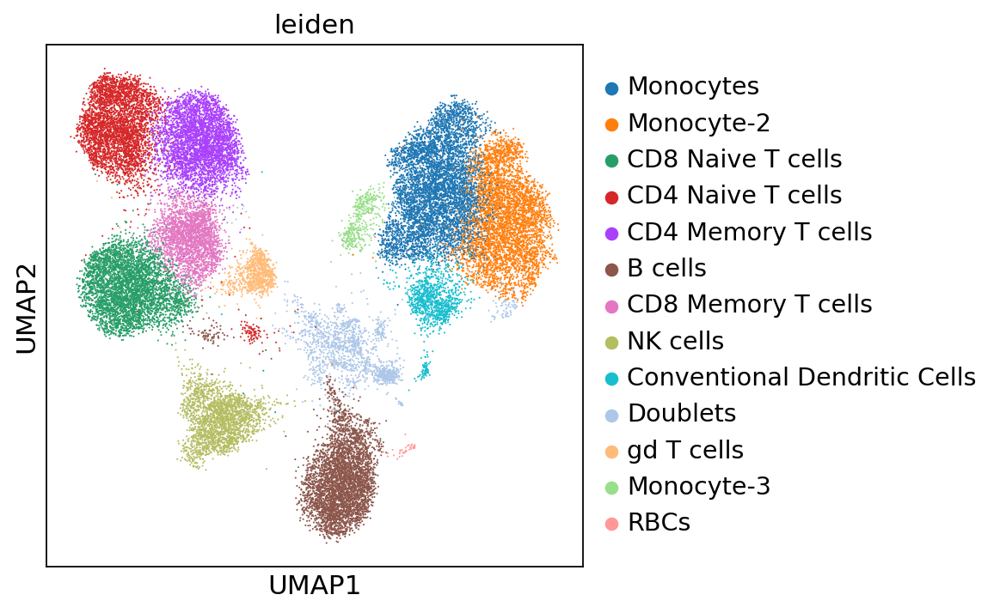

In [891]:
sc.pl.umap(singlet_norm,color = 'leiden', save="200204_100k_singlet_UMAP.png")
sc.pl.umap(multiplet_norm, color = 'leiden', save="200204_100k_doublet_UMAP.png")

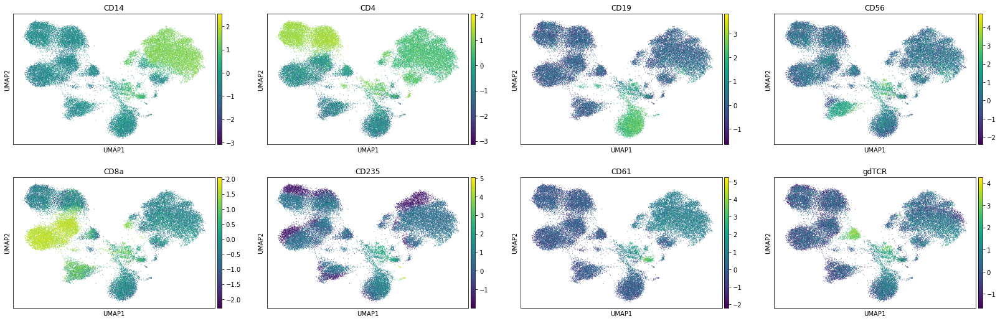

In [538]:
sc.pl.umap(multiplet_norm, color = ['CD14','CD4','CD19','CD56','CD8a','CD235','CD61','gdTCR'])

In [421]:
CD14 = singlet_norm[singlet_norm.obs['leiden']=='Monocytes'].shape[0] / singlet_norm.shape[0]
CD4 = singlet_norm[singlet_norm.obs['leiden']=='CD4+ T cells'].shape[0] / singlet_norm.shape[0]
CD8a = singlet_norm[singlet_norm.obs['leiden']=='CD8a+ T cells'].shape[0] / singlet_norm.shape[0]
CD19 = singlet_norm[singlet_norm.obs['leiden']=='B cells'].shape[0] / singlet_norm.shape[0]
CD56 = singlet_norm[singlet_norm.obs['leiden']=='NK cells'].shape[0] / singlet_norm.shape[0]
gdT = singlet_norm[singlet_norm.obs['leiden']=='gd T cells'].shape[0] / singlet_norm.shape[0]
plat_RBC = singlet_norm[singlet_norm.obs['leiden']=='Platelets/RBCs'].shape[0] / singlet_norm.shape[0]

In [422]:
singlet_proportion = [CD14,CD4,CD8a,CD19,CD56,plat_RBC,gdT]

In [423]:
singlet_proportion

[0.39377184288769496,
 0.21871576860883626,
 0.21099577486829066,
 0.0751134526107141,
 0.07386156173386886,
 0.008085128579625477,
 0.019456470710969693]

In [427]:
CD14 = multiplet_norm[multiplet_norm.obs['leiden']=='Monocytes'].shape[0] / multiplet_norm.shape[0]
CD4 = multiplet_norm[multiplet_norm.obs['leiden']=='CD4+ T cells'].shape[0] / multiplet_norm.shape[0]
CD8a = multiplet_norm[multiplet_norm.obs['leiden']=='CD8a+ T cells'].shape[0] / multiplet_norm.shape[0]
CD19 = multiplet_norm[multiplet_norm.obs['leiden']=='B cells'].shape[0] / multiplet_norm.shape[0]
CD56 = multiplet_norm[multiplet_norm.obs['leiden']=='NK cells'].shape[0] / multiplet_norm.shape[0]
gdT = multiplet_norm[multiplet_norm.obs['leiden']=='gd T cells'].shape[0] / multiplet_norm.shape[0]
plat_RBC = multiplet_norm[multiplet_norm.obs['leiden']=='Platelets/RBCs'].shape[0] / multiplet_norm.shape[0]

In [428]:
multiplet_proportion = [CD14,CD4,CD8a,CD19,CD56,plat_RBC,gdT]

In [429]:
multiplet_proportion

[0.329156151190787,
 0.21753256171496532,
 0.19435500246569778,
 0.12493835755518812,
 0.06547152844254925,
 0.04499173266034288,
 0.023554665970469645]

In [282]:
stats.pearsonr(multiplet_proportion, singlet_proportion)

(0.9806588187992848, 9.888866982458782e-05)

In [286]:
stats.pearsonr(multiplet_proportion, cytof_proportions)

(0.9375690992351259, 0.0018083019617336693)

In [287]:
stats.pearsonr(singlet_proportion, cytof_proportions)

(0.9152760008637124, 0.003832374668979287)

In [283]:
np.sum(singlet_proportion)

1.0

In [284]:
np.sum(multiplet_proportion)

1.0

In [288]:
np.sum(cytof_proportions)

0.9213

In [ ]:
sc.pl.umap(per_batch_norm_from_R_adata, color=['gdTCR'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd61_resolved.png")

In [536]:
sc.tl.leiden(per_batch_norm_from_R_adata, resolution = 0.65)

In [ ]:
sc.pl.umap(per_batch_norm_from_R_adata, color=['leiden'])

In [ ]:
adata.obs['louvain']=adata.obs['louvain'].where(adata.obs['louvain']!='CD14+ Mono2','CD14+ Mono')

In [752]:
new_cluster_names = ['Monocytes','Monocyte-2','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Conventional Dendritic Cells','Doublets','gd T cells','Monocyte-3',
                     'RBCs']
per_batch_norm_from_R_adata.rename_categories('leiden', new_cluster_names)

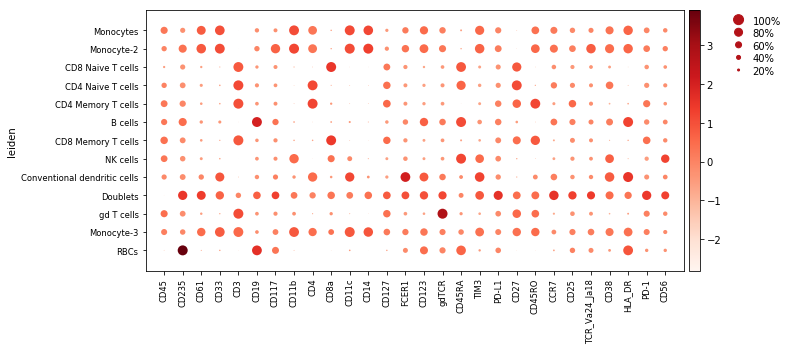

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[9.799999999999999, 0, 0.2, 0.5, 0.25])

In [555]:
sc.pl.dotplot(per_batch_norm_from_R_adata, groupby = 'leiden', var_names = ['CD45','CD235','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'])

In [664]:
Monocytes = (per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='Monocytes'].shape[0]+per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='Monocyte-2'].shape[0] ) / per_batch_norm_from_R_adata.shape[0]
CD8_naive = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='CD8 Naive T cells'].shape[0] / per_batch_norm_from_R_adata.shape[0]
CD4_naive = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='CD4 Naive T cells'].shape[0] / per_batch_norm_from_R_adata.shape[0]
CD4_mem = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='CD4 Memory T cells'].shape[0] / per_batch_norm_from_R_adata.shape[0]
B = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='B cells'].shape[0] / per_batch_norm_from_R_adata.shape[0]
CD8_mem = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='CD8 Memory T cells'].shape[0] / per_batch_norm_from_R_adata.shape[0]
NK = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='NK cells'].shape[0] / per_batch_norm_from_R_adata.shape[0]
doublets = (per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='Doublets'].shape[0]+per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='Monocyte-3'].shape[0]) / per_batch_norm_from_R_adata.shape[0]
cDC = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='Conventional Dendritic Cells'].shape[0] / per_batch_norm_from_R_adata.shape[0]
gd = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='gd T cells'].shape[0] / per_batch_norm_from_R_adata.shape[0]
rbc = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='RBCs'].shape[0] / per_batch_norm_from_R_adata.shape[0]


In [665]:
pbmc_100k_proportions = [Monocytes, CD8_naive, CD4_naive, CD4_mem, B, CD8_mem, NK, doublets, cDC, gd, rbc]

In [214]:
per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['leiden']=='gd T cells'].shape[0] / per_batch_norm_from_R_adata.shape[0]

0.02209007531131161

In [ ]:
seq_proportions = [CD14,CD4,CD8a,CD19,CD56,gdT]

In [ ]:
BH_seq_proportions

In [178]:
seq_proportions

[0.35224815450003727,
 0.21795540973827454,
 0.20030199090299008,
 0.1071322049064201,
 0.06846991275818358]

In [398]:
cytof_proportions = [.258,.255,.168,.116,.0958,.00750,.0210]

In [193]:
cytof_proportions[1:]

[0.255, 0.168, 0.116, 0.0958]

In [200]:
stats.pearsonr(BH_seq_proportions, cytof_proportions)

(0.9026042409396724, 0.0359497003371367)

# UMAP for finding the cell type info

In [120]:
adt_df_negative = pd.read_table('/wynton/group/ye/david/Cyto-seq/200204/200204_low_negatives_HTO_0.99.txt',sep=' ', header=None)

In [121]:
adt_df_negative_95 = pd.read_table('/wynton/group/ye/david/Cyto-seq/200204/200204_low_negatives_HTO_0.95.txt',sep=' ', header=None)

In [122]:
adt_df_negative.columns = ['cell', 'negatives']

In [125]:
adt_df = pd.read_csv('/wynton/group/ye/david/Cyto-seq/200204/200204_pbmc_low_raw_for_umap_resolved_raw.txt',sep='\t', header=None)

In [126]:
adt_df_resolve_clean = adt_df.drop([28], axis=1)

In [127]:
adt_df_resolve_clean.shape

(342860, 28)

In [128]:
adt_df_resolve_clean.head()

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,2.0,2.0,0.0,0.0,2.0,2.0,0.0,2.0,0.0,2.0,...,0.0,0.0,5.0,5.0,1.0,0.0,0.0,1.0,0.0,0.0
1,457.0,1.0,0.0,3.0,128.0,2.0,3.0,2.0,4.0,36.0,...,3.0,1.0,49.0,4.0,0.0,0.0,4.0,1.0,6.0,3.0
2,769.0,3.0,32.0,43.0,1.0,0.0,2.0,608.0,25.0,6.0,...,3.0,2.0,464.0,13.0,1.0,0.0,33.0,43.0,2.0,7.0
3,5.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,3.0,...,1.0,2.0,0.0,1.0,0.0,1.0,1.0,4.0,1.0,0.0
4,8.0,1.0,2.0,4.0,4.0,3.0,2.0,0.0,1.0,3.0,...,2.0,2.0,0.0,11.0,3.0,2.0,5.0,1.0,0.0,0.0


# add negative classification from HTO demux from Seurat

In [129]:
adt_df_clean_resolved = adt_df_resolve_clean.join(adt_df_negative)

In [130]:
adt_df_clean_resolved['Batch'] = ['Pool1','Pool2','Pool3','Pool4','Pool5','Pool6','Pool7','Pool8','Pool9','Pool10']*34286
adt_df_clean_final = adt_df_clean_resolved[adt_df_clean_resolved['negatives'] != 'Negative']
adt_df_clean_final.head()
df_batch = adt_df_clean_final['Batch'] # add as obs later

adt_df_clean_final = adt_df_clean_final.drop(['cell', 'negatives', 'Batch'], axis=1)
adt_df_clean_final.shape

(60388, 28)

In [131]:
adt_resolved_adata = sc.AnnData(adt_df_clean_final)

Transforming to str index.


In [132]:
df_batch.shape
batch = pd.DataFrame(df_batch)
batch['Batch']
#batch = batch.astype(str)

1          Pool2
2          Pool3
13         Pool4
15         Pool6
18         Pool9
           ...  
342830     Pool1
342836     Pool7
342840     Pool1
342858     Pool9
342859    Pool10
Name: Batch, Length: 60388, dtype: object

In [133]:
batch2 = pd.DataFrame(batch['Batch'])
batch2.columns=['Pool']
#batch2 = batch2.set_index('Pool')

batch2['Pool'] = batch['Batch']
batch2['Batch'] = batch['Batch']
batch2 = batch2.set_index('Pool')

adt_resolved_adata.obs = batch2
batch1 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool1']
batch2 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool2']
batch3 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool3']
batch4 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool4']
batch5 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool5']
batch6 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool6']
batch7 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool7']
batch8 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool8']
batch9 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool9']
batch10 = adt_resolved_adata[adt_resolved_adata.obs['Batch']=='Pool10']

sc.pp.log1p(batch1)
sc.pp.log1p(batch2)
sc.pp.log1p(batch3)
sc.pp.log1p(batch4)
sc.pp.log1p(batch5)
sc.pp.log1p(batch6)
sc.pp.log1p(batch7)
sc.pp.log1p(batch8)
sc.pp.log1p(batch9)
sc.pp.log1p(batch10)

sc.pp.scale(batch1, max_value=10)
sc.pp.scale(batch2, max_value=10)
sc.pp.scale(batch3, max_value=10)
sc.pp.scale(batch4, max_value=10)
sc.pp.scale(batch5, max_value=10)
sc.pp.scale(batch6, max_value=10)
sc.pp.scale(batch7, max_value=10)
sc.pp.scale(batch8, max_value=10)
sc.pp.scale(batch9, max_value=10)
sc.pp.scale(batch10, max_value=10)


/wynton/home/ye/davidslee/anaconda3/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:298: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(data)
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make t

In [134]:
per_batch_norm_adata = batch1.concatenate(batch2,batch3,batch4,batch5,batch6,batch7,batch8,batch9,batch10)
per_batch_norm_adata

Transforming to str index.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Or pass `index_unique!=None` to `.concatenate`.


AnnData object with n_obs × n_vars = 60388 × 28 
    obs: 'Batch', 'batch'

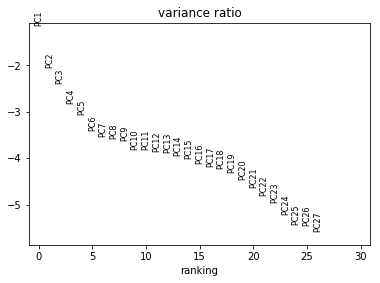

In [138]:
sc.pl.pca_variance_ratio(per_batch_norm_adata, log=True)

In [139]:
sc.pp.neighbors(per_batch_norm_adata, n_neighbors=10, n_pcs=15)

/wynton/home/ye/davidslee/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../home/ye/davidslee/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


In [140]:
sc.tl.leiden(per_batch_norm_adata,resolution=0.2)
#sc.tl.louvain(adt_resolved_adata,resolution=0.2)

In [141]:
sc.tl.umap(per_batch_norm_adata)
#sc.api.tl.tsne(adt_resolved_adata, n_pcs=15, n_jobs=30)

In [142]:
ptn_names =pd.DataFrame(['CD45','CD234','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'])

ptn_names.columns=['Antibody']
ptn_names = ptn_names.set_index('Antibody')

per_batch_norm_adata.var = ptn_names

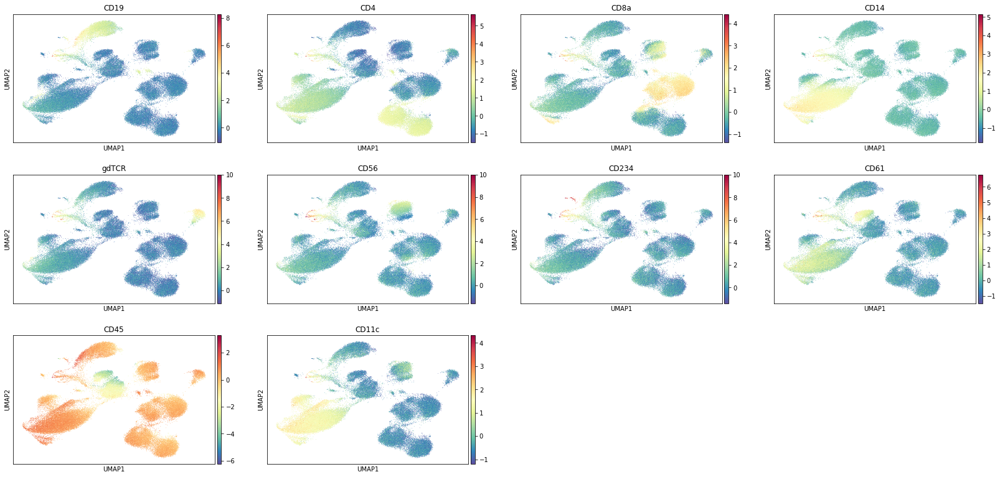

In [160]:
sc.pl.umap(per_batch_norm_adata, color=['CD19','CD4','CD8a','CD14','gdTCR','CD56','CD234','CD61','CD45','CD11c'], color_map=mpl.cm.Spectral_r)

In [150]:
new_cluster_names = ['CD14+','CD14-CD4+','CD8a+','CD45-','CD19+', 'CD56+', 'NcM', 'gd T cells','DBL','DBL-2']
per_batch_norm_adata.rename_categories('leiden', new_cluster_names)

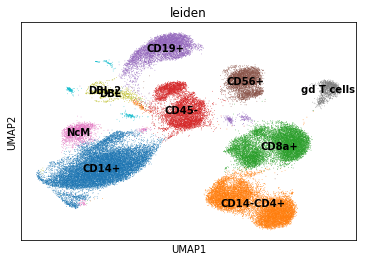

In [159]:
sc.pl.umap(per_batch_norm_adata, color = 'leiden', legend_loc = 'on data')

In [151]:
Monocytes = (per_batch_norm_adata[per_batch_norm_adata.obs['leiden']=='CD14+'].shape[0] + per_batch_norm_adata[per_batch_norm_adata.obs['leiden']=='NcM'].shape[0]) / per_batch_norm_adata.shape[0]
CD4 = per_batch_norm_adata[per_batch_norm_adata.obs['leiden']=='CD14-CD4+'].shape[0] / per_batch_norm_adata.shape[0]
CD8a = per_batch_norm_adata[per_batch_norm_adata.obs['leiden']=='CD8a+'].shape[0] / per_batch_norm_adata.shape[0]
CD19 = per_batch_norm_adata[per_batch_norm_adata.obs['leiden']=='CD19+'].shape[0] / per_batch_norm_adata.shape[0]
CD56 = per_batch_norm_adata[per_batch_norm_adata.obs['leiden']=='CD56+'].shape[0] / per_batch_norm_adata.shape[0]
gdT = per_batch_norm_adata[per_batch_norm_adata.obs['leiden']=='gd T cells'].shape[0]/ per_batch_norm_adata.shape[0]

In [152]:
BH_seq_proportions = [Monocytes,CD4,CD8a,CD19,CD56]

In [153]:
BH_seq_proportions

[0.31327416042922435,
 0.19662846923229782,
 0.17433927270318605,
 0.10051665893886202,
 0.06762933033052924]

In [154]:
seq_proportions

[0.35224815450003727,
 0.21795540973827454,
 0.20030199090299008,
 0.1071322049064201,
 0.06846991275818358]

In [155]:
cytof_proportions

[0.235, 0.245, 0.165, 0.127, 0.0915]

In [156]:
stats.pearsonr(cytof_proportions, BH_seq_proportions)

(0.8731411231282253, 0.05319533264246322)

In [158]:
stats.pearsonr(cytof_proportions, seq_proportions)

(0.8705452143642779, 0.05481416931435555)

In [157]:
stats.pearsonr(BH_seq_proportions,seq_proportions)

(0.9994357200214669, 1.6089370633561322e-05)

In [398]:
warnings.filterwarnings('ignore')
sc.pp.neighbors(adt_resolved_adata,n_neighbors=10) # numba warning outlined here is not to be of concern: https://github.com/lmcinnes/umap/issues/252
warnings.filterwarnings('default')

computing neighbors
    computing neighbors
    using data matrix X directly
    computed neighbors (0:00:15)
    computed connectivities (0:00:02)
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:17)


In [399]:
# resolution to 0.2 for small number of clusters 
sc.tl.leiden(adt_resolved_adata,resolution=0.7)

running Leiden clustering
    finished: found 25 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:45)


In [400]:
sc.tl.umap(adt_resolved_adata,min_dist=2,gamma=50)

computing UMAP


/home/bhwang1/anaconda3/lib/python3.7/site-packages/umap/umap_.py:1052: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:13)


In [418]:
ptn_names =pd.DataFrame(['CD45','CD234','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'])

ptn_names.columns=['Antibody']
ptn_names = ptn_names.set_index('Antibody')

adt_resolved_adata.var = ptn_names

# 200K

In [601]:
meta_2_df = pd.read_table('/wynton/group/ye/david/Cyto-seq/200204/200K_meta_ab_cell_matrix-2.txt',sep=',')
adt_2_df = pd.read_table('/wynton/group/ye/david/Cyto-seq/200204/200K_selected_ab_cell_matrix-2.txt',sep=',')           

In [602]:
adt_from_R_adata_2 = sc.AnnData(adt_2_df.T)
adt_from_R_adata_2.obs = meta_2_df
adt_from_R_adata_2.obs

sc.pp.normalize_per_cell(adt_from_R_adata_2, counts_per_cell_after=1e4)

Transforming to str index.


In [603]:
batch1 = adt_from_R_adata_2[adt_from_R_adata_2.obs['Batch']=='Batch1']
batch2 = adt_from_R_adata_2[adt_from_R_adata_2.obs['Batch']=='Batch2']
batch3 = adt_from_R_adata_2[adt_from_R_adata_2.obs['Batch']=='Batch3']
batch4 = adt_from_R_adata_2[adt_from_R_adata_2.obs['Batch']=='Batch4']
batch5 = adt_from_R_adata_2[adt_from_R_adata_2.obs['Batch']=='Batch5']
batch6 = adt_from_R_adata_2[adt_from_R_adata_2.obs['Batch']=='Batch6']
batch7 = adt_from_R_adata_2[adt_from_R_adata_2.obs['Batch']=='Batch7']
batch8 = adt_from_R_adata_2[adt_from_R_adata_2.obs['Batch']=='Batch8']
batch9 = adt_from_R_adata_2[adt_from_R_adata_2.obs['Batch']=='Batch9']
batch10 = adt_from_R_adata_2[adt_from_R_adata_2.obs['Batch']=='Batch10']

sc.pp.log1p(batch1)
sc.pp.log1p(batch2)
sc.pp.log1p(batch3)
sc.pp.log1p(batch4)
sc.pp.log1p(batch5)
sc.pp.log1p(batch6)
sc.pp.log1p(batch7)
sc.pp.log1p(batch8)
sc.pp.log1p(batch9)
sc.pp.log1p(batch10)

sc.pp.scale(batch1, max_value=10)
sc.pp.scale(batch2, max_value=10)
sc.pp.scale(batch3, max_value=10)
sc.pp.scale(batch4, max_value=10)
sc.pp.scale(batch5, max_value=10)
sc.pp.scale(batch6, max_value=10)
sc.pp.scale(batch7, max_value=10)
sc.pp.scale(batch8, max_value=10)
sc.pp.scale(batch9, max_value=10)
sc.pp.scale(batch10, max_value=10)

per_batch_norm_from_R_adata_2 = batch1.concatenate(batch2,batch3,batch4,batch5,batch6,batch7,batch8,batch9,batch10)

/wynton/home/ye/davidslee/anaconda3/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:298: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(data)


In [604]:
per_batch_norm_from_R_adata_2.var_names_make_unique()

In [609]:
ptn_names =pd.DataFrame(['CD45','CD235','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'])

ptn_names.columns=['Antibody']
ptn_names = ptn_names.set_index('Antibody')

per_batch_norm_from_R_adata_2.var = ptn_names

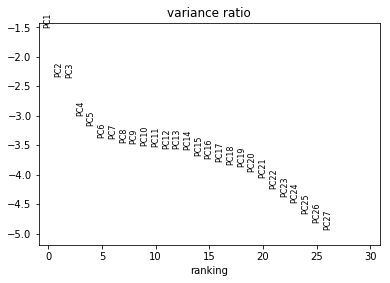

In [605]:
sc.tl.pca(per_batch_norm_from_R_adata_2, svd_solver='arpack', use_highly_variable=None)
sc.pl.pca_variance_ratio(per_batch_norm_from_R_adata_2, log=True)

In [611]:
seed = 10
np.random.seed(seed)

In [612]:
sc.pp.neighbors(per_batch_norm_from_R_adata_2, n_neighbors=10, n_pcs=15)

/wynton/home/ye/davidslee/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../home/ye/davidslee/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


In [613]:
sc.tl.leiden(per_batch_norm_from_R_adata_2,resolution=0.65)

In [614]:
sc.tl.umap(per_batch_norm_from_R_adata_2)

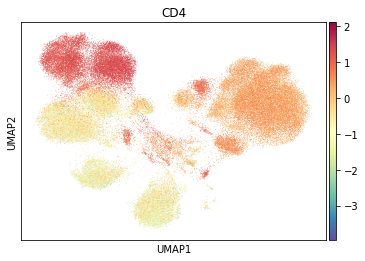

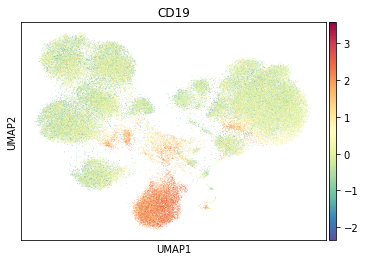

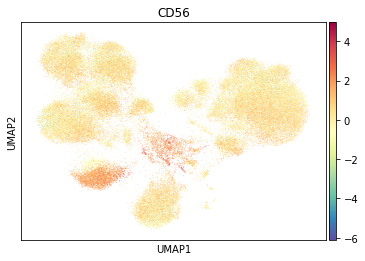

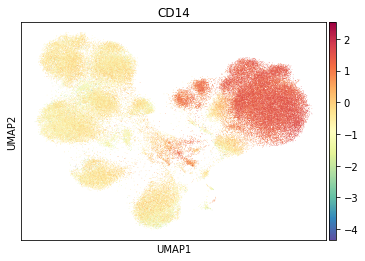

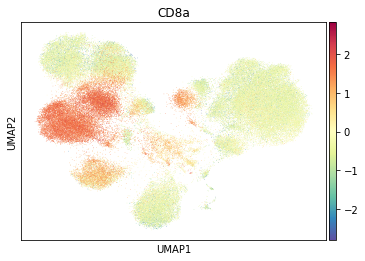

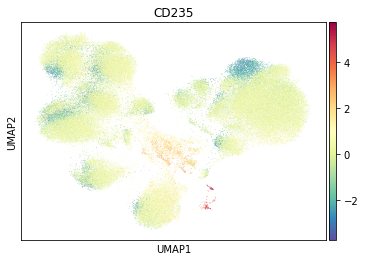

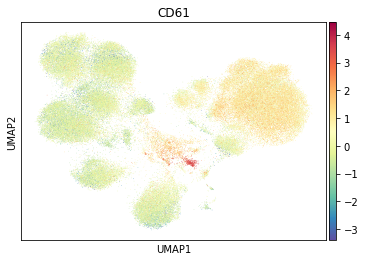

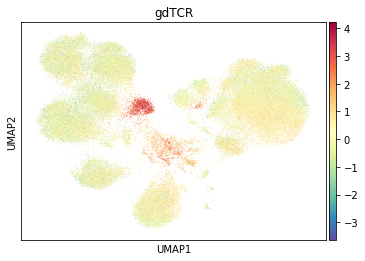

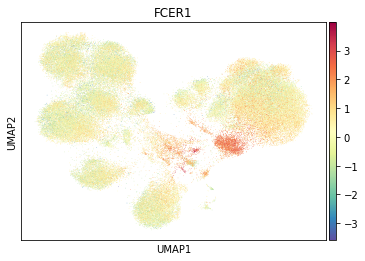

In [485]:
sc.pl.umap(per_batch_norm_from_R_adata_2, color=['CD4'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd4_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata_2, color=['CD19'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd19_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata_2, color=['CD56'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd56_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata_2, color=['CD14'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd14_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata_2, color=['CD8a'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd8a_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata_2, color=['CD235'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd235_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata_2, color=['CD61'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd61_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata_2, color=['gdTCR'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd61_resolved.png")
sc.pl.umap(per_batch_norm_from_R_adata_2, color=['FCER1'], color_map=mpl.cm.Spectral_r, save="200204_100k_cd61_resolved.png")

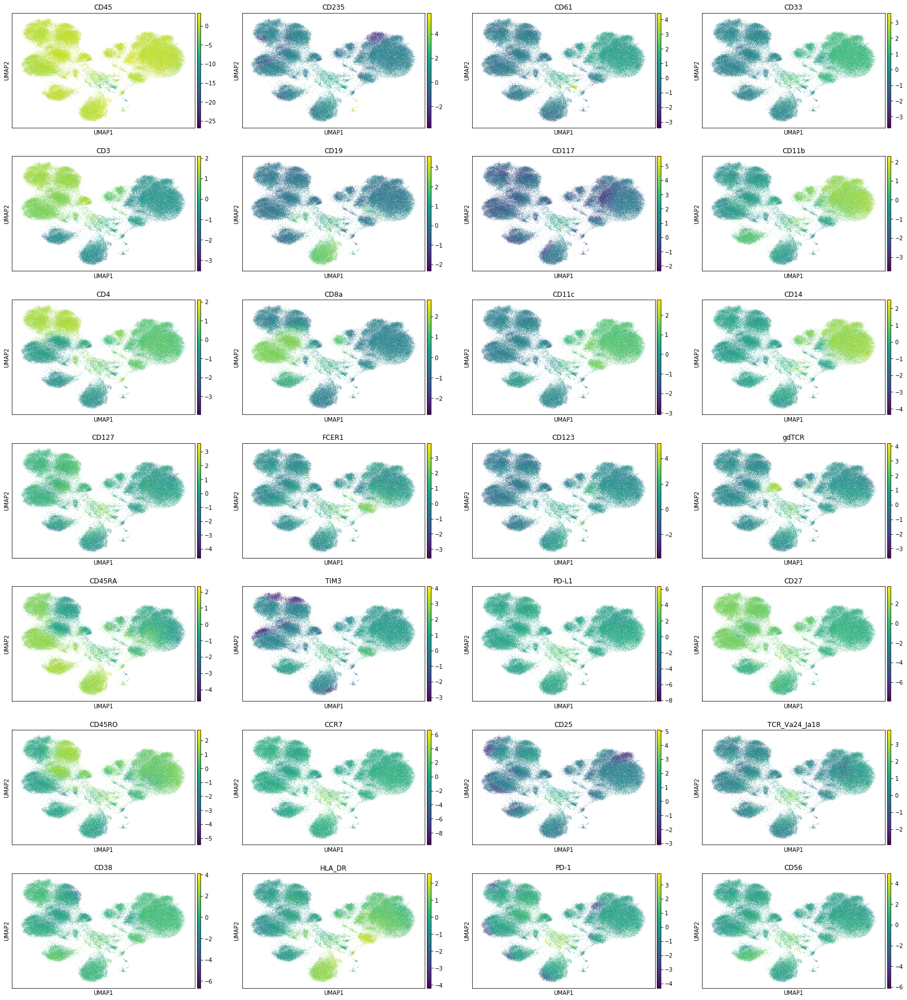

In [506]:
sc.pl.umap(per_batch_norm_from_R_adata_2, color = ['CD45','CD235','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'])


... storing 'Batch' as categorical
... storing 'Demuxlet' as categorical
... storing 'Type' as categorical
... storing 'orig.ident' as categorical


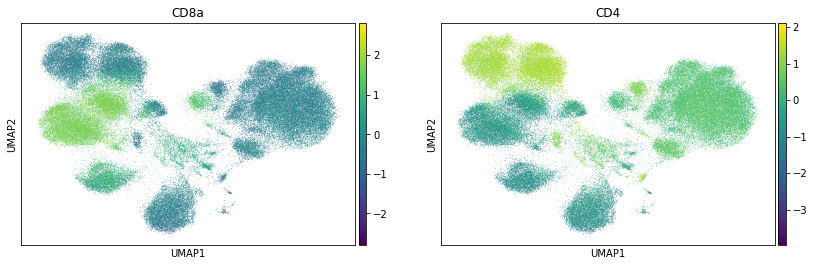

In [610]:
sc.pl.umap(per_batch_norm_from_R_adata_2, color = ['CD8a','CD4'])

In [559]:
per_batch_norm_from_R_adata_2.obs

,Batch,Type,batch,nCount_ADT,nCount_RNA,nFeature_ADT,nFeature_RNA,n_counts,orig.ident,leiden
X2-0,Batch1,Doublet,0,984,984,24,24,984.0,SeuratProject,CD4 Naive T cells
X5-0,Batch1,Singlet,0,872,872,28,28,872.0,SeuratProject,NK cells
X11-0,Batch1,Singlet,0,1083,1083,24,24,1083.0,SeuratProject,NK cells
X13-0,Batch1,Doublet,0,1460,1460,25,25,1460.0,SeuratProject,CD4 Naive T cells
X16-0,Batch1,Doublet,0,1039,1039,23,23,1039.0,SeuratProject,B cells
...,...,...,...,...,...,...,...,...,...,...
X47542.2-9,Batch10,Doublet,9,536,536,16,16,536.0,SeuratProject,CD8 Naive T cells
X47565-9,Batch10,Singlet,9,3242,3242,28,28,3242.0,SeuratProject,Doublets
X47566-9,Batch10,Singlet,9,863,863,17,17,863.0,SeuratProject,NK cells
X47568.2-9,Batch10,Doublet,9,423,423,20,20,423.0,SeuratProject,Conventional Dendritic Cells


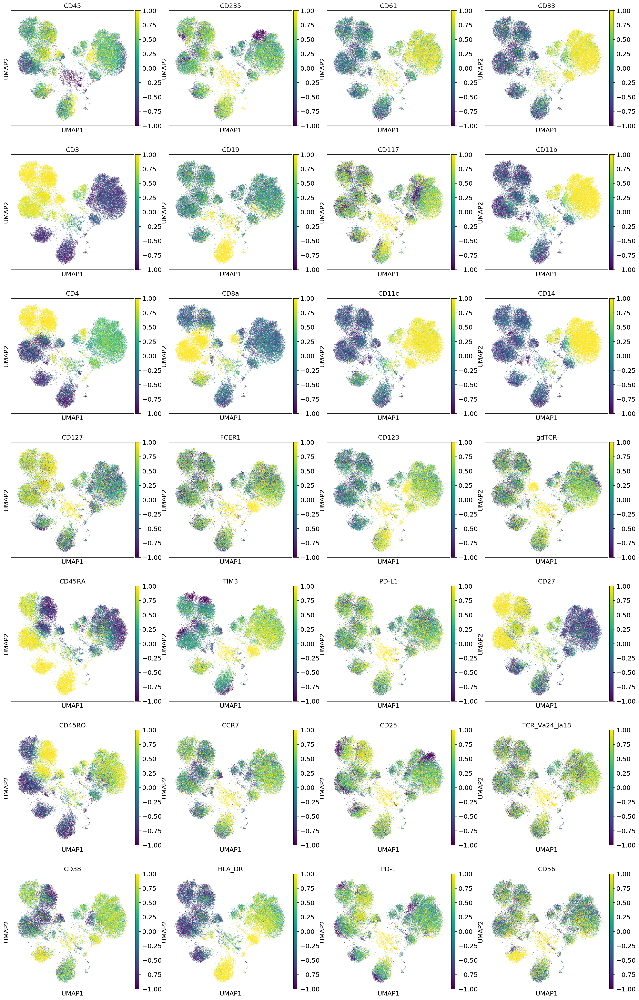

In [1102]:
sc.pl.umap(per_batch_norm_from_R_adata_2, color = ['CD45','CD235','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'],vmin=-1,vmax=1)

In [904]:
sc.tl.embedding_density(per_batch_norm_from_R_adata_2, basis='umap')

Trying to set attribute `.obs` of view, copying.


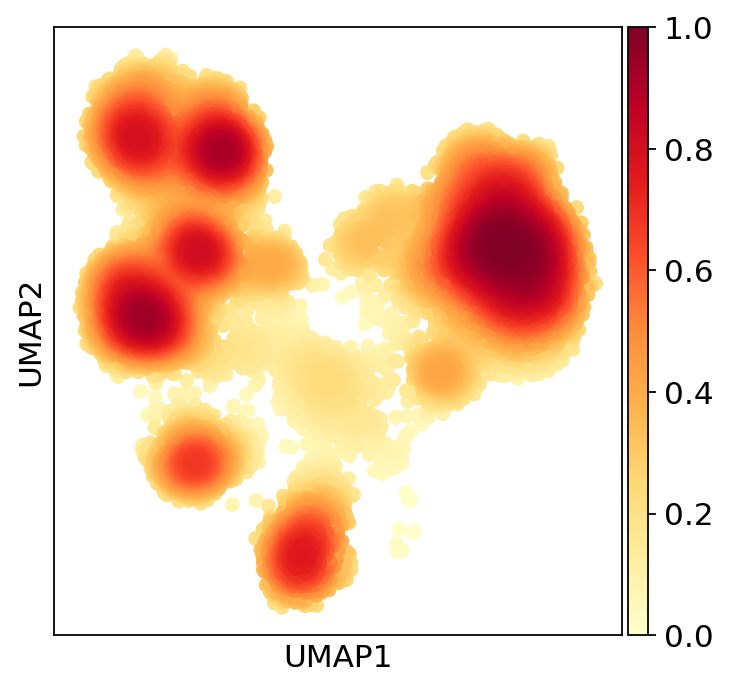

In [909]:
sc.pl.embedding_density(per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['Demuxlet']== 'donor0'],basis = 'umap')

Trying to set attribute `.obs` of view, copying.


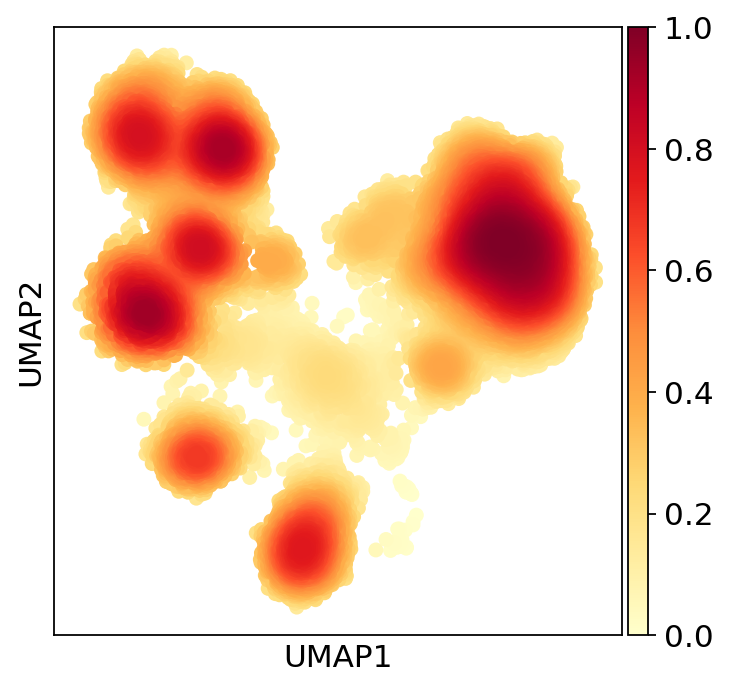

In [910]:
sc.pl.embedding_density(per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['Demuxlet']== 'donor1'],basis = 'umap')

Trying to set attribute `.obs` of view, copying.


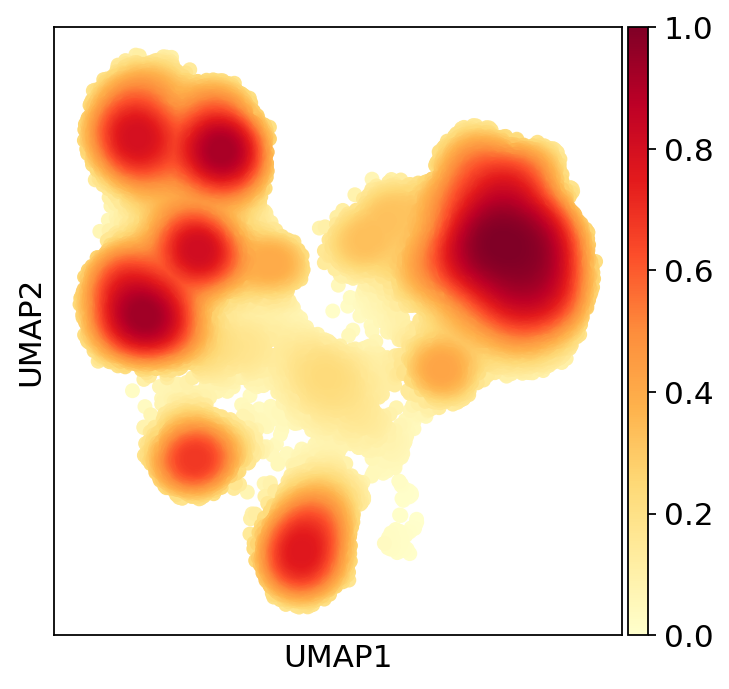

In [908]:
sc.pl.embedding_density(per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['Demuxlet']== 'donor0,donor1'],basis = 'umap')

In [846]:
sc.tl.leiden(per_batch_norm_from_R_adata_2, resolution = .65)

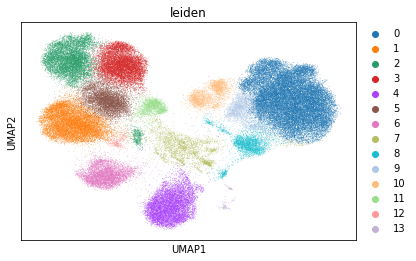

In [847]:
sc.pl.umap(per_batch_norm_from_R_adata_2, color = 'leiden')

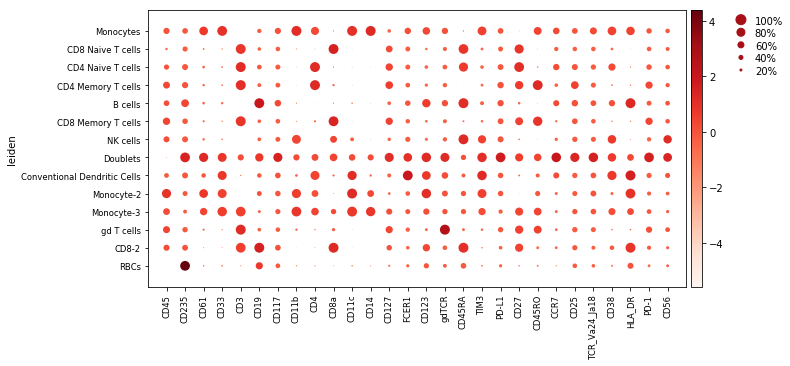

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[9.799999999999999, 0, 0.2, 0.5, 0.25])

In [554]:
sc.pl.dotplot(per_batch_norm_from_R_adata_2, groupby = 'leiden', var_names = ['CD45','CD235','CD61','CD33','CD3','CD19','CD117','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123','gdTCR', 'CD45RA','TIM3','PD-L1','CD27','CD45RO','CCR7','CD25','TCR_Va24_Ja18','CD38', 'HLA_DR','PD-1','CD56'])

In [881]:
new_cluster_names = ['Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells','Monocyte-2','Monocyte-3',
                     'gd T cells','CD8-2','RBCs']
per_batch_norm_from_R_adata_2.rename_categories('leiden', new_cluster_names)

In [560]:
Monocytes = (per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='Monocytes'].shape[0]+per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-2'].shape[0] ) / per_batch_norm_from_R_adata_2.shape[0]
CD8_naive = (per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Naive T cells'].shape[0]+per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='CD8-2'].shape[0]) / per_batch_norm_from_R_adata_2.shape[0]
CD4_naive = per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Naive T cells'].shape[0] / per_batch_norm_from_R_adata_2.shape[0]
CD4_mem = per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Memory T cells'].shape[0] / per_batch_norm_from_R_adata_2.shape[0]
B = per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='B cells'].shape[0] / per_batch_norm_from_R_adata_2.shape[0]
CD8_mem = per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Memory T cells'].shape[0] / per_batch_norm_from_R_adata_2.shape[0]
NK = per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='NK cells'].shape[0] / per_batch_norm_from_R_adata_2.shape[0]
doublets = (per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='Doublets'].shape[0]+per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-3'].shape[0]) / per_batch_norm_from_R_adata_2.shape[0]
cDC = per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='Conventional Dendritic Cells'].shape[0] / per_batch_norm_from_R_adata_2.shape[0]
gd = per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='gd T cells'].shape[0] / per_batch_norm_from_R_adata_2.shape[0]
rbc = per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['leiden']=='RBCs'].shape[0] / per_batch_norm_from_R_adata_2.shape[0]


In [562]:
pbmc_200k_proportions = [Monocytes, CD8_naive, CD4_naive, CD4_mem, B, CD8_mem, NK, doublets, cDC, gd, rbc]

In [563]:
pbmc_200k_proportions

[0.32721244022280344,
 0.12827611866799443,
 0.101333975334041,
 0.09902496142524157,
 0.09292960243376631,
 0.06953305391711626,
 0.057736290913866124,
 0.06651273240608004,
 0.0340661625502019,
 0.021525262363073287,
 0.001849399765815651]

In [893]:
per_batch_norm_from_R_adata_2.obs

,Batch,DBC,Demuxlet,Type,batch,nCount_ADT,nCount_RNA,nFeature_ADT,nFeature_RNA,n_counts,orig.ident,leiden
X3-0,Batch1,3,"donor0,donor1",Doublet,0,984,984,24,24,984.0,SeuratProject,CD4 Naive T cells
X6-0,Batch1,6,donor1,Singlet,0,872,872,28,28,872.0,SeuratProject,NK cells
X12-0,Batch1,12,donor0,Singlet,0,1083,1083,24,24,1083.0,SeuratProject,NK cells
X14-0,Batch1,14,donor1,Doublet,0,1460,1460,25,25,1460.0,SeuratProject,CD4 Naive T cells
X17-0,Batch1,17,"donor0,donor1",Doublet,0,1039,1039,23,23,1039.0,SeuratProject,B cells
...,...,...,...,...,...,...,...,...,...,...,...,...
X47543.2-9,Batch10,47543,donor0,Doublet,9,536,536,16,16,536.0,SeuratProject,CD8 Naive T cells
X47566-9,Batch10,47566,donor1,Singlet,9,3242,3242,28,28,3242.0,SeuratProject,Doublets
X47567-9,Batch10,47567,donor1,Singlet,9,863,863,17,17,863.0,SeuratProject,NK cells
X47569.2-9,Batch10,47569,donor1,Doublet,9,423,423,20,20,423.0,SeuratProject,Conventional Dendritic Cells


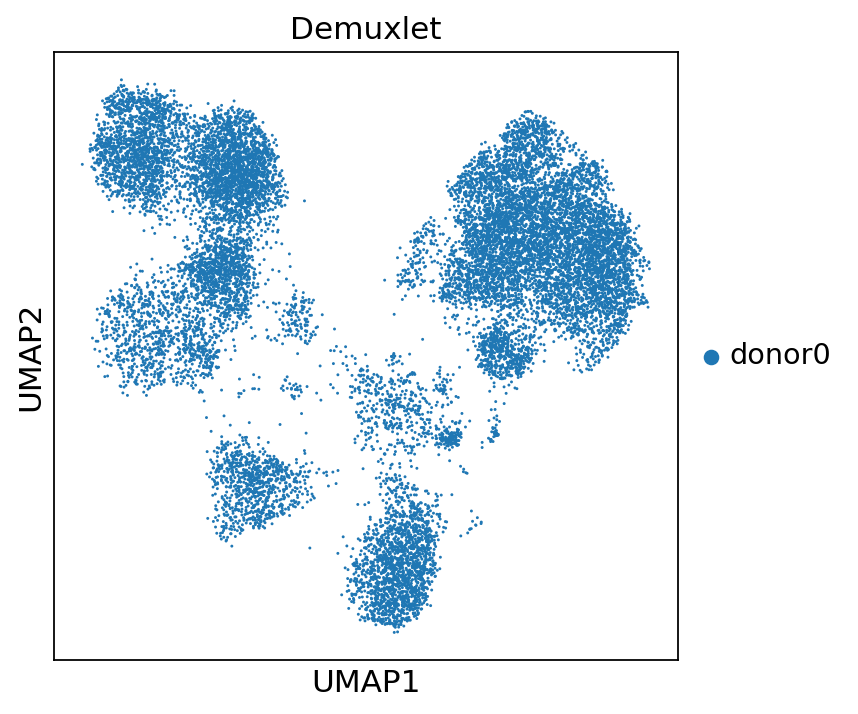

In [902]:
sc.pl.umap(per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['Demuxlet']== 'donor0'], color = 'Demuxlet')

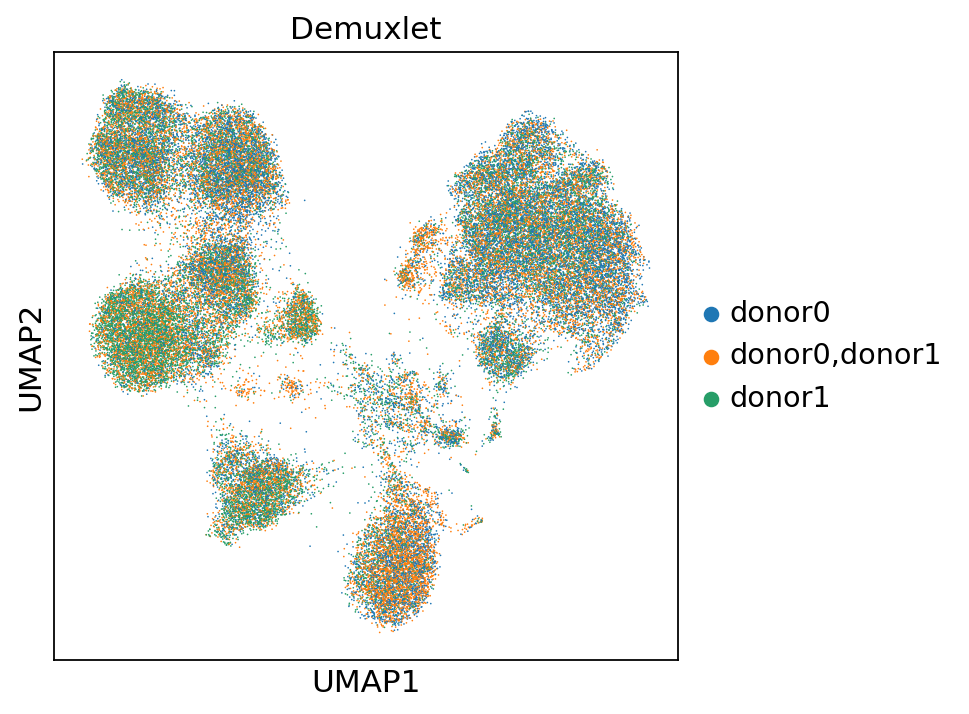

In [901]:
sc.pl.umap(per_batch_norm_from_R_adata,color = 'Demuxlet')

Trying to set attribute `.uns` of view, copying.


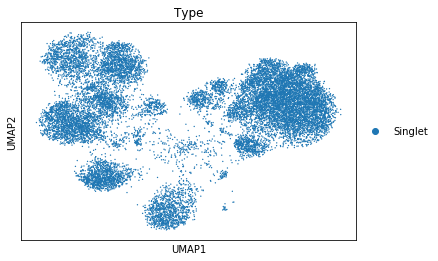

Trying to set attribute `.uns` of view, copying.


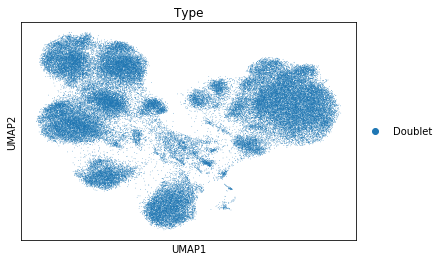

In [529]:
sc.pl.umap(per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['Type']== 'Singlet'], color = 'Type')
sc.pl.umap(per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['Type']== 'Doublet'], color = 'Type')

In [684]:
singlet_200k = per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['Type']== 'Singlet']
multiplet_200k = per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['Type']== 'Doublet']

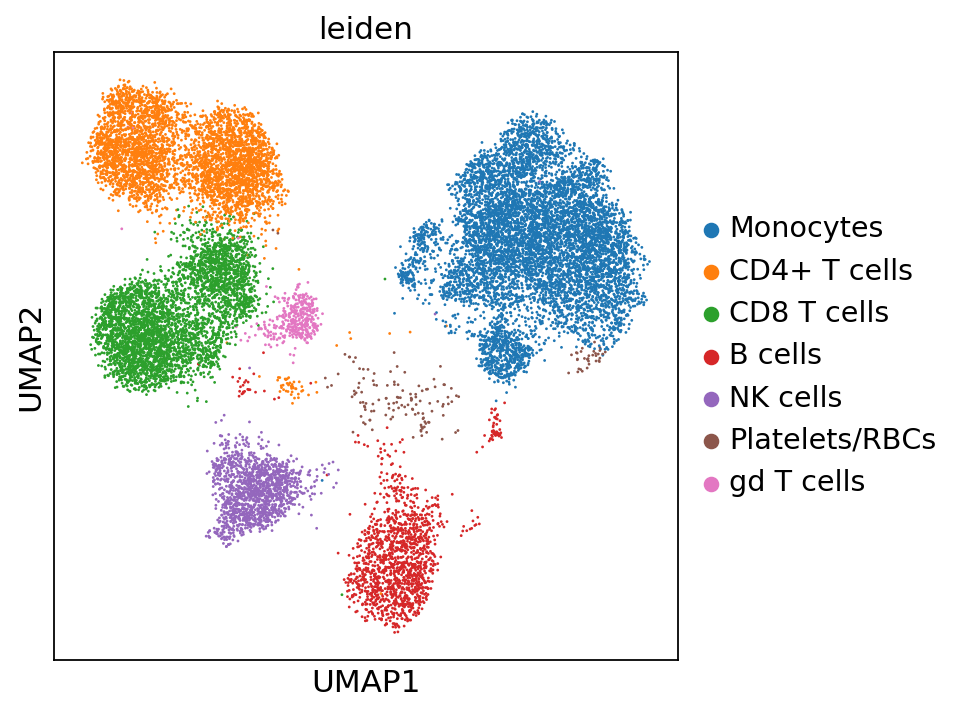

In [887]:
sc.pl.umap(singlet_norm, color ='leiden')

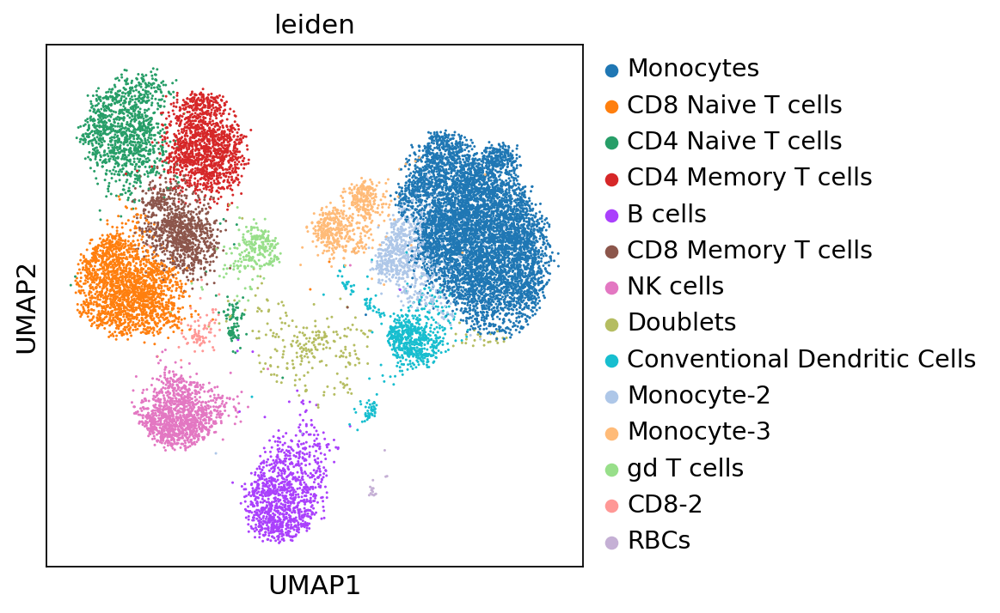

In [884]:
sc.pl.umap(singlet_200k, color = 'leiden' ,save='singlet_200k_1000_dpi.png')

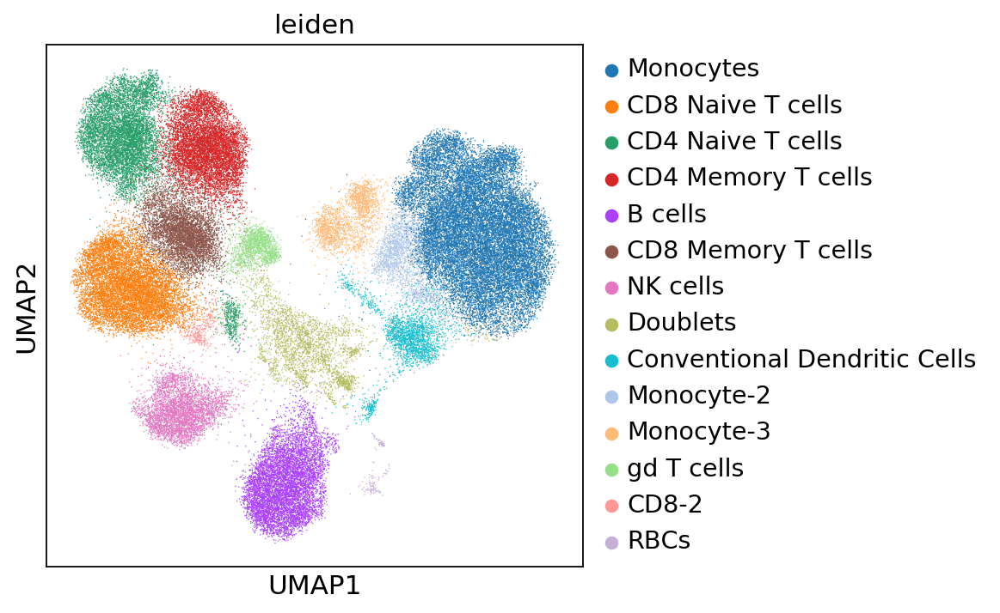

In [885]:
sc.pl.umap(multiplet_200k, color = 'leiden' ,save='multiplet_200k_1000_dpi.png')

In [833]:
import matplotlib.pyplot as plt
plt.figure(figsize=(5,10))

<Figure size 360x720 with 0 Axes>

<Figure size 360x720 with 0 Axes>

In [617]:
np.sum(pbmc_200k_proportions)

1.0

In [ ]:
pbmc_200k_proportions = [Monocytes, CD8_naive, CD4_naive, CD4_mem, B, CD8_mem, NK, doublets, cDC, gd, rbc]

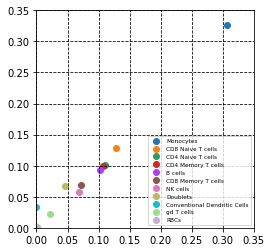

In [666]:
fig, ax = plt.subplots()
x = pbmc_100k_proportions
y = pbmc_200k_proportions

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(pbmc_100k_proportions[0], pbmc_200k_proportions[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(pbmc_100k_proportions[1], pbmc_200k_proportions[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(pbmc_100k_proportions[2], pbmc_200k_proportions[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(pbmc_100k_proportions[3], pbmc_200k_proportions[3], marker='o', color=colors[3])
B  = plt.scatter(pbmc_100k_proportions[4], pbmc_200k_proportions[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(pbmc_100k_proportions[5], pbmc_200k_proportions[5], marker='o', color=colors[5])
NK = plt.scatter(pbmc_100k_proportions[6], pbmc_200k_proportions[6], marker='o', color=colors[6])
doublets = plt.scatter(pbmc_100k_proportions[7], pbmc_200k_proportions[7], marker='o', color=colors[7])
cDC = plt.scatter(pbmc_100k_proportions[8], pbmc_200k_proportions[8], marker='o', color=colors[8])
gd  = plt.scatter(pbmc_100k_proportions[9], pbmc_200k_proportions[9], marker='o', color=colors[11])
rbc  = plt.scatter(pbmc_100k_proportions[10], pbmc_200k_proportions[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'lower right', fontsize = 'xx-small')
  


ax.set_xlim((0,.35))
ax.set_ylim((0,.35))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('100k_200k_correlation.png', dpi=600)



In [570]:
stats.pearsonr(pbmc_100k_proportions,pbmc_200k_proportions)

(0.9998688940454519, 1.9798572006784124e-17)

In [ ]:
#100k and 200k donor specific singlets

In [759]:
m_sng = (per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocytes') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0])/(per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0])
cd8n_sng = (per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0])/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd4n_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd4m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
b_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='B cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd8m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
nk_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='NK cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
dbl_sng = (per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Doublets') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-3') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0])/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cdc_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Conventional Dendritic Cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
gdt_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='gd T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
rbc_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='RBCs') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]

singlets_200_donor0 = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(singlets_200_donor0)

1.0

In [760]:
m_sng = (per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocytes') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0])/(per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0])
cd8n_sng = (per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0])/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd4n_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd4m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
b_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='B cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd8m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
nk_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='NK cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
dbl_sng = (per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Doublets') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-3') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0])/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cdc_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Conventional Dendritic Cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
gdt_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='gd T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
rbc_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='RBCs') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]

singlets_200_donor1 = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(singlets_200_donor1)

1.0

In [761]:
m_sng = (per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Monocytes') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]+per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0])/(per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0])
cd8n_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD8 Naive T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
cd4n_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD4 Naive T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
cd4m_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD4 Memory T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
b_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='B cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
cd8m_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD8 Memory T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
nk_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='NK cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
dbl_sng = (per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Doublets') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]+per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Monocyte-3') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0])/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
cdc_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Conventional Dendritic Cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
gdt_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='gd T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
rbc_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='RBCs') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]

singlets_100_donor0 = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(singlets_100_donor0)

1.0

In [762]:
m_sng = (per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Monocytes') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]+per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0])/(per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0])
cd8n_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD8 Naive T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
cd4n_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD4 Naive T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
cd4m_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD4 Memory T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
b_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='B cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
cd8m_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD8 Memory T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
nk_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='NK cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
dbl_sng = (per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Doublets') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]+per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Monocyte-3') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0])/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
cdc_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Conventional Dendritic Cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
gdt_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='gd T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]
rbc_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='RBCs') & (per_batch_norm_from_R_adata.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Singlet')].shape[0]

singlets_100_donor1 = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(singlets_100_donor1)

0.9999999999999999

In [ ]:
#100k and 200k donor specific multiplets

In [763]:
m_sng = (per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocytes') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0])/(per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0])
cd8n_sng = (per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0])/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd4n_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd4m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
b_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='B cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd8m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
nk_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='NK cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
dbl_sng = (per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Doublets') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-3') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0])/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cdc_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Conventional Dendritic Cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
gdt_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='gd T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
rbc_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='RBCs') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]

multiplet_200_donor0 = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(multiplet_200_donor0)

1.0

In [764]:
m_sng = (per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocytes') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0])/(per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0])
cd8n_sng = (per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0])/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd4n_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd4m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
b_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='B cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd8m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
nk_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='NK cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
dbl_sng = (per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Doublets') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-3') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0])/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cdc_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Conventional Dendritic Cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
gdt_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='gd T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
rbc_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='RBCs') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]

multiplet_200_donor1 = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(multiplet_200_donor1)

1.0

In [765]:
m_sng = (per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Monocytes') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]+per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0])/(per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0])
cd8n_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD8 Naive T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
cd4n_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD4 Naive T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
cd4m_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD4 Memory T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
b_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='B cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
cd8m_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD8 Memory T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
nk_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='NK cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
dbl_sng = (per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Doublets') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]+per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Monocyte-3') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0])/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
cdc_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Conventional Dendritic Cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
gdt_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='gd T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
rbc_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='RBCs') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]

multiplet_100_donor0 = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(multiplet_100_donor0)

0.9999999999999999

In [766]:
m_sng = (per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Monocytes') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]+per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0])/(per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0])
cd8n_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD8 Naive T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
cd4n_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD4 Naive T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
cd4m_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD4 Memory T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
b_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='B cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
cd8m_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='CD8 Memory T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
nk_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='NK cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
dbl_sng = (per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Doublets') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]+per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Monocyte-3') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0])/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
cdc_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Conventional Dendritic Cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
gdt_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='gd T cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]
rbc_sng = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='RBCs') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]

multiplet_100_donor1 = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(multiplet_100_donor1)

1.0

In [748]:
per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['leiden']=='Conventional dendritic Cells') & (per_batch_norm_from_R_adata.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet')].shape[0]


0.0

In [747]:
multiplet_100_donor1

[0.22854188210961737,
 0.1860134436401241,
 0.12086349534643226,
 0.08544467425025853,
 0.06747673216132369,
 0.07743019648397105,
 0.08790072388831438,
 0.07406928645294726,
 0.0,
 0.03580661840744571,
 0.0007755946225439503]

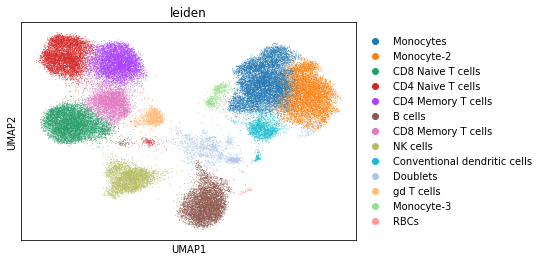

In [746]:
sc.pl.umap(per_batch_norm_from_R_adata,color ='leiden')

In [ ]:
#100k v 200k

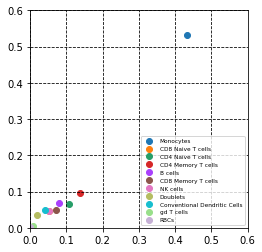

In [771]:
#singlets 100k donor 0, singlets 200k donor 1
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(singlets_100_donor0[0], singlets_200_donor1[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(singlets_100_donor0[1], singlets_200_donor1[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(singlets_100_donor0[2], singlets_200_donor1[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(singlets_100_donor0[3], singlets_200_donor1[3], marker='o', color=colors[3])
B  = plt.scatter(singlets_100_donor0[4], singlets_200_donor1[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(singlets_100_donor0[5], singlets_200_donor1[5], marker='o', color=colors[5])
NK = plt.scatter(singlets_100_donor0[6], singlets_200_donor1[6], marker='o', color=colors[6])
doublets = plt.scatter(singlets_100_donor0[7], singlets_200_donor1[7], marker='o', color=colors[7])
cDC = plt.scatter(singlets_100_donor0[8], singlets_200_donor1[8], marker='o', color=colors[8])
gd  = plt.scatter(singlets_100_donor0[9], singlets_200_donor1[9], marker='o', color=colors[11])
rbc  = plt.scatter(singlets_100_donor0[10], singlets_200_donor1[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'lower right', fontsize = 'xx-small')
  


ax.set_xlim((0,.6))
ax.set_ylim((0,.6))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('100k_d0_200k_donor1_correlation.png', dpi=600)



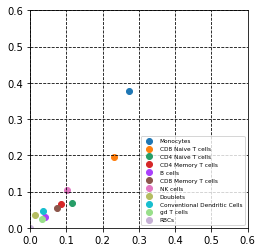

In [772]:
#singlets 100k donor 1, singlets 200k donor 0
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(singlets_100_donor1[0], singlets_200_donor0[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(singlets_100_donor1[1], singlets_200_donor0[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(singlets_100_donor1[2], singlets_200_donor0[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(singlets_100_donor1[3], singlets_200_donor0[3], marker='o', color=colors[3])
B  = plt.scatter(singlets_100_donor1[4], singlets_200_donor0[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(singlets_100_donor1[5], singlets_200_donor0[5], marker='o', color=colors[5])
NK = plt.scatter(singlets_100_donor1[6], singlets_200_donor0[6], marker='o', color=colors[6])
doublets = plt.scatter(singlets_100_donor1[7], singlets_200_donor0[7], marker='o', color=colors[7])
cDC = plt.scatter(singlets_100_donor1[8], singlets_200_donor0[8], marker='o', color=colors[8])
gd  = plt.scatter(singlets_100_donor1[9], singlets_200_donor0[9], marker='o', color=colors[11])
rbc  = plt.scatter(singlets_100_donor1[10], singlets_200_donor0[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'lower right', fontsize = 'xx-small')
  


ax.set_xlim((0,.6))
ax.set_ylim((0,.6))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('100k_d1_200k_donor0_correlation.png', dpi=600)



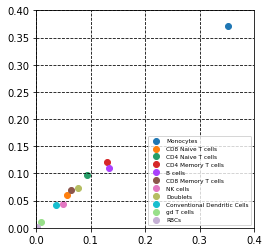

In [773]:
#multiplets 100k donor 0, multiplets 200k donor 1
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(multiplet_100_donor0[0], multiplet_200_donor1[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(multiplet_100_donor0[1], multiplet_200_donor1[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(multiplet_100_donor0[2], multiplet_200_donor1[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(multiplet_100_donor0[3], multiplet_200_donor1[3], marker='o', color=colors[3])
B  = plt.scatter(multiplet_100_donor0[4], multiplet_200_donor1[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(multiplet_100_donor0[5], multiplet_200_donor1[5], marker='o', color=colors[5])
NK = plt.scatter(multiplet_100_donor0[6], multiplet_200_donor1[6], marker='o', color=colors[6])
doublets = plt.scatter(multiplet_100_donor0[7], multiplet_200_donor1[7], marker='o', color=colors[7])
cDC = plt.scatter(multiplet_100_donor0[8], multiplet_200_donor1[8], marker='o', color=colors[8])
gd  = plt.scatter(multiplet_100_donor0[9], multiplet_200_donor1[9], marker='o', color=colors[11])
rbc  = plt.scatter(multiplet_100_donor0[10], multiplet_200_donor1[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'lower right', fontsize = 'xx-small')
  


ax.set_xlim((0,.4))
ax.set_ylim((0,.4))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('100k_d1_200k_donor0_correlation.png', dpi=600)


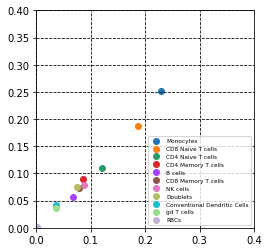

In [774]:
#multiplets 100k donor1, multiplets 200k donor0
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(multiplet_100_donor1[0], multiplet_200_donor0[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(multiplet_100_donor1[1], multiplet_200_donor0[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(multiplet_100_donor1[2], multiplet_200_donor0[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(multiplet_100_donor1[3], multiplet_200_donor0[3], marker='o', color=colors[3])
B  = plt.scatter(multiplet_100_donor1[4], multiplet_200_donor0[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(multiplet_100_donor1[5], multiplet_200_donor0[5], marker='o', color=colors[5])
NK = plt.scatter(multiplet_100_donor1[6], multiplet_200_donor0[6], marker='o', color=colors[6])
doublets = plt.scatter(multiplet_100_donor1[7], multiplet_200_donor0[7], marker='o', color=colors[7])
cDC = plt.scatter(multiplet_100_donor1[8], multiplet_200_donor0[8], marker='o', color=colors[8])
gd  = plt.scatter(multiplet_100_donor1[9], multiplet_200_donor0[9], marker='o', color=colors[11])
rbc  = plt.scatter(multiplet_100_donor1[10], multiplet_200_donor0[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'lower right', fontsize = 'xx-small')
  


ax.set_xlim((0,.4))
ax.set_ylim((0,.4))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('100k_d0_200k_donor1_correlation.png', dpi=600)


In [ ]:
#100k vs 100k
#legend plotting plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
#           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
#                     'NK cells','Doublets','Conventional Dendritic Cells',
#                     'gd T cells','RBCs'),loc = 'lower right', fontsize = 'xx-small')

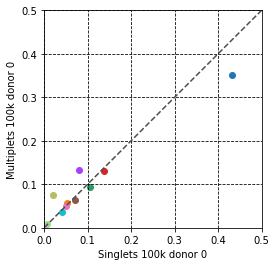

In [817]:
#singlet 100k donor0, multiplet 100k donor0
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(singlets_100_donor0[0], multiplet_100_donor0[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(singlets_100_donor0[1], multiplet_100_donor0[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(singlets_100_donor0[2], multiplet_100_donor0[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(singlets_100_donor0[3], multiplet_100_donor0[3], marker='o', color=colors[3])
B  = plt.scatter(singlets_100_donor0[4], multiplet_100_donor0[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(singlets_100_donor0[5], multiplet_100_donor0[5], marker='o', color=colors[5])
NK = plt.scatter(singlets_100_donor0[6], multiplet_100_donor0[6], marker='o', color=colors[6])
doublets = plt.scatter(singlets_100_donor0[7], multiplet_100_donor0[7], marker='o', color=colors[7])
cDC = plt.scatter(singlets_100_donor0[8], multiplet_100_donor0[8], marker='o', color=colors[8])
gd  = plt.scatter(singlets_100_donor0[9], multiplet_100_donor0[9], marker='o', color=colors[11])
rbc  = plt.scatter(singlets_100_donor0[10], multiplet_100_donor0[10], marker='o', color=colors[13])


ax.set_xlabel('Singlets 100k donor 0')
ax.set_ylabel('Multiplets 100k donor 0') 

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('100k_d0_s_100k_d0_m_correlation.png', dpi=600)


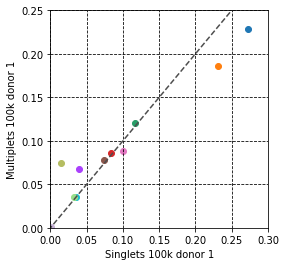

In [818]:
#singlet 100k donor1, multiplet 100k donor1
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(singlets_100_donor1[0], multiplet_100_donor1[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(singlets_100_donor1[1], multiplet_100_donor1[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(singlets_100_donor1[2], multiplet_100_donor1[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(singlets_100_donor1[3], multiplet_100_donor1[3], marker='o', color=colors[3])
B  = plt.scatter(singlets_100_donor1[4], multiplet_100_donor1[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(singlets_100_donor1[5], multiplet_100_donor1[5], marker='o', color=colors[5])
NK = plt.scatter(singlets_100_donor1[6], multiplet_100_donor1[6], marker='o', color=colors[6])
doublets = plt.scatter(singlets_100_donor1[7], multiplet_100_donor1[7], marker='o', color=colors[7])
cDC = plt.scatter(singlets_100_donor1[8], multiplet_100_donor1[8], marker='o', color=colors[8])
gd  = plt.scatter(singlets_100_donor1[9], multiplet_100_donor1[9], marker='o', color=colors[11])
rbc  = plt.scatter(singlets_100_donor1[10], multiplet_100_donor1[10], marker='o', color=colors[13])


ax.set_xlabel('Singlets 100k donor 1')
ax.set_ylabel('Multiplets 100k donor 1')  

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.3))
ax.set_ylim((0,.25))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('100k_d1_s_100k_d1_m_correlation.png', dpi=600)


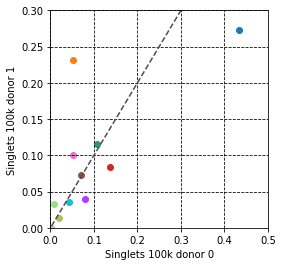

In [819]:
#singlet 100k donor0, singlet 100k donor1
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(singlets_100_donor0[0], singlets_100_donor1[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(singlets_100_donor0[1], singlets_100_donor1[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(singlets_100_donor0[2], singlets_100_donor1[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(singlets_100_donor0[3], singlets_100_donor1[3], marker='o', color=colors[3])
B  = plt.scatter(singlets_100_donor0[4], singlets_100_donor1[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(singlets_100_donor0[5], singlets_100_donor1[5], marker='o', color=colors[5])
NK = plt.scatter(singlets_100_donor0[6], singlets_100_donor1[6], marker='o', color=colors[6])
doublets = plt.scatter(singlets_100_donor0[7], singlets_100_donor1[7], marker='o', color=colors[7])
cDC = plt.scatter(singlets_100_donor0[8], singlets_100_donor1[8], marker='o', color=colors[8])
gd  = plt.scatter(singlets_100_donor0[9], singlets_100_donor1[9], marker='o', color=colors[11])
rbc  = plt.scatter(singlets_100_donor0[10], singlets_100_donor1[10], marker='o', color=colors[13])


ax.set_xlabel('Singlets 100k donor 0')
ax.set_ylabel('Singlets 100k donor 1')  

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.3))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('100k_d0_s_100k_d1_s_correlation.png', dpi=600)


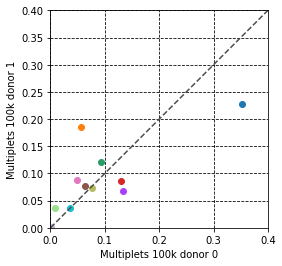

In [820]:
#multiplet 100k donor0, multiplet 100k donor1
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(multiplet_100_donor0[0], multiplet_100_donor1[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(multiplet_100_donor0[1], multiplet_100_donor1[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(multiplet_100_donor0[2], multiplet_100_donor1[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(multiplet_100_donor0[3], multiplet_100_donor1[3], marker='o', color=colors[3])
B  = plt.scatter(multiplet_100_donor0[4], multiplet_100_donor1[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(multiplet_100_donor0[5], multiplet_100_donor1[5], marker='o', color=colors[5])
NK = plt.scatter(multiplet_100_donor0[6], multiplet_100_donor1[6], marker='o', color=colors[6])
doublets = plt.scatter(multiplet_100_donor0[7], multiplet_100_donor1[7], marker='o', color=colors[7])
cDC = plt.scatter(multiplet_100_donor0[8], multiplet_100_donor1[8], marker='o', color=colors[8])
gd  = plt.scatter(multiplet_100_donor0[9], multiplet_100_donor1[9], marker='o', color=colors[11])
rbc  = plt.scatter(multiplet_100_donor0[10], multiplet_100_donor1[10], marker='o', color=colors[13])


ax.set_xlabel('Multiplets 100k donor 0')
ax.set_ylabel('Multiplets 100k donor 1')  

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.4))
ax.set_ylim((0,.4))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('100k_d0_m_100k_d1_m_correlation.png', dpi=600)


In [ ]:
#200k vs 200k

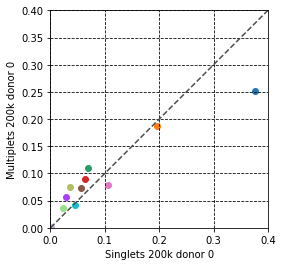

In [821]:
#singlet 200k donor0, multiplet 200k donor0
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(singlets_200_donor0[0], multiplet_200_donor0[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(singlets_200_donor0[1], multiplet_200_donor0[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(singlets_200_donor0[2], multiplet_200_donor0[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(singlets_200_donor0[3], multiplet_200_donor0[3], marker='o', color=colors[3])
B  = plt.scatter(singlets_200_donor0[4], multiplet_200_donor0[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(singlets_200_donor0[5], multiplet_200_donor0[5], marker='o', color=colors[5])
NK = plt.scatter(singlets_200_donor0[6], multiplet_200_donor0[6], marker='o', color=colors[6])
doublets = plt.scatter(singlets_200_donor0[7], multiplet_200_donor0[7], marker='o', color=colors[7])
cDC = plt.scatter(singlets_200_donor0[8], multiplet_200_donor0[8], marker='o', color=colors[8])
gd  = plt.scatter(singlets_200_donor0[9], multiplet_200_donor0[9], marker='o', color=colors[11])
rbc  = plt.scatter(singlets_200_donor0[10], multiplet_200_donor0[10], marker='o', color=colors[13])


  
ax.set_xlabel('Singlets 200k donor 0')
ax.set_ylabel('Multiplets 200k donor 0')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.4))
ax.set_ylim((0,.4))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('200k_d0_s_200k_d0_m_correlation.png', dpi=600)


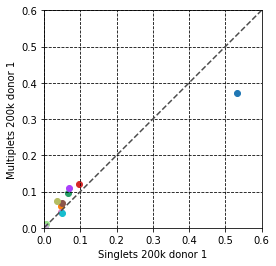

In [822]:
#singlet 200k donor1, multiplet 200k donor1
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(singlets_200_donor1[0], multiplet_200_donor1[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(singlets_200_donor1[1], multiplet_200_donor1[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(singlets_200_donor1[2], multiplet_200_donor1[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(singlets_200_donor1[3], multiplet_200_donor1[3], marker='o', color=colors[3])
B  = plt.scatter(singlets_200_donor1[4], multiplet_200_donor1[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(singlets_200_donor1[5], multiplet_200_donor1[5], marker='o', color=colors[5])
NK = plt.scatter(singlets_200_donor1[6], multiplet_200_donor1[6], marker='o', color=colors[6])
doublets = plt.scatter(singlets_200_donor1[7], multiplet_200_donor1[7], marker='o', color=colors[7])
cDC = plt.scatter(singlets_200_donor1[8], multiplet_200_donor1[8], marker='o', color=colors[8])
gd  = plt.scatter(singlets_200_donor1[9], multiplet_200_donor1[9], marker='o', color=colors[11])
rbc  = plt.scatter(singlets_200_donor1[10], multiplet_200_donor1[10], marker='o', color=colors[13])

  
ax.set_xlabel('Singlets 200k donor 1')
ax.set_ylabel('Multiplets 200k donor 1')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.6))
ax.set_ylim((0,.6))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('200k_d1_s_200k_d1_m_correlation.png', dpi=600)


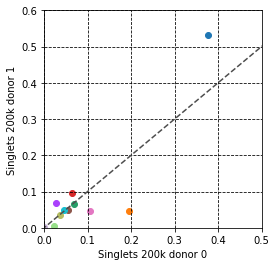

In [823]:
#singlet 200k donor0, singlet 200k donor1
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(singlets_200_donor0[0], singlets_200_donor1[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(singlets_200_donor0[1], singlets_200_donor1[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(singlets_200_donor0[2], singlets_200_donor1[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(singlets_200_donor0[3], singlets_200_donor1[3], marker='o', color=colors[3])
B  = plt.scatter(singlets_200_donor0[4], singlets_200_donor1[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(singlets_200_donor0[5], singlets_200_donor1[5], marker='o', color=colors[5])
NK = plt.scatter(singlets_200_donor0[6], singlets_200_donor1[6], marker='o', color=colors[6])
doublets = plt.scatter(singlets_200_donor0[7], singlets_200_donor1[7], marker='o', color=colors[7])
cDC = plt.scatter(singlets_200_donor0[8], singlets_200_donor1[8], marker='o', color=colors[8])
gd  = plt.scatter(singlets_200_donor0[9], singlets_200_donor1[9], marker='o', color=colors[11])
rbc  = plt.scatter(singlets_200_donor0[10], singlets_200_donor1[10], marker='o', color=colors[13])


ax.set_xlabel('Singlets 200k donor 0')
ax.set_ylabel('Singlets 200k donor 1')  

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.6))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('200k_d0_s_200k_d1_s_correlation.png', dpi=600)


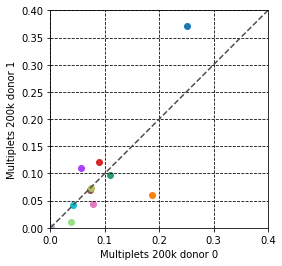

In [824]:
#multiplet 200k donor0, multiplet 200k donor1
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(multiplet_200_donor0[0], multiplet_200_donor1[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(multiplet_200_donor0[1], multiplet_200_donor1[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(multiplet_200_donor0[2], multiplet_200_donor1[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(multiplet_200_donor0[3], multiplet_200_donor1[3], marker='o', color=colors[3])
B  = plt.scatter(multiplet_200_donor0[4], multiplet_200_donor1[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(multiplet_200_donor0[5], multiplet_200_donor1[5], marker='o', color=colors[5])
NK = plt.scatter(multiplet_200_donor0[6], multiplet_200_donor1[6], marker='o', color=colors[6])
doublets = plt.scatter(multiplet_200_donor0[7], multiplet_200_donor1[7], marker='o', color=colors[7])
cDC = plt.scatter(multiplet_200_donor0[8], multiplet_200_donor1[8], marker='o', color=colors[8])
gd  = plt.scatter(multiplet_200_donor0[9], multiplet_200_donor1[9], marker='o', color=colors[11])
rbc  = plt.scatter(multiplet_200_donor0[10], multiplet_200_donor1[10], marker='o', color=colors[13])


ax.set_xlabel('Multiplets 200k donor 0')
ax.set_ylabel('Multiplets 200k donor 1')  

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.4))
ax.set_ylim((0,.4))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('200k_d0_m_200k_d1_m_correlation.png', dpi=600)


In [ ]:
#200k all clusters test

In [851]:
#donor0 singlet
m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocytes') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/(per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0])
cd8n_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd4n_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd4m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
b_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='B cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd8m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
nk_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='NK cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
dbl_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Doublets') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cdc_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Conventional Dendritic Cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
m_2 = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
m_3 = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-3') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
gdt_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='gd T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd8_2 = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
rbc_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='RBCs') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]

sng_200k_donor0 = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,m_2,m_3,gdt_sng,cd8_2,rbc_sng]

np.sum(sng_200k_donor0)

1.0000000000000002

In [852]:
#donor1 singlet
m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocytes') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/(per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0])
cd8n_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd4n_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd4m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
b_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='B cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd8m_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
nk_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='NK cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
dbl_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Doublets') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cdc_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Conventional Dendritic Cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
m_2 = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
m_3 = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-3') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
gdt_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='gd T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
cd8_2 = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]
rbc_sng = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='RBCs') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')].shape[0]

sng_200k_donor1 = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,m_2,m_3,gdt_sng,cd8_2,rbc_sng]

np.sum(sng_200k_donor1)

1.0

In [853]:
#donor0 doublet
m_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocytes') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/(per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0])
cd8n_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd4n_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd4m_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
b_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='B cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd8m_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
nk_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='NK cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
dbl_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Doublets') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cdc_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Conventional Dendritic Cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
m_2 = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
m_3 = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-3') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
gdt_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='gd T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd8_2 = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
rbc_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='RBCs') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]

dbl_200k_donor0 = [m_dbl,cd8n_dbl,cd4n_dbl,cd4m_dbl,b_dbl,cd8m_dbl,nk_dbl,dbl_dbl,cdc_dbl,m_2,m_3,gdt_dbl,cd8_2,rbc_dbl]

np.sum(dbl_200k_donor0)

1.0

In [849]:
#donor1 doublet
m_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocytes') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/(per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0])
cd8n_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd4n_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Naive T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd4m_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD4 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
b_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='B cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd8m_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8 Memory T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
nk_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='NK cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
dbl_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Doublets') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cdc_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Conventional Dendritic Cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
m_2 = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
m_3 = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-3') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
gdt_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='gd T cells') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
cd8_2 = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='CD8-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]
rbc_dbl = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='RBCs') & (per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')].shape[0]/per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet')].shape[0]

dbl_200k_donor1 = [m_dbl,cd8n_dbl,cd4n_dbl,cd4m_dbl,b_dbl,cd8m_dbl,nk_dbl,dbl_dbl,cdc_dbl,m_2,m_3,gdt_dbl,cd8_2,rbc_dbl]

np.sum(dbl_200k_donor1)

1.0

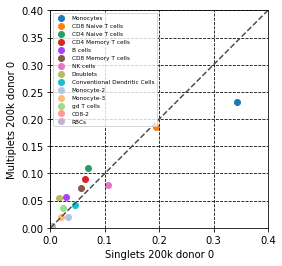

In [871]:
#singlet 200k donor0, multiplet 200k donor0
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(sng_200k_donor0[0], dbl_200k_donor0[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(sng_200k_donor0[1], dbl_200k_donor0[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(sng_200k_donor0[2], dbl_200k_donor0[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(sng_200k_donor0[3], dbl_200k_donor0[3], marker='o', color=colors[3])
B  = plt.scatter(sng_200k_donor0[4], dbl_200k_donor0[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(sng_200k_donor0[5], dbl_200k_donor0[5], marker='o', color=colors[5])
NK = plt.scatter(sng_200k_donor0[6], dbl_200k_donor0[6], marker='o', color=colors[6])
doublets = plt.scatter(sng_200k_donor0[7], dbl_200k_donor0[7], marker='o', color=colors[7])
cDC = plt.scatter(sng_200k_donor0[8], dbl_200k_donor0[8], marker='o', color=colors[8])
mono_2 = plt.scatter(sng_200k_donor0[9], dbl_200k_donor0[9], marker='o', color=colors[9])
mono_3 = plt.scatter(sng_200k_donor0[10], dbl_200k_donor0[10], marker='o', color=colors[10])
gd  = plt.scatter(sng_200k_donor0[11], dbl_200k_donor0[11], marker='o', color=colors[11])
CD8_2 = plt.scatter(sng_200k_donor0[12], dbl_200k_donor0[12], marker='o', color=colors[12])
rbc  = plt.scatter(sng_200k_donor0[13], dbl_200k_donor0[13], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,mono_2,mono_3,gd,CD8_2,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells','Monocyte-2','Monocyte-3',
                     'gd T cells','CD8-2','RBCs'),loc = 'upper left', fontsize = 'xx-small')
  
ax.set_xlabel('Singlets 200k donor 0')
ax.set_ylabel('Multiplets 200k donor 0')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.4))
ax.set_ylim((0,.4))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('all_clusters_200k_d0_s_200k_d0_m_correlation.png', dpi=600)


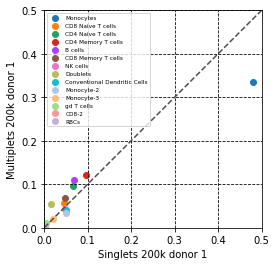

In [872]:
#singlet 200k donor1, multiplet 200k donor1
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(sng_200k_donor1[0], dbl_200k_donor1[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(sng_200k_donor1[1], dbl_200k_donor1[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(sng_200k_donor1[2], dbl_200k_donor1[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(sng_200k_donor1[3], dbl_200k_donor1[3], marker='o', color=colors[3])
B  = plt.scatter(sng_200k_donor1[4], dbl_200k_donor1[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(sng_200k_donor1[5], dbl_200k_donor1[5], marker='o', color=colors[5])
NK = plt.scatter(sng_200k_donor1[6], dbl_200k_donor1[6], marker='o', color=colors[6])
doublets = plt.scatter(sng_200k_donor1[7], dbl_200k_donor1[7], marker='o', color=colors[7])
cDC = plt.scatter(sng_200k_donor1[8], dbl_200k_donor1[8], marker='o', color=colors[8])
mono_2 = plt.scatter(sng_200k_donor1[9], dbl_200k_donor1[9], marker='o', color=colors[9])
mono_3 = plt.scatter(sng_200k_donor1[10], dbl_200k_donor1[10], marker='o', color=colors[10])
gd  = plt.scatter(sng_200k_donor1[11], dbl_200k_donor1[11], marker='o', color=colors[11])
CD8_2 = plt.scatter(sng_200k_donor1[12], dbl_200k_donor1[12], marker='o', color=colors[12])
rbc  = plt.scatter(sng_200k_donor1[13], dbl_200k_donor1[13], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,mono_2,mono_3,gd,CD8_2,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells','Monocyte-2','Monocyte-3',
                     'gd T cells','CD8-2','RBCs'),loc = 'upper left', fontsize = 'xx-small')
  
ax.set_xlabel('Singlets 200k donor 1')
ax.set_ylabel('Multiplets 200k donor 1')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('all_clusters_200k_d1_s_200k_d1_m_correlation.png', dpi=600)

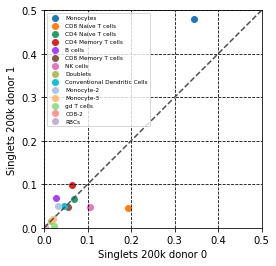

In [873]:
#singlet 200k donor0, singlet 200k donor1
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(sng_200k_donor0[0], sng_200k_donor1[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(sng_200k_donor0[1], sng_200k_donor1[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(sng_200k_donor0[2], sng_200k_donor1[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(sng_200k_donor0[3], sng_200k_donor1[3], marker='o', color=colors[3])
B  = plt.scatter(sng_200k_donor0[4], sng_200k_donor1[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(sng_200k_donor0[5], sng_200k_donor1[5], marker='o', color=colors[5])
NK = plt.scatter(sng_200k_donor0[6], sng_200k_donor1[6], marker='o', color=colors[6])
doublets = plt.scatter(sng_200k_donor0[7], sng_200k_donor1[7], marker='o', color=colors[7])
cDC = plt.scatter(sng_200k_donor0[8], sng_200k_donor1[8], marker='o', color=colors[8])
mono_2 = plt.scatter(sng_200k_donor0[9], sng_200k_donor1[9], marker='o', color=colors[9])
mono_3 = plt.scatter(sng_200k_donor0[10], sng_200k_donor1[10], marker='o', color=colors[10])
gd  = plt.scatter(sng_200k_donor0[11], sng_200k_donor1[11], marker='o', color=colors[11])
CD8_2 = plt.scatter(sng_200k_donor0[12], sng_200k_donor1[12], marker='o', color=colors[12])
rbc  = plt.scatter(sng_200k_donor0[13], sng_200k_donor1[13], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,mono_2,mono_3,gd,CD8_2,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells','Monocyte-2','Monocyte-3',
                     'gd T cells','CD8-2','RBCs'),loc = 'upper left', fontsize = 'xx-small')
  
ax.set_xlabel('Singlets 200k donor 0')
ax.set_ylabel('Singlets 200k donor 1')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('all_clusters_200k_d0_s_200k_d1_s_correlation.png', dpi=600)

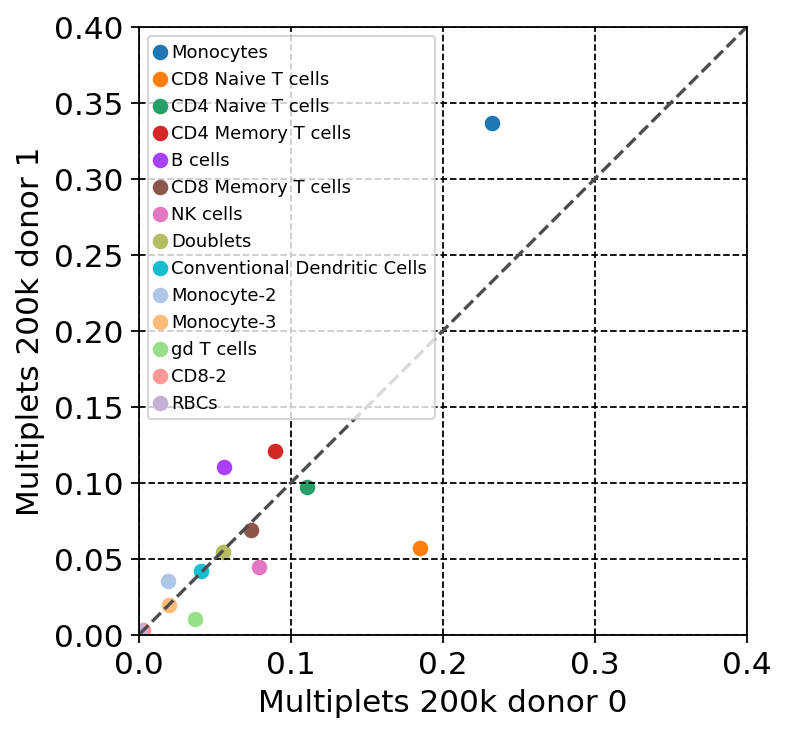

In [917]:
#multiplet 200k donor0, multiplet 200k donor1
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(dbl_200k_donor0[0], dbl_200k_donor1[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(dbl_200k_donor0[1], dbl_200k_donor1[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(dbl_200k_donor0[2], dbl_200k_donor1[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(dbl_200k_donor0[3], dbl_200k_donor1[3], marker='o', color=colors[3])
B  = plt.scatter(dbl_200k_donor0[4], dbl_200k_donor1[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(dbl_200k_donor0[5], dbl_200k_donor1[5], marker='o', color=colors[5])
NK = plt.scatter(dbl_200k_donor0[6], dbl_200k_donor1[6], marker='o', color=colors[6])
doublets = plt.scatter(dbl_200k_donor0[7], dbl_200k_donor1[7], marker='o', color=colors[7])
cDC = plt.scatter(dbl_200k_donor0[8], dbl_200k_donor1[8], marker='o', color=colors[8])
mono_2 = plt.scatter(dbl_200k_donor0[9], dbl_200k_donor1[9], marker='o', color=colors[9])
mono_3 = plt.scatter(dbl_200k_donor0[10], dbl_200k_donor1[10], marker='o', color=colors[10])
gd  = plt.scatter(dbl_200k_donor0[11], dbl_200k_donor1[11], marker='o', color=colors[11])
CD8_2 = plt.scatter(dbl_200k_donor0[12], dbl_200k_donor1[12], marker='o', color=colors[12])
rbc  = plt.scatter(dbl_200k_donor0[13], dbl_200k_donor1[13], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,mono_2,mono_3,gd,CD8_2,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells','Monocyte-2','Monocyte-3',
                     'gd T cells','CD8-2','RBCs'),loc = 'upper left', fontsize = 'xx-small')
  
ax.set_xlabel('Multiplets 200k donor 0')
ax.set_ylabel('Multiplets 200k donor 1')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.4))
ax.set_ylim((0,.4))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('all_clusters_200k_d0_m_200k_d1_m_correlation.png', dpi=600)


In [ ]:
#Cytof to SCITO-seq comparison

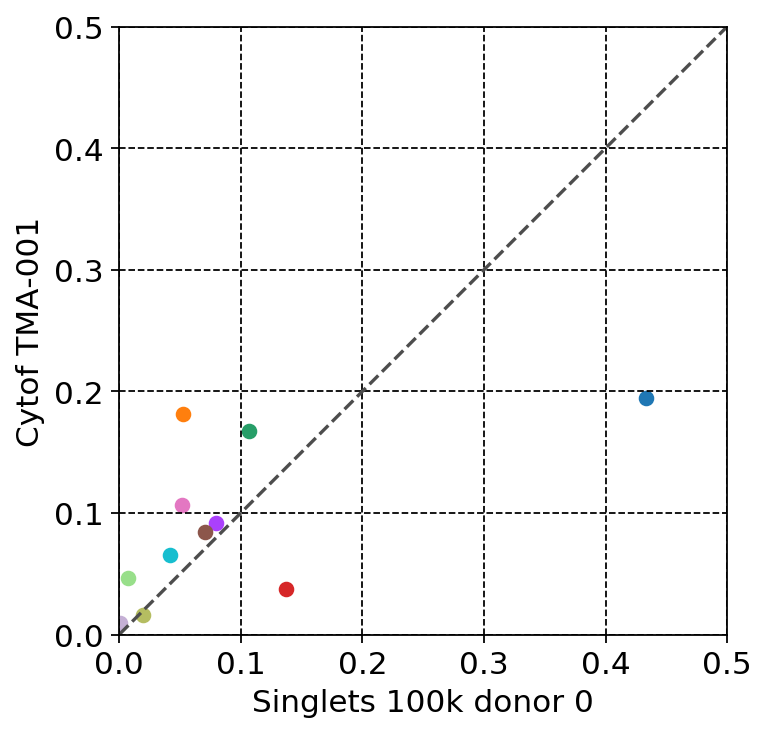

In [933]:
#singlet 100k donor0, multiplet 100k donor0
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(singlets_100_donor0[0], cytof_umap_proportions_001[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(singlets_100_donor0[1], cytof_umap_proportions_001[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(singlets_100_donor0[2], cytof_umap_proportions_001[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(singlets_100_donor0[3], cytof_umap_proportions_001[3], marker='o', color=colors[3])
B  = plt.scatter(singlets_100_donor0[4], cytof_umap_proportions_001[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(singlets_100_donor0[5], cytof_umap_proportions_001[5], marker='o', color=colors[5])
NK = plt.scatter(singlets_100_donor0[6], cytof_umap_proportions_001[6], marker='o', color=colors[6])
doublets = plt.scatter(singlets_100_donor0[7], cytof_umap_proportions_001[7], marker='o', color=colors[7])
cDC = plt.scatter(singlets_100_donor0[8], cytof_umap_proportions_001[8], marker='o', color=colors[8])
gd  = plt.scatter(singlets_100_donor0[9], cytof_umap_proportions_001[9], marker='o', color=colors[11])
rbc  = plt.scatter(singlets_100_donor0[10], cytof_umap_proportions_001[10], marker='o', color=colors[13])


ax.set_xlabel('Singlets 100k donor 0')
ax.set_ylabel('Cytof TMA-001') 

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

#fig.savefig('100k_d0_s_100k_d0_m_correlation.png', dpi=600)



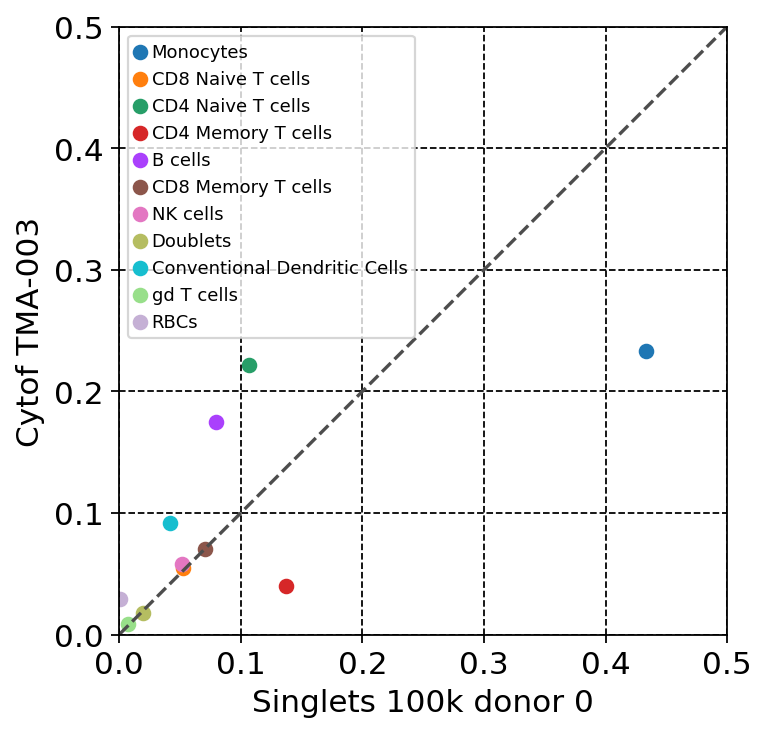

In [941]:
#singlet 100k donor0, Cytof TMA-003
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(singlets_100_donor0[0], cytof_umap_proportions_003[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(singlets_100_donor0[1], cytof_umap_proportions_003[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(singlets_100_donor0[2], cytof_umap_proportions_003[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(singlets_100_donor0[3], cytof_umap_proportions_003[3], marker='o', color=colors[3])
B  = plt.scatter(singlets_100_donor0[4], cytof_umap_proportions_003[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(singlets_100_donor0[5], cytof_umap_proportions_003[5], marker='o', color=colors[5])
NK = plt.scatter(singlets_100_donor0[6], cytof_umap_proportions_003[6], marker='o', color=colors[6])
doublets = plt.scatter(singlets_100_donor0[7], cytof_umap_proportions_003[7], marker='o', color=colors[7])
cDC = plt.scatter(singlets_100_donor0[8], cytof_umap_proportions_003[8], marker='o', color=colors[8])
gd  = plt.scatter(singlets_100_donor0[9], cytof_umap_proportions_003[9], marker='o', color=colors[11])
rbc  = plt.scatter(singlets_100_donor0[10], cytof_umap_proportions_003[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')
ax.set_xlabel('Singlets 100k donor 0')
ax.set_ylabel('Cytof TMA-003') 

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

#fig.savefig('100k_d0_s_100k_d0_m_correlation.png', dpi=600)




In [951]:
stats.pearsonr(singlets_100_donor0,cytof_umap_proportions_001)

(0.6057139404618678, 0.04826537187586606)

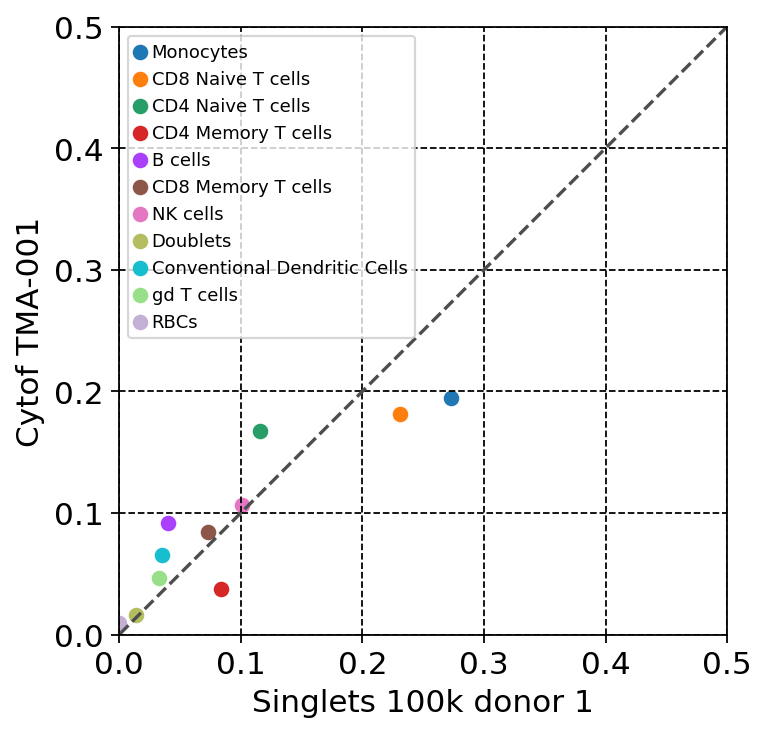

In [949]:
#singlet 100k donor1, Cytof TMA-001
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(singlets_100_donor1[0], cytof_umap_proportions_001[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(singlets_100_donor1[1], cytof_umap_proportions_001[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(singlets_100_donor1[2], cytof_umap_proportions_001[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(singlets_100_donor1[3], cytof_umap_proportions_001[3], marker='o', color=colors[3])
B  = plt.scatter(singlets_100_donor1[4], cytof_umap_proportions_001[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(singlets_100_donor1[5], cytof_umap_proportions_001[5], marker='o', color=colors[5])
NK = plt.scatter(singlets_100_donor1[6], cytof_umap_proportions_001[6], marker='o', color=colors[6])
doublets = plt.scatter(singlets_100_donor1[7], cytof_umap_proportions_001[7], marker='o', color=colors[7])
cDC = plt.scatter(singlets_100_donor1[8], cytof_umap_proportions_001[8], marker='o', color=colors[8])
gd  = plt.scatter(singlets_100_donor1[9], cytof_umap_proportions_001[9], marker='o', color=colors[11])
rbc  = plt.scatter(singlets_100_donor1[10], cytof_umap_proportions_001[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')
ax.set_xlabel('Singlets 100k donor 1')
ax.set_ylabel('Cytof TMA-001') 

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

#fig.savefig('100k_d0_s_100k_d0_m_correlation.png', dpi=600)





In [946]:
stats.pearsonr(singlets_100_donor1,cytof_umap_proportions_001)

(0.8914939654178576, 0.00022807732249428123)

In [1005]:
multiplet_100_donor1

[0.22854188210961737,
 0.1860134436401241,
 0.12086349534643226,
 0.08544467425025853,
 0.06747673216132369,
 0.07743019648397105,
 0.08790072388831438,
 0.07406928645294726,
 0.035677352637021716,
 0.03580661840744571,
 0.0007755946225439503]

In [921]:
singlets_100_donor0

[0.43304061470911087,
 0.052250274423710205,
 0.10669593852908892,
 0.13721185510428102,
 0.07947310647639956,
 0.07058177826564214,
 0.05126234906695939,
 0.019429198682766192,
 0.04215148188803513,
 0.007135016465422613,
 0.0007683863885839736]

In [1132]:
cytof_umap_proportions_001 = [0.2254,
0.1817,
0.1349,
0.0698,
0.0919,
0.084,
0.1064,
0.0161,
0.0345,
0.0461,
0.0091]

0.9996999999999999

In [680]:
per_batch_norm_from_R_adata_2.write("200k.h5ad")

In [683]:
per_batch_norm_from_R_adata.write("100k.h5ad")

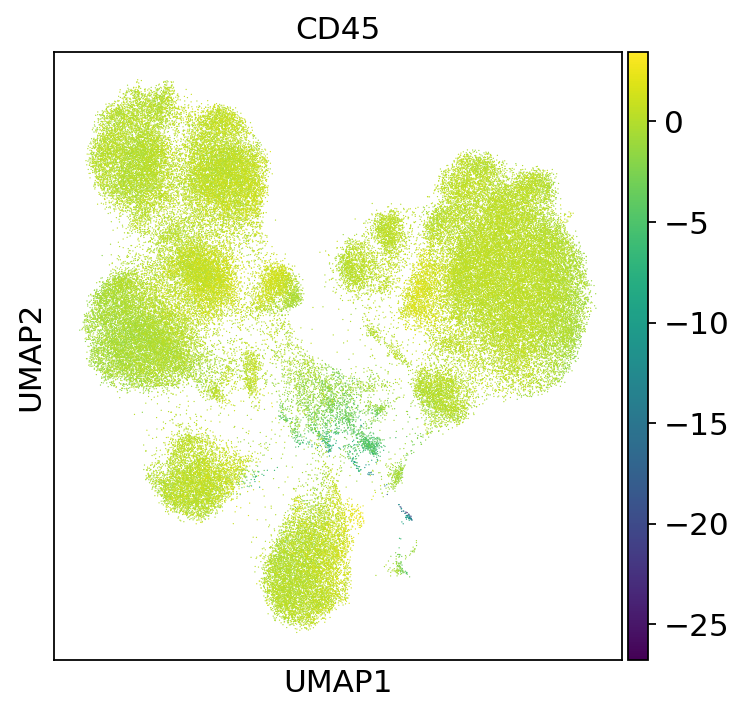

In [1004]:
sc.pl.umap(per_batch_norm_from_R_adata_2,color = 'CD45')

In [ ]:
#SCITO-seq all cells per donor vs. Cytof

# 100k

In [952]:
donor0_200k = per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['Demuxlet']== 'donor0']
donor1_200k = per_batch_norm_from_R_adata_2[per_batch_norm_from_R_adata_2.obs['Demuxlet']== 'donor1']

In [953]:
donor0_100k = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['Demuxlet']== 'donor0']
donor1_100k = per_batch_norm_from_R_adata[per_batch_norm_from_R_adata.obs['Demuxlet']== 'donor1']

In [963]:
#donor0 200k all cell proportions
m_sng = (donor0_200k[(donor0_200k.obs['leiden']=='Monocytes')].shape[0]+donor0_200k[(donor0_200k.obs['leiden']=='Monocyte-2')].shape[0])/(donor0_200k.obs.shape[0])
cd8n_sng = (donor0_200k[(donor0_200k.obs['leiden']=='CD8 Naive T cells')].shape[0]+donor0_200k[(donor0_200k.obs['leiden']=='CD8-2') ].shape[0])/donor0_200k.obs.shape[0]
cd4n_sng = donor0_200k[(donor0_200k.obs['leiden']=='CD4 Naive T cells') ].shape[0]/donor0_200k.obs.shape[0]
cd4m_sng = donor0_200k[(donor0_200k.obs['leiden']=='CD4 Memory T cells') ].shape[0]/donor0_200k.obs.shape[0]
b_sng = donor0_200k[(donor0_200k.obs['leiden']=='B cells') ].shape[0]/donor0_200k.obs.shape[0]
cd8m_sng = donor0_200k[(donor0_200k.obs['leiden']=='CD8 Memory T cells') ].shape[0]/donor0_200k.obs.shape[0]
nk_sng = donor0_200k[(donor0_200k.obs['leiden']=='NK cells') ].shape[0]/donor0_200k.obs.shape[0]
dbl_sng = (donor0_200k[(donor0_200k.obs['leiden']=='Doublets') ].shape[0]+donor0_200k[(donor0_200k.obs['leiden']=='Monocyte-3') ].shape[0])/donor0_200k.obs.shape[0]
cdc_sng = donor0_200k[(donor0_200k.obs['leiden']=='Conventional Dendritic Cells') ].shape[0]/donor0_200k.obs.shape[0]
gdt_sng = donor0_200k[(donor0_200k.obs['leiden']=='gd T cells') ].shape[0]/donor0_200k.obs.shape[0]
rbc_sng = donor0_200k[(donor0_200k.obs['leiden']=='RBCs') ].shape[0]/donor0_200k.obs.shape[0]

donor0_all_cells_200k = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(donor0_all_cells)


1.0

In [964]:
#donor1 200k all cell proportions
m_sng = (donor1_200k[(donor1_200k.obs['leiden']=='Monocytes')].shape[0]+donor1_200k[(donor1_200k.obs['leiden']=='Monocyte-2')].shape[0])/(donor1_200k.obs.shape[0])
cd8n_sng = (donor1_200k[(donor1_200k.obs['leiden']=='CD8 Naive T cells')].shape[0]+donor1_200k[(donor1_200k.obs['leiden']=='CD8-2') ].shape[0])/donor1_200k.obs.shape[0]
cd4n_sng = donor1_200k[(donor1_200k.obs['leiden']=='CD4 Naive T cells') ].shape[0]/donor1_200k.obs.shape[0]
cd4m_sng = donor1_200k[(donor1_200k.obs['leiden']=='CD4 Memory T cells') ].shape[0]/donor1_200k.obs.shape[0]
b_sng = donor1_200k[(donor1_200k.obs['leiden']=='B cells') ].shape[0]/donor1_200k.obs.shape[0]
cd8m_sng = donor1_200k[(donor1_200k.obs['leiden']=='CD8 Memory T cells') ].shape[0]/donor1_200k.obs.shape[0]
nk_sng = donor1_200k[(donor1_200k.obs['leiden']=='NK cells') ].shape[0]/donor1_200k.obs.shape[0]
dbl_sng = (donor1_200k[(donor1_200k.obs['leiden']=='Doublets') ].shape[0]+donor1_200k[(donor1_200k.obs['leiden']=='Monocyte-3') ].shape[0])/donor1_200k.obs.shape[0]
cdc_sng = donor1_200k[(donor1_200k.obs['leiden']=='Conventional Dendritic Cells') ].shape[0]/donor1_200k.obs.shape[0]
gdt_sng = donor1_200k[(donor1_200k.obs['leiden']=='gd T cells') ].shape[0]/donor1_200k.obs.shape[0]
rbc_sng = donor1_200k[(donor1_200k.obs['leiden']=='RBCs') ].shape[0]/donor1_200k.obs.shape[0]

donor1_all_cells_200k = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(donor1_all_cells)



0.9999999999999999

In [965]:
#donor0 100k all cell proportions
m_sng = (donor0_100k[(donor0_100k.obs['leiden']=='Monocytes')].shape[0]+donor0_100k[(donor0_100k.obs['leiden']=='Monocyte-2')].shape[0])/(donor0_100k.obs.shape[0])
cd8n_sng = donor0_100k[(donor0_100k.obs['leiden']=='CD8 Naive T cells')].shape[0]/donor0_100k.obs.shape[0]
cd4n_sng = donor0_100k[(donor0_100k.obs['leiden']=='CD4 Naive T cells')].shape[0]/donor0_100k.obs.shape[0]
cd4m_sng = donor0_100k[(donor0_100k.obs['leiden']=='CD4 Memory T cells') ].shape[0]/donor0_100k.obs.shape[0]
b_sng = donor0_100k[(donor0_100k.obs['leiden']=='B cells') ].shape[0]/donor0_100k.obs.shape[0]
cd8m_sng = donor0_100k[(donor0_100k.obs['leiden']=='CD8 Memory T cells') ].shape[0]/donor0_100k.obs.shape[0]
nk_sng = donor0_100k[(donor0_100k.obs['leiden']=='NK cells') ].shape[0]/donor0_100k.obs.shape[0]
dbl_sng = (donor0_100k[(donor0_100k.obs['leiden']=='Doublets') ].shape[0]+donor0_100k[(donor0_100k.obs['leiden']=='Monocyte-3') ].shape[0])/donor0_100k.obs.shape[0]
cdc_sng = donor0_100k[(donor0_100k.obs['leiden']=='Conventional Dendritic Cells') ].shape[0]/donor0_100k.obs.shape[0]
gdt_sng = donor0_100k[(donor0_100k.obs['leiden']=='gd T cells') ].shape[0]/donor0_100k.obs.shape[0]
rbc_sng = donor0_100k[(donor0_100k.obs['leiden']=='RBCs') ].shape[0]/donor0_100k.obs.shape[0]

donor0_all_cells_100k = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(donor0_all_cells)



1.0

In [966]:
#donor1 100k all cell proportions
m_sng = (donor1_100k[(donor1_100k.obs['leiden']=='Monocytes')].shape[0]+donor1_100k[(donor1_100k.obs['leiden']=='Monocyte-2')].shape[0])/(donor1_100k.obs.shape[0])
cd8n_sng = donor1_100k[(donor1_100k.obs['leiden']=='CD8 Naive T cells')].shape[0]/donor1_100k.obs.shape[0]
cd4n_sng = donor1_100k[(donor1_100k.obs['leiden']=='CD4 Naive T cells') ].shape[0]/donor1_100k.obs.shape[0]
cd4m_sng = donor1_100k[(donor1_100k.obs['leiden']=='CD4 Memory T cells') ].shape[0]/donor1_100k.obs.shape[0]
b_sng = donor1_100k[(donor1_100k.obs['leiden']=='B cells') ].shape[0]/donor1_100k.obs.shape[0]
cd8m_sng = donor1_100k[(donor1_100k.obs['leiden']=='CD8 Memory T cells') ].shape[0]/donor1_100k.obs.shape[0]
nk_sng = donor1_100k[(donor1_100k.obs['leiden']=='NK cells') ].shape[0]/donor1_100k.obs.shape[0]
dbl_sng = (donor1_100k[(donor1_100k.obs['leiden']=='Doublets') ].shape[0]+donor1_100k[(donor1_100k.obs['leiden']=='Monocyte-3') ].shape[0])/donor1_100k.obs.shape[0]
cdc_sng = donor1_100k[(donor1_100k.obs['leiden']=='Conventional Dendritic Cells') ].shape[0]/donor1_100k.obs.shape[0]
gdt_sng = donor1_100k[(donor1_100k.obs['leiden']=='gd T cells') ].shape[0]/donor1_100k.obs.shape[0]
rbc_sng = donor1_100k[(donor1_100k.obs['leiden']=='RBCs') ].shape[0]/donor1_100k.obs.shape[0]

donor1_all_cells_100k = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(donor1_all_cells)




0.9999999999999999

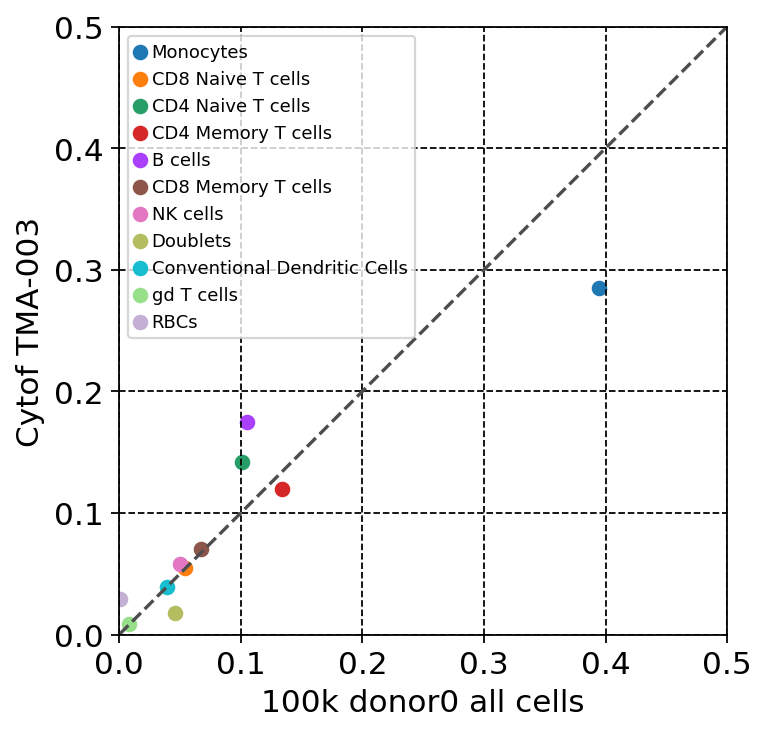

In [1134]:
#100k donor0 all cells, TMA-003
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(donor0_all_cells_100k[0], cytof_umap_proportions_003[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(donor0_all_cells_100k[1], cytof_umap_proportions_003[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(donor0_all_cells_100k[2], cytof_umap_proportions_003[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(donor0_all_cells_100k[3], cytof_umap_proportions_003[3], marker='o', color=colors[3])
B  = plt.scatter(donor0_all_cells_100k[4], cytof_umap_proportions_003[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(donor0_all_cells_100k[5], cytof_umap_proportions_003[5], marker='o', color=colors[5])
NK = plt.scatter(donor0_all_cells_100k[6], cytof_umap_proportions_003[6], marker='o', color=colors[6])
doublets = plt.scatter(donor0_all_cells_100k[7], cytof_umap_proportions_003[7], marker='o', color=colors[7])
cDC = plt.scatter(donor0_all_cells_100k[8], cytof_umap_proportions_003[8], marker='o', color=colors[8])
gd  = plt.scatter(donor0_all_cells_100k[9], cytof_umap_proportions_003[9], marker='o', color=colors[11])
rbc  = plt.scatter(donor0_all_cells_100k[10], cytof_umap_proportions_003[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')
ax.set_xlabel('100k donor0 all cells')
ax.set_ylabel('Cytof TMA-003') 

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('all_cells_100k_d0_cytof_003_correlation.png', dpi=600)


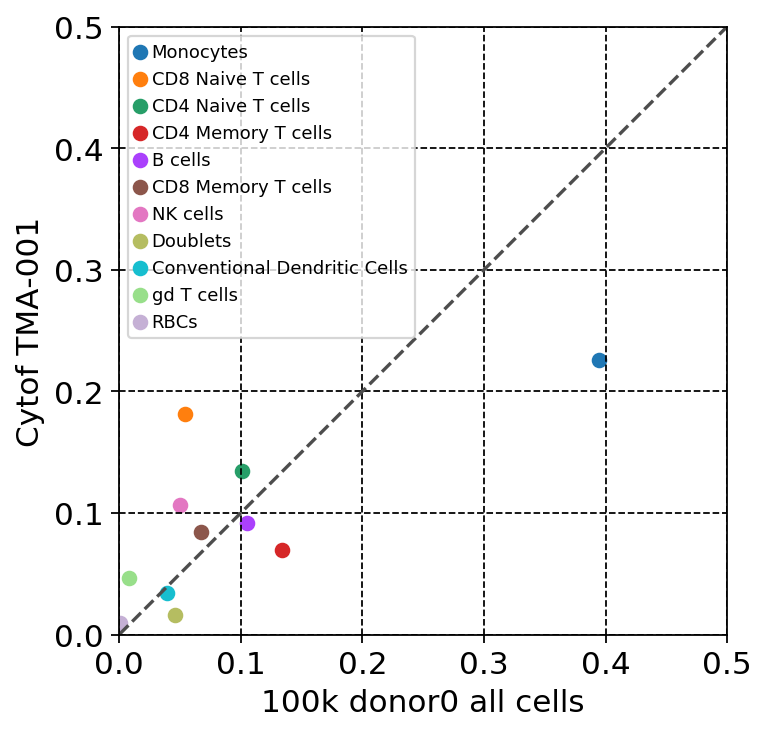

In [1135]:
#100k donor0 all cells, TMA-001
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(donor0_all_cells_100k[0], cytof_umap_proportions_001[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(donor0_all_cells_100k[1], cytof_umap_proportions_001[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(donor0_all_cells_100k[2], cytof_umap_proportions_001[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(donor0_all_cells_100k[3], cytof_umap_proportions_001[3], marker='o', color=colors[3])
B  = plt.scatter(donor0_all_cells_100k[4], cytof_umap_proportions_001[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(donor0_all_cells_100k[5], cytof_umap_proportions_001[5], marker='o', color=colors[5])
NK = plt.scatter(donor0_all_cells_100k[6], cytof_umap_proportions_001[6], marker='o', color=colors[6])
doublets = plt.scatter(donor0_all_cells_100k[7], cytof_umap_proportions_001[7], marker='o', color=colors[7])
cDC = plt.scatter(donor0_all_cells_100k[8], cytof_umap_proportions_001[8], marker='o', color=colors[8])
gd  = plt.scatter(donor0_all_cells_100k[9], cytof_umap_proportions_001[9], marker='o', color=colors[11])
rbc  = plt.scatter(donor0_all_cells_100k[10], cytof_umap_proportions_001[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')
ax.set_xlabel('100k donor0 all cells')
ax.set_ylabel('Cytof TMA-001') 

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('all_cells_100k_d0_cytof_001_correlation.png', dpi=600)


In [1136]:
stats.pearsonr(donor0_all_cells_100k, cytof_umap_proportions_001)

(0.7290951744392387, 0.010903521704400551)

In [1137]:
stats.pearsonr(donor0_all_cells_100k, cytof_umap_proportions_003)

(0.9216361399639295, 5.514167643634253e-05)

In [1138]:
stats.pearsonr(donor1_all_cells_100k, cytof_umap_proportions_001)

(0.9635645459132491, 1.868361964692717e-06)

In [1139]:
stats.pearsonr(donor1_all_cells_100k, cytof_umap_proportions_003)

(0.6504924994873549, 0.030218463021662822)

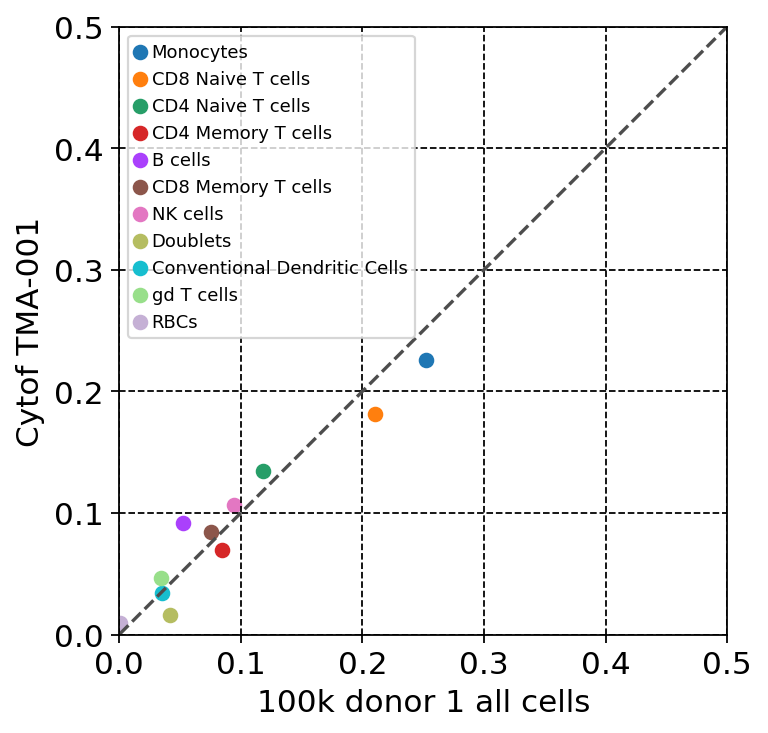

In [1140]:
#100k donor1 all cells, TMA-001
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(donor1_all_cells_100k[0], cytof_umap_proportions_001[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(donor1_all_cells_100k[1], cytof_umap_proportions_001[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(donor1_all_cells_100k[2], cytof_umap_proportions_001[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(donor1_all_cells_100k[3], cytof_umap_proportions_001[3], marker='o', color=colors[3])
B  = plt.scatter(donor1_all_cells_100k[4], cytof_umap_proportions_001[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(donor1_all_cells_100k[5], cytof_umap_proportions_001[5], marker='o', color=colors[5])
NK = plt.scatter(donor1_all_cells_100k[6], cytof_umap_proportions_001[6], marker='o', color=colors[6])
doublets = plt.scatter(donor1_all_cells_100k[7], cytof_umap_proportions_001[7], marker='o', color=colors[7])
cDC = plt.scatter(donor1_all_cells_100k[8], cytof_umap_proportions_001[8], marker='o', color=colors[8])
gd  = plt.scatter(donor1_all_cells_100k[9], cytof_umap_proportions_001[9], marker='o', color=colors[11])
rbc  = plt.scatter(donor1_all_cells_100k[10], cytof_umap_proportions_001[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')
ax.set_xlabel('100k donor 1 all cells')
ax.set_ylabel('Cytof TMA-001') 

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('all_cells_100k_d1_cytof_001_correlation.png', dpi=600)


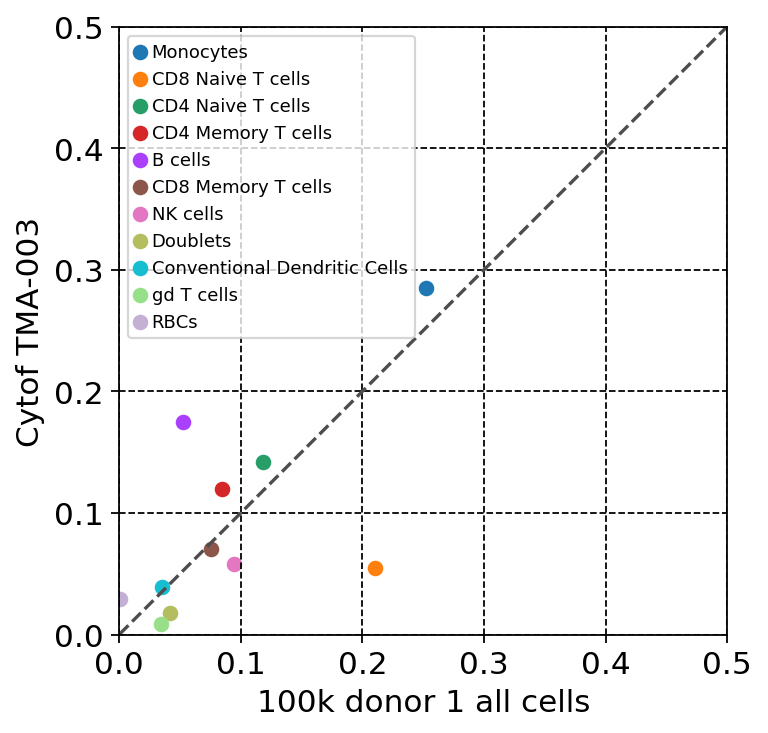

In [1141]:
#100k donor1 all cells, TMA-003
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(donor1_all_cells_100k[0], cytof_umap_proportions_003[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(donor1_all_cells_100k[1], cytof_umap_proportions_003[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(donor1_all_cells_100k[2], cytof_umap_proportions_003[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(donor1_all_cells_100k[3], cytof_umap_proportions_003[3], marker='o', color=colors[3])
B  = plt.scatter(donor1_all_cells_100k[4], cytof_umap_proportions_003[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(donor1_all_cells_100k[5], cytof_umap_proportions_003[5], marker='o', color=colors[5])
NK = plt.scatter(donor1_all_cells_100k[6], cytof_umap_proportions_003[6], marker='o', color=colors[6])
doublets = plt.scatter(donor1_all_cells_100k[7], cytof_umap_proportions_003[7], marker='o', color=colors[7])
cDC = plt.scatter(donor1_all_cells_100k[8], cytof_umap_proportions_003[8], marker='o', color=colors[8])
gd  = plt.scatter(donor1_all_cells_100k[9], cytof_umap_proportions_003[9], marker='o', color=colors[11])
rbc  = plt.scatter(donor1_all_cells_100k[10], cytof_umap_proportions_003[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')
ax.set_xlabel('100k donor 1 all cells')
ax.set_ylabel('Cytof TMA-003') 

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('all_cells_100k_d1_cytof_003_correlation.png', dpi=600)

In [ ]:
#200k

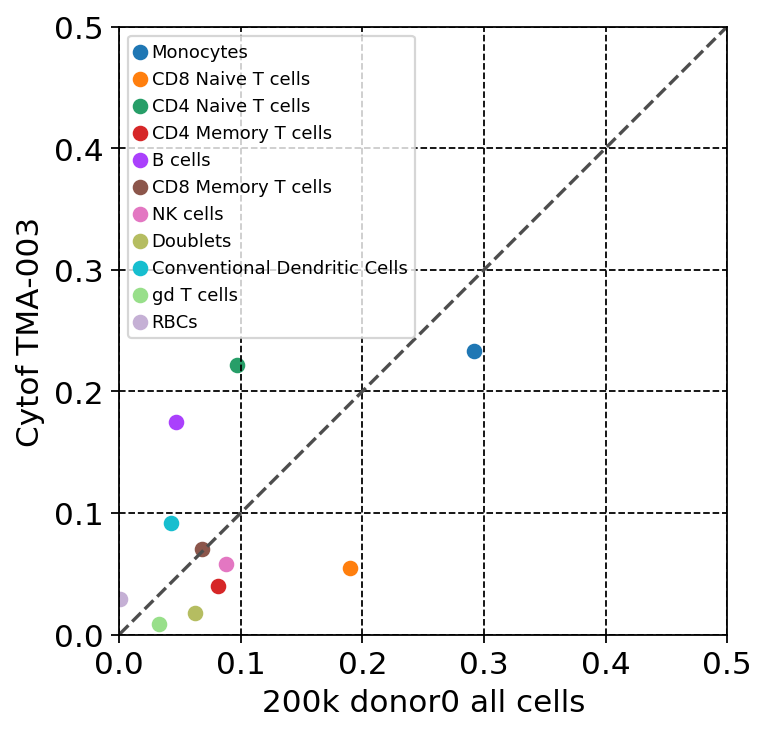

In [996]:
#200k donor0 all cells, TMA-003
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(donor0_all_cells_200k[0], cytof_umap_proportions_003[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(donor0_all_cells_200k[1], cytof_umap_proportions_003[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(donor0_all_cells_200k[2], cytof_umap_proportions_003[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(donor0_all_cells_200k[3], cytof_umap_proportions_003[3], marker='o', color=colors[3])
B  = plt.scatter(donor0_all_cells_200k[4], cytof_umap_proportions_003[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(donor0_all_cells_200k[5], cytof_umap_proportions_003[5], marker='o', color=colors[5])
NK = plt.scatter(donor0_all_cells_200k[6], cytof_umap_proportions_003[6], marker='o', color=colors[6])
doublets = plt.scatter(donor0_all_cells_200k[7], cytof_umap_proportions_003[7], marker='o', color=colors[7])
cDC = plt.scatter(donor0_all_cells_200k[8], cytof_umap_proportions_003[8], marker='o', color=colors[8])
gd  = plt.scatter(donor0_all_cells_200k[9], cytof_umap_proportions_003[9], marker='o', color=colors[11])
rbc  = plt.scatter(donor0_all_cells_200k[10], cytof_umap_proportions_003[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')
ax.set_xlabel('200k donor0 all cells')
ax.set_ylabel('Cytof TMA-003') 

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('all_cells_200k_d0_cytof_003_correlation.png', dpi=600)







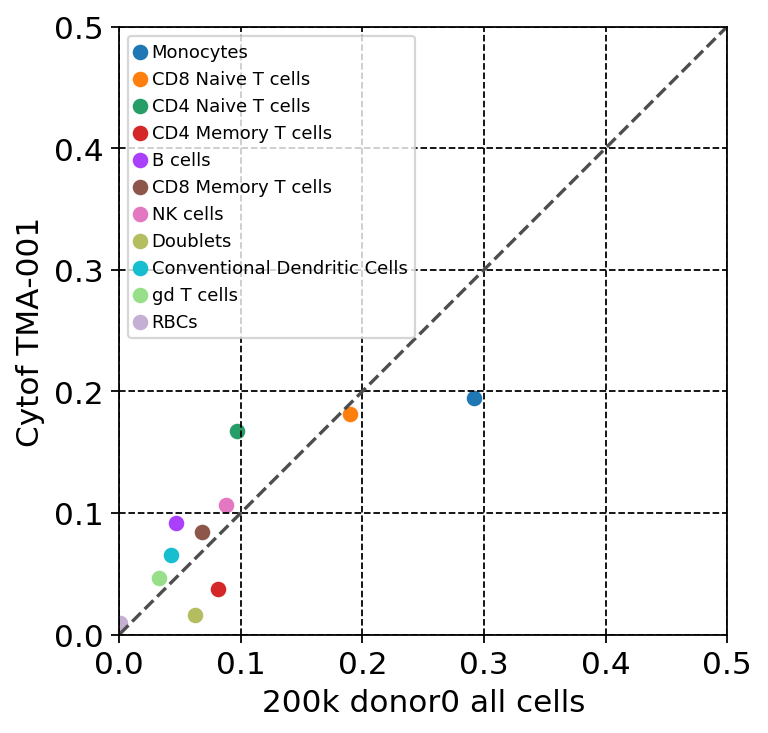

In [997]:
#200k donor0 all cells, TMA-001
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(donor0_all_cells_200k[0], cytof_umap_proportions_001[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(donor0_all_cells_200k[1], cytof_umap_proportions_001[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(donor0_all_cells_200k[2], cytof_umap_proportions_001[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(donor0_all_cells_200k[3], cytof_umap_proportions_001[3], marker='o', color=colors[3])
B  = plt.scatter(donor0_all_cells_200k[4], cytof_umap_proportions_001[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(donor0_all_cells_200k[5], cytof_umap_proportions_001[5], marker='o', color=colors[5])
NK = plt.scatter(donor0_all_cells_200k[6], cytof_umap_proportions_001[6], marker='o', color=colors[6])
doublets = plt.scatter(donor0_all_cells_200k[7], cytof_umap_proportions_001[7], marker='o', color=colors[7])
cDC = plt.scatter(donor0_all_cells_200k[8], cytof_umap_proportions_001[8], marker='o', color=colors[8])
gd  = plt.scatter(donor0_all_cells_200k[9], cytof_umap_proportions_001[9], marker='o', color=colors[11])
rbc  = plt.scatter(donor0_all_cells_200k[10], cytof_umap_proportions_001[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')
ax.set_xlabel('200k donor0 all cells')
ax.set_ylabel('Cytof TMA-001') 

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('all_cells_200k_d0_cytof_001_correlation.png', dpi=600)








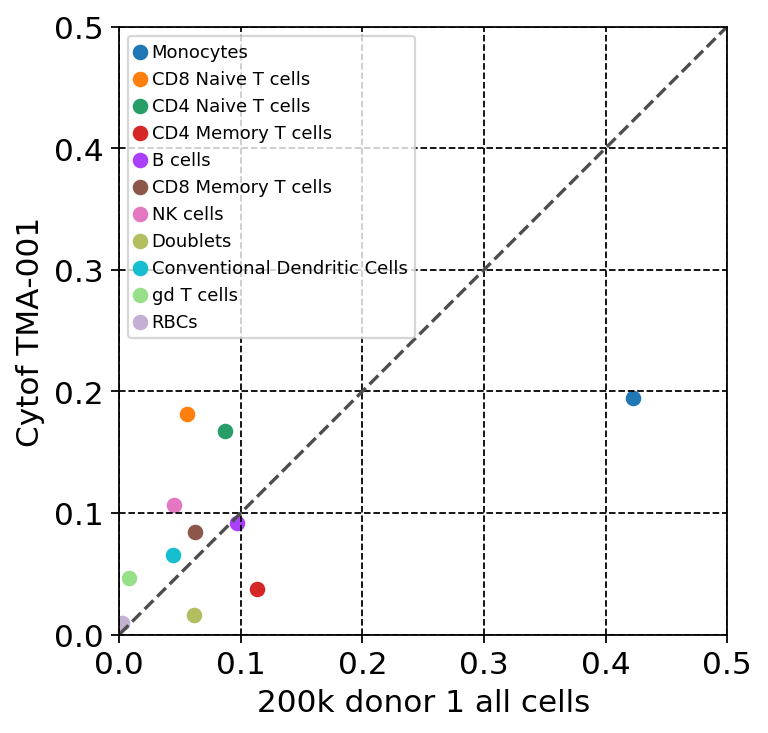

In [1002]:
#200k donor1 all cells, TMA-001
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(donor1_all_cells_200k[0], cytof_umap_proportions_001[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(donor1_all_cells_200k[1], cytof_umap_proportions_001[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(donor1_all_cells_200k[2], cytof_umap_proportions_001[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(donor1_all_cells_200k[3], cytof_umap_proportions_001[3], marker='o', color=colors[3])
B  = plt.scatter(donor1_all_cells_200k[4], cytof_umap_proportions_001[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(donor1_all_cells_200k[5], cytof_umap_proportions_001[5], marker='o', color=colors[5])
NK = plt.scatter(donor1_all_cells_200k[6], cytof_umap_proportions_001[6], marker='o', color=colors[6])
doublets = plt.scatter(donor1_all_cells_200k[7], cytof_umap_proportions_001[7], marker='o', color=colors[7])
cDC = plt.scatter(donor1_all_cells_200k[8], cytof_umap_proportions_001[8], marker='o', color=colors[8])
gd  = plt.scatter(donor1_all_cells_200k[9], cytof_umap_proportions_001[9], marker='o', color=colors[11])
rbc  = plt.scatter(donor1_all_cells_200k[10], cytof_umap_proportions_001[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')
ax.set_xlabel('200k donor 1 all cells')
ax.set_ylabel('Cytof TMA-001') 

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('all_cells_200k_d1_cytof_001_correlation.png', dpi=600)



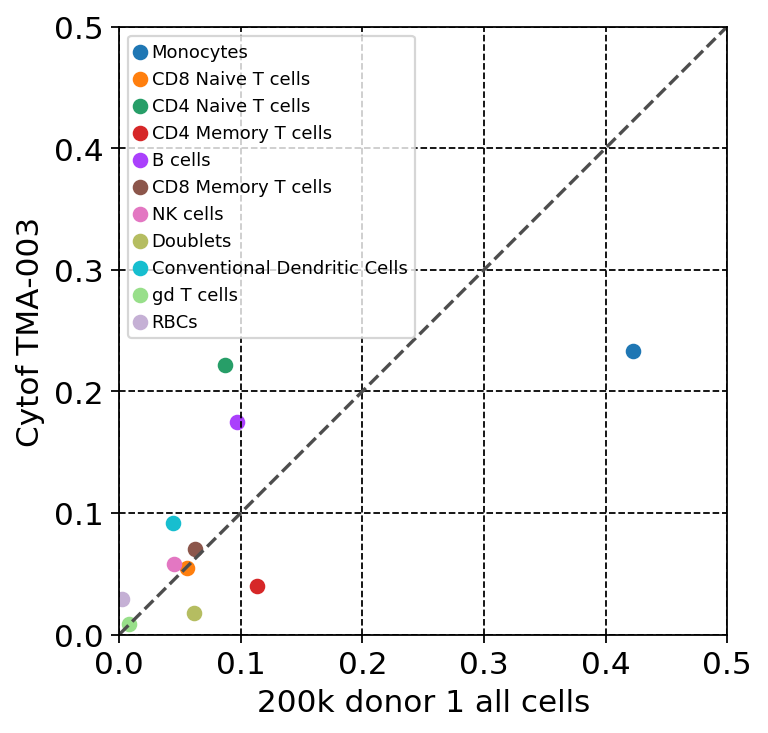

In [999]:
#200k donor1 all cells, TMA-003
fig, ax = plt.subplots()

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(donor1_all_cells_200k[0], cytof_umap_proportions_003[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(donor1_all_cells_200k[1], cytof_umap_proportions_003[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(donor1_all_cells_200k[2], cytof_umap_proportions_003[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(donor1_all_cells_200k[3], cytof_umap_proportions_003[3], marker='o', color=colors[3])
B  = plt.scatter(donor1_all_cells_200k[4], cytof_umap_proportions_003[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(donor1_all_cells_200k[5], cytof_umap_proportions_003[5], marker='o', color=colors[5])
NK = plt.scatter(donor1_all_cells_200k[6], cytof_umap_proportions_003[6], marker='o', color=colors[6])
doublets = plt.scatter(donor1_all_cells_200k[7], cytof_umap_proportions_003[7], marker='o', color=colors[7])
cDC = plt.scatter(donor1_all_cells_200k[8], cytof_umap_proportions_003[8], marker='o', color=colors[8])
gd  = plt.scatter(donor1_all_cells_200k[9], cytof_umap_proportions_003[9], marker='o', color=colors[11])
rbc  = plt.scatter(donor1_all_cells_200k[10], cytof_umap_proportions_003[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')
ax.set_xlabel('200k donor 1 all cells')
ax.set_ylabel('Cytof TMA-003') 

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

fig.savefig('all_cells_200k_d1_cytof_003_correlation.png', dpi=600)

In [1001]:
stats.pearsonr(donor0_all_cells_200k, cytof_umap_proportions_001)

(0.8207636153375719, 0.0019610556394406876)

In [1000]:
stats.pearsonr(donor0_all_cells_200k, cytof_umap_proportions_003)

(0.5332620092278604, 0.09117419224930874)

In [988]:
stats.pearsonr(donor1_all_cells_200k, cytof_umap_proportions_001)

(0.5777454877616578, 0.06268016697035621)

In [989]:
stats.pearsonr(donor1_all_cells_200k, cytof_umap_proportions_003)

(0.6829703059622252, 0.020543710595306706)

In [1006]:
per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0,donor1')].shape[0]+per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['leiden']=='Monocyte-2') & (per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')].shape[0])


SyntaxError: invalid syntax (<ipython-input-1006-369c74be5d6e>, line 1)

In [1016]:
per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0,donor1')].shape[0]

3623

Trying to set attribute `.uns` of view, copying.


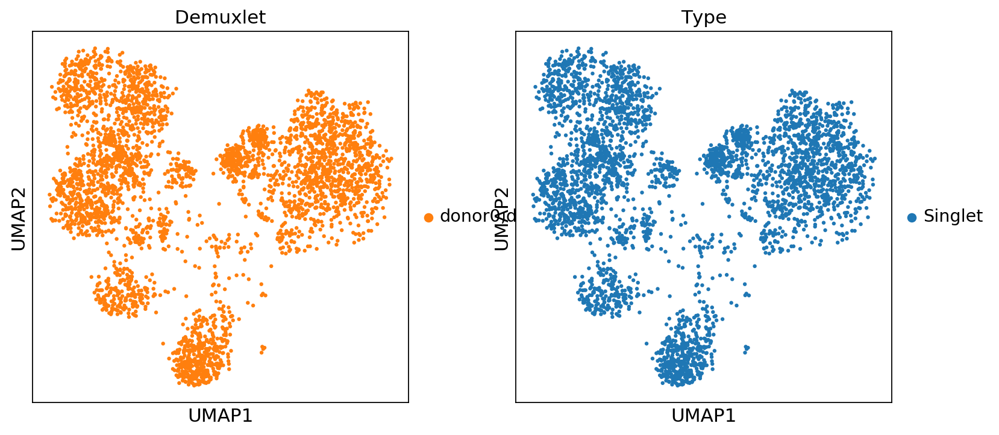

In [1015]:
sc.pl.umap(per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Type']=='Singlet')&(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0,donor1')], color = ['Demuxlet','Type'])


In [1197]:
no_demux_doublets_200k = per_batch_norm_from_R_adata_2[(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0')|(per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor1')|((per_batch_norm_from_R_adata_2.obs['Demuxlet']=='donor0,donor1')&(per_batch_norm_from_R_adata_2.obs['Type']=='Doublet'))]


In [1157]:
no_demux_doublets_200k

View of AnnData object with n_obs × n_vars = 87758 × 28 
    obs: 'Batch', 'DBC', 'Demuxlet', 'Type', 'batch', 'nCount_ADT', 'nCount_RNA', 'nFeature_ADT', 'nFeature_RNA', 'n_counts', 'orig.ident', 'leiden', 'umap_density'
    uns: 'pca', 'neighbors', 'leiden', 'umap', 'Demuxlet_colors', 'umap_density_params'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

In [1258]:
sc.tl.pca(no_demux_doublets_200k, svd_solver='arpack', use_highly_variable=None)
sc.pp.neighbors(no_demux_doublets_200k, n_neighbors=10, n_pcs=15)
sc.tl.umap(no_demux_doublets_200k)
sc.tl.leiden(no_demux_doublets_200k)

/wynton/home/ye/davidslee/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../home/ye/davidslee/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


In [1259]:
new_cluster_names = ['Monocytes','CD8 Naive T cells','CD4 Memory T cells','CD4 Naive T cells','B cells','CD8 Memory T cells',
                     'Monocyte-2','Natural Killer cells','Monocyte-3','Doublets','Conventional Dendritic Cells','Monocyte-4','Doublets-2','Monocyte-5',
                     'gd T cells','Monocyte-6','Doublets-3','Doublets-4','RBCs']
no_demux_doublets_200k.rename_categories('leiden', new_cluster_names)

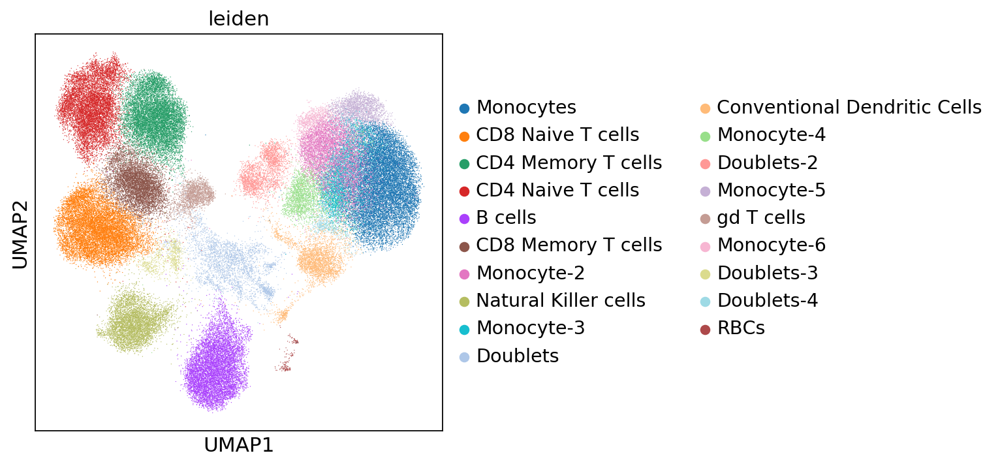

In [1260]:
sc.pl.umap(no_demux_doublets_200k, color = 'leiden', save='200k_1_resolution_leiden.png')

In [ ]:
# monos are 0, 6, 8, 11,12*dbl, 13, 15,17*dbl

In [1202]:
#combine clusters
no_demux_doublets_200k.obs['leiden']=no_demux_doublets_200k.obs['leiden'].where(no_demux_doublets_200k.obs['leiden']!='Monocyte-2','Monocytes')
no_demux_doublets_200k.obs['leiden']=no_demux_doublets_200k.obs['leiden'].where(no_demux_doublets_200k.obs['leiden']!='Monocyte-3','Monocytes')
no_demux_doublets_200k.obs['leiden']=no_demux_doublets_200k.obs['leiden'].where(no_demux_doublets_200k.obs['leiden']!='Monocyte-4','Monocytes')
no_demux_doublets_200k.obs['leiden']=no_demux_doublets_200k.obs['leiden'].where(no_demux_doublets_200k.obs['leiden']!='Monocyte-5','Monocytes')
no_demux_doublets_200k.obs['leiden']=no_demux_doublets_200k.obs['leiden'].where(no_demux_doublets_200k.obs['leiden']!='Monocyte-6','Monocytes')
no_demux_doublets_200k.obs['leiden']=no_demux_doublets_200k.obs['leiden'].where(no_demux_doublets_200k.obs['leiden']!='Doublets-2','Doublets')
no_demux_doublets_200k.obs['leiden']=no_demux_doublets_200k.obs['leiden'].where(no_demux_doublets_200k.obs['leiden']!='Doublets-3','Doublets')
no_demux_doublets_200k.obs['leiden']=no_demux_doublets_200k.obs['leiden'].where(no_demux_doublets_200k.obs['leiden']!='Doublets-4','Doublets')



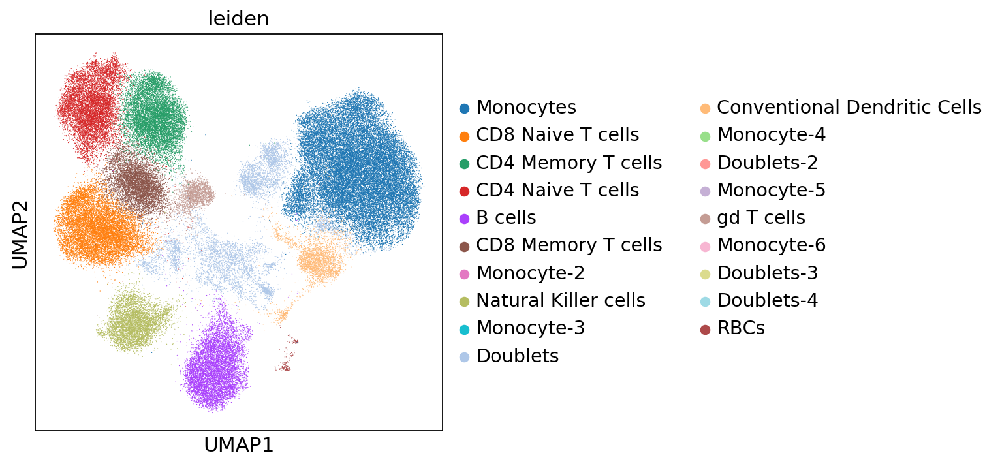

In [1257]:
sc.pl.umap(no_demux_doublets_200k, color = 'leiden', save='200k_1_resolution_leiden_merged.png')

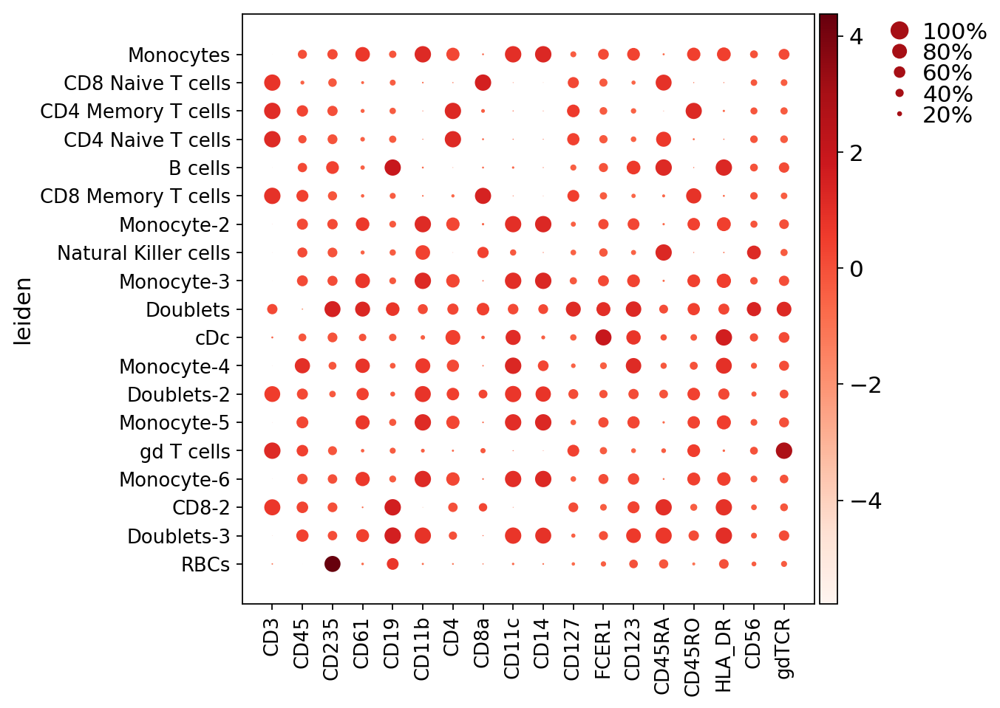

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[6.3, 0, 0.2, 0.5, 0.25])

In [1163]:
sc.pl.dotplot(no_demux_doublets_200k, groupby = 'leiden', var_names = ['CD3','CD45','CD235','CD61','CD19','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123', 'CD45RA','CD45RO', 'HLA_DR','CD56','gdTCR'])


In [1122]:
m_sng = (no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='0')].shape[0]+no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='6')].shape[0]+no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='8')].shape[0]+no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='11')].shape[0]+no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='13')].shape[0]+no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='15')].shape[0])/(no_demux_doublets_200k.obs.shape[0])
m_sng


0.3244604480503202

In [1105]:
mpl.cm.Spectral_r

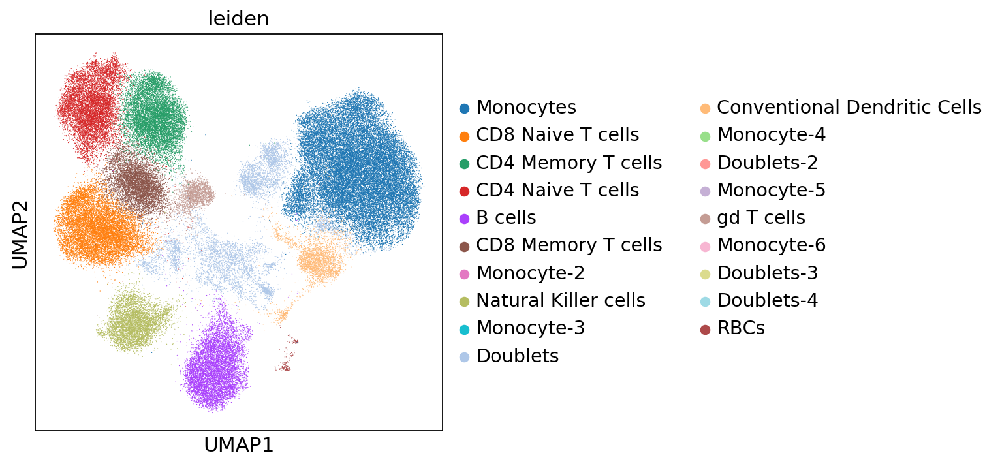

In [1254]:
sc.pl.umap(no_demux_doublets_200k, color ='leiden')

In [1206]:
#donor0 200k all cell proportions
m_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='Monocytes')].shape[0]/(no_demux_doublets_200k.obs.shape[0])
cd8n_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='CD8 Naive T cells')].shape[0]/no_demux_doublets_200k.obs.shape[0]
cd4n_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='CD4 Naive T cells')].shape[0]/no_demux_doublets_200k.obs.shape[0]
cd4m_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='CD4 Memory T cells')].shape[0]/no_demux_doublets_200k.obs.shape[0]
b_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='B cells')].shape[0]/no_demux_doublets_200k.obs.shape[0]
cd8m_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='CD8 Memory T cells') ].shape[0]/no_demux_doublets_200k.obs.shape[0]
nk_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='Natural Killer cells')].shape[0]/no_demux_doublets_200k.obs.shape[0]
dbl_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='Doublets')].shape[0]/no_demux_doublets_200k.obs.shape[0]
cdc_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/no_demux_doublets_200k.obs.shape[0]
gdt_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='gd T cells')].shape[0]/no_demux_doublets_200k.obs.shape[0]
rbc_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['leiden']=='RBCs')].shape[0]/no_demux_doublets_200k.obs.shape[0]

no_demux_doublets_200k_proportions = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(no_demux_doublets_200k_proportions)


1.0

In [1207]:
no_demux_doublets_200k_proportions

[0.3244604480503202,
 0.12274664418058752,
 0.09640146767246291,
 0.10070876729187082,
 0.09146744456345861,
 0.06847238998154015,
 0.057818090658401516,
 0.0797078329041227,
 0.03480024613140682,
 0.021559288042115817,
 0.0018573805237129379]

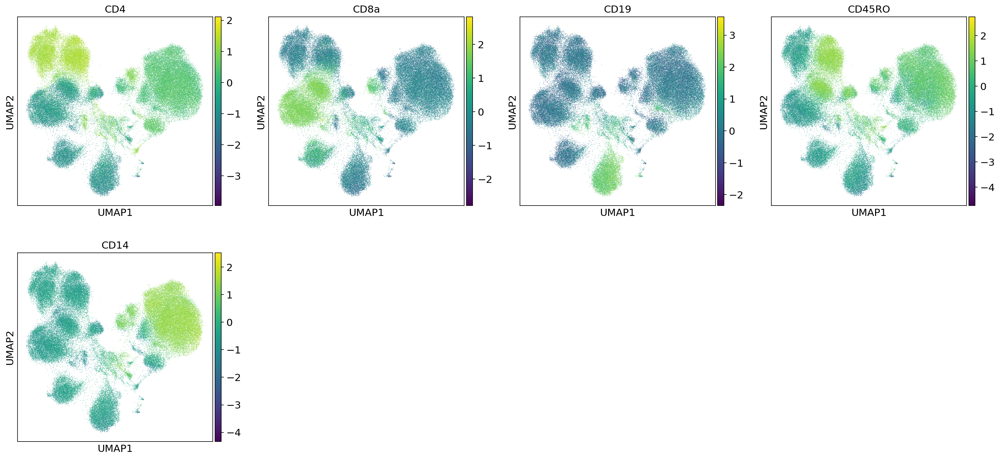

In [1084]:
sc.pl.umap(no_demux_doublets_200k,color =['CD4','CD8a','CD19','CD45RO','CD14'])

In [1066]:
no_demux_doublets_200k.obs

,Batch,DBC,Demuxlet,Type,batch,nCount_ADT,nCount_RNA,nFeature_ADT,nFeature_RNA,n_counts,orig.ident,leiden,umap_density
X3-0,Batch1,3,"donor0,donor1",Doublet,0,984,984,24,24,984.0,SeuratProject,3,0.788769
X6-0,Batch1,6,donor1,Singlet,0,872,872,28,28,872.0,SeuratProject,6,0.109432
X12-0,Batch1,12,donor0,Singlet,0,1083,1083,24,24,1083.0,SeuratProject,6,0.458303
X14-0,Batch1,14,donor1,Doublet,0,1460,1460,25,25,1460.0,SeuratProject,3,0.348534
X17-0,Batch1,17,"donor0,donor1",Doublet,0,1039,1039,23,23,1039.0,SeuratProject,4,0.425562
...,...,...,...,...,...,...,...,...,...,...,...,...,...
X47543.2-9,Batch10,47543,donor0,Doublet,9,536,536,16,16,536.0,SeuratProject,1,0.825825
X47566-9,Batch10,47566,donor1,Singlet,9,3242,3242,28,28,3242.0,SeuratProject,8,0.110020
X47567-9,Batch10,47567,donor1,Singlet,9,863,863,17,17,863.0,SeuratProject,6,0.255199
X47569.2-9,Batch10,47569,donor1,Doublet,9,423,423,20,20,423.0,SeuratProject,9,0.369397


In [1214]:
d0_200k_all = no_demux_doublets_200k[no_demux_doublets_200k.obs['Demuxlet']=='donor0']
d1_200k_all = no_demux_doublets_200k[no_demux_doublets_200k.obs['Demuxlet']=='donor1']

In [1212]:
d0_200k_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['Type']=='Singlet')&(no_demux_doublets_200k.obs['Demuxlet']=='donor0')]
d0_200k_mpl = no_demux_doublets_200k[(no_demux_doublets_200k.obs['Type']=='Doublet')&(no_demux_doublets_200k.obs['Demuxlet']=='donor0')]

In [1213]:
d1_200k_sng = no_demux_doublets_200k[(no_demux_doublets_200k.obs['Type']=='Singlet')&(no_demux_doublets_200k.obs['Demuxlet']=='donor1')]
d1_200k_mpl = no_demux_doublets_200k[(no_demux_doublets_200k.obs['Type']=='Doublet')&(no_demux_doublets_200k.obs['Demuxlet']=='donor1')]

In [1224]:
#donor0 200k all
m_all = d0_200k_all[(d0_200k_all.obs['leiden']=='Monocytes')].shape[0]/(d0_200k_all.obs.shape[0])
cd8n_all = d0_200k_all[(d0_200k_all.obs['leiden']=='CD8 Naive T cells')].shape[0]/d0_200k_all.obs.shape[0]
cd4n_all = d0_200k_all[(d0_200k_all.obs['leiden']=='CD4 Naive T cells')].shape[0]/d0_200k_all.obs.shape[0]
cd4m_all = d0_200k_all[(d0_200k_all.obs['leiden']=='CD4 Memory T cells')].shape[0]/d0_200k_all.obs.shape[0]
b_all = d0_200k_all[(d0_200k_all.obs['leiden']=='B cells')].shape[0]/d0_200k_all.obs.shape[0]
cd8m_all = d0_200k_all[(d0_200k_all.obs['leiden']=='CD8 Memory T cells') ].shape[0]/d0_200k_all.obs.shape[0]
nk_all = d0_200k_all[(d0_200k_all.obs['leiden']=='Natural Killer cells')].shape[0]/d0_200k_all.obs.shape[0]
dbl_all = d0_200k_all[(d0_200k_all.obs['leiden']=='Doublets')].shape[0]/d0_200k_all.obs.shape[0]
cdc_all = d0_200k_all[(d0_200k_all.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/d0_200k_all.obs.shape[0]
gdt_all = d0_200k_all[(d0_200k_all.obs['leiden']=='gd T cells')].shape[0]/d0_200k_all.obs.shape[0]
rbc_all = d0_200k_all[(d0_200k_all.obs['leiden']=='RBCs')].shape[0]/d0_200k_all.obs.shape[0]

d0_200k_all_proportions = [m_all,cd8n_all,cd4n_all,cd4m_all,b_all,cd8m_all,nk_all,dbl_all,cdc_all,gdt_all,rbc_all]

np.sum(d0_200k_all_proportions)



1.0

In [1225]:
#donor1 200k all
m_all = d1_200k_all[(d1_200k_all.obs['leiden']=='Monocytes')].shape[0]/(d1_200k_all.obs.shape[0])
cd8n_all = d1_200k_all[(d1_200k_all.obs['leiden']=='CD8 Naive T cells')].shape[0]/d1_200k_all.obs.shape[0]
cd4n_all = d1_200k_all[(d1_200k_all.obs['leiden']=='CD4 Naive T cells')].shape[0]/d1_200k_all.obs.shape[0]
cd4m_all = d1_200k_all[(d1_200k_all.obs['leiden']=='CD4 Memory T cells')].shape[0]/d1_200k_all.obs.shape[0]
b_all = d1_200k_all[(d1_200k_all.obs['leiden']=='B cells')].shape[0]/d1_200k_all.obs.shape[0]
cd8m_all = d1_200k_all[(d1_200k_all.obs['leiden']=='CD8 Memory T cells') ].shape[0]/d1_200k_all.obs.shape[0]
nk_all = d1_200k_all[(d1_200k_all.obs['leiden']=='Natural Killer cells')].shape[0]/d1_200k_all.obs.shape[0]
dbl_all = d1_200k_all[(d1_200k_all.obs['leiden']=='Doublets')].shape[0]/d1_200k_all.obs.shape[0]
cdc_all = d1_200k_all[(d1_200k_all.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/d1_200k_all.obs.shape[0]
gdt_all = d1_200k_all[(d1_200k_all.obs['leiden']=='gd T cells')].shape[0]/d1_200k_all.obs.shape[0]
rbc_all = d1_200k_all[(d1_200k_all.obs['leiden']=='RBCs')].shape[0]/d1_200k_all.obs.shape[0]

d1_200k_all_proportions = [m_all,cd8n_all,cd4n_all,cd4m_all,b_all,cd8m_all,nk_all,dbl_all,cdc_all,gdt_all,rbc_all]

np.sum(d1_200k_all_proportions)




1.0

In [1216]:
#donor0 200k singlets
m_sng = d0_200k_sng[(d0_200k_sng.obs['leiden']=='Monocytes')].shape[0]/(d0_200k_sng.obs.shape[0])
cd8n_sng = d0_200k_sng[(d0_200k_sng.obs['leiden']=='CD8 Naive T cells')].shape[0]/d0_200k_sng.obs.shape[0]
cd4n_sng = d0_200k_sng[(d0_200k_sng.obs['leiden']=='CD4 Naive T cells')].shape[0]/d0_200k_sng.obs.shape[0]
cd4m_sng = d0_200k_sng[(d0_200k_sng.obs['leiden']=='CD4 Memory T cells')].shape[0]/d0_200k_sng.obs.shape[0]
b_sng = d0_200k_sng[(d0_200k_sng.obs['leiden']=='B cells')].shape[0]/d0_200k_sng.obs.shape[0]
cd8m_sng = d0_200k_sng[(d0_200k_sng.obs['leiden']=='CD8 Memory T cells') ].shape[0]/d0_200k_sng.obs.shape[0]
nk_sng = d0_200k_sng[(d0_200k_sng.obs['leiden']=='Natural Killer cells')].shape[0]/d0_200k_sng.obs.shape[0]
dbl_sng = d0_200k_sng[(d0_200k_sng.obs['leiden']=='Doublets')].shape[0]/d0_200k_sng.obs.shape[0]
cdc_sng = d0_200k_sng[(d0_200k_sng.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/d0_200k_sng.obs.shape[0]
gdt_sng = d0_200k_sng[(d0_200k_sng.obs['leiden']=='gd T cells')].shape[0]/d0_200k_sng.obs.shape[0]
rbc_sng = d0_200k_sng[(d0_200k_sng.obs['leiden']=='RBCs')].shape[0]/d0_200k_sng.obs.shape[0]

d0_200k_sng_proportions = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(d0_200k_sng_proportions)



1.0

In [1221]:
#donor0 200k multiplets
m_mpl = d0_200k_mpl[(d0_200k_mpl.obs['leiden']=='Monocytes')].shape[0]/(d0_200k_mpl.obs.shape[0])
cd8n_mpl = d0_200k_mpl[(d0_200k_mpl.obs['leiden']=='CD8 Naive T cells')].shape[0]/d0_200k_mpl.obs.shape[0]
cd4n_mpl = d0_200k_mpl[(d0_200k_mpl.obs['leiden']=='CD4 Naive T cells')].shape[0]/d0_200k_mpl.obs.shape[0]
cd4m_mpl = d0_200k_mpl[(d0_200k_mpl.obs['leiden']=='CD4 Memory T cells')].shape[0]/d0_200k_mpl.obs.shape[0]
b_mpl = d0_200k_mpl[(d0_200k_mpl.obs['leiden']=='B cells')].shape[0]/d0_200k_mpl.obs.shape[0]
cd8m_mpl = d0_200k_mpl[(d0_200k_mpl.obs['leiden']=='CD8 Memory T cells') ].shape[0]/d0_200k_mpl.obs.shape[0]
nk_mpl = d0_200k_mpl[(d0_200k_mpl.obs['leiden']=='Natural Killer cells')].shape[0]/d0_200k_mpl.obs.shape[0]
dbl_mpl = d0_200k_mpl[(d0_200k_mpl.obs['leiden']=='Doublets')].shape[0]/d0_200k_mpl.obs.shape[0]
cdc_mpl = d0_200k_mpl[(d0_200k_mpl.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/d0_200k_mpl.obs.shape[0]
gdt_mpl = d0_200k_mpl[(d0_200k_mpl.obs['leiden']=='gd T cells')].shape[0]/d0_200k_mpl.obs.shape[0]
rbc_mpl = d0_200k_mpl[(d0_200k_mpl.obs['leiden']=='RBCs')].shape[0]/d0_200k_mpl.obs.shape[0]

d0_200k_mpl_proportions = [m_mpl,cd8n_mpl,cd4n_mpl,cd4m_mpl,b_mpl,cd8m_mpl,nk_mpl,dbl_mpl,cdc_mpl,gdt_mpl,rbc_mpl]

np.sum(d0_200k_mpl_proportions)




1.0

In [1222]:
#donor1 200k singlets
m_sng = d1_200k_sng[(d1_200k_sng.obs['leiden']=='Monocytes')].shape[0]/(d1_200k_sng.obs.shape[0])
cd8n_sng = d1_200k_sng[(d1_200k_sng.obs['leiden']=='CD8 Naive T cells')].shape[0]/d1_200k_sng.obs.shape[0]
cd4n_sng = d1_200k_sng[(d1_200k_sng.obs['leiden']=='CD4 Naive T cells')].shape[0]/d1_200k_sng.obs.shape[0]
cd4m_sng = d1_200k_sng[(d1_200k_sng.obs['leiden']=='CD4 Memory T cells')].shape[0]/d1_200k_sng.obs.shape[0]
b_sng = d1_200k_sng[(d1_200k_sng.obs['leiden']=='B cells')].shape[0]/d1_200k_sng.obs.shape[0]
cd8m_sng = d1_200k_sng[(d1_200k_sng.obs['leiden']=='CD8 Memory T cells') ].shape[0]/d1_200k_sng.obs.shape[0]
nk_sng = d1_200k_sng[(d1_200k_sng.obs['leiden']=='Natural Killer cells')].shape[0]/d1_200k_sng.obs.shape[0]
dbl_sng = d1_200k_sng[(d1_200k_sng.obs['leiden']=='Doublets')].shape[0]/d1_200k_sng.obs.shape[0]
cdc_sng = d1_200k_sng[(d1_200k_sng.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/d1_200k_sng.obs.shape[0]
gdt_sng = d1_200k_sng[(d1_200k_sng.obs['leiden']=='gd T cells')].shape[0]/d1_200k_sng.obs.shape[0]
rbc_sng = d1_200k_sng[(d1_200k_sng.obs['leiden']=='RBCs')].shape[0]/d1_200k_sng.obs.shape[0]

d1_200k_sng_proportions = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(d1_200k_sng_proportions)




0.9999999999999999

In [1223]:
#donor1 200k all cell proportions
m_mpl = d1_200k_mpl[(d1_200k_mpl.obs['leiden']=='Monocytes')].shape[0]/(d1_200k_mpl.obs.shape[0])
cd8n_mpl = d1_200k_mpl[(d1_200k_mpl.obs['leiden']=='CD8 Naive T cells')].shape[0]/d1_200k_mpl.obs.shape[0]
cd4n_mpl = d1_200k_mpl[(d1_200k_mpl.obs['leiden']=='CD4 Naive T cells')].shape[0]/d1_200k_mpl.obs.shape[0]
cd4m_mpl = d1_200k_mpl[(d1_200k_mpl.obs['leiden']=='CD4 Memory T cells')].shape[0]/d1_200k_mpl.obs.shape[0]
b_mpl = d1_200k_mpl[(d1_200k_mpl.obs['leiden']=='B cells')].shape[0]/d1_200k_mpl.obs.shape[0]
cd8m_mpl = d1_200k_mpl[(d1_200k_mpl.obs['leiden']=='CD8 Memory T cells') ].shape[0]/d1_200k_mpl.obs.shape[0]
nk_mpl = d1_200k_mpl[(d1_200k_mpl.obs['leiden']=='Natural Killer cells')].shape[0]/d1_200k_mpl.obs.shape[0]
dbl_mpl = d1_200k_mpl[(d1_200k_mpl.obs['leiden']=='Doublets')].shape[0]/d1_200k_mpl.obs.shape[0]
cdc_mpl = d1_200k_mpl[(d1_200k_mpl.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/d1_200k_mpl.obs.shape[0]
gdt_mpl = d1_200k_mpl[(d1_200k_mpl.obs['leiden']=='gd T cells')].shape[0]/d1_200k_mpl.obs.shape[0]
rbc_mpl = d1_200k_mpl[(d1_200k_mpl.obs['leiden']=='RBCs')].shape[0]/d1_200k_mpl.obs.shape[0]

d1_200k_mpl_proportions = [m_mpl,cd8n_mpl,cd4n_mpl,cd4m_mpl,b_mpl,cd8m_mpl,nk_mpl,dbl_mpl,cdc_mpl,gdt_mpl,rbc_mpl]

np.sum(d1_200k_mpl_proportions)




0.9999999999999999

In [ ]:
d0_200k_all_proportions   cytof_umap_proportions_001

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


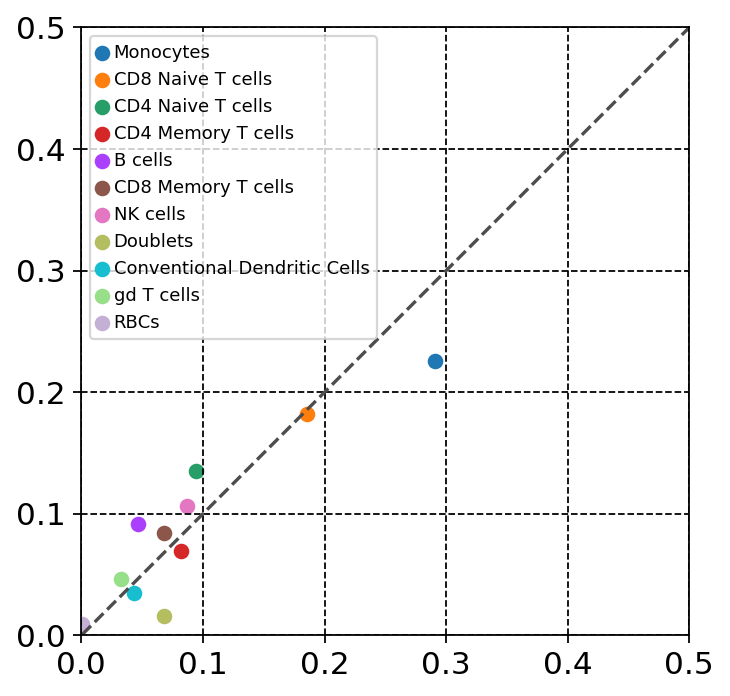

In [1241]:
#200k donor0 all, TMA-001
fig, ax = plt.subplots()

x=d0_200k_all_proportions
y=cytof_umap_proportions_001
xlabel='d0_200k_all'
ylabel='cytof_TMA_001'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


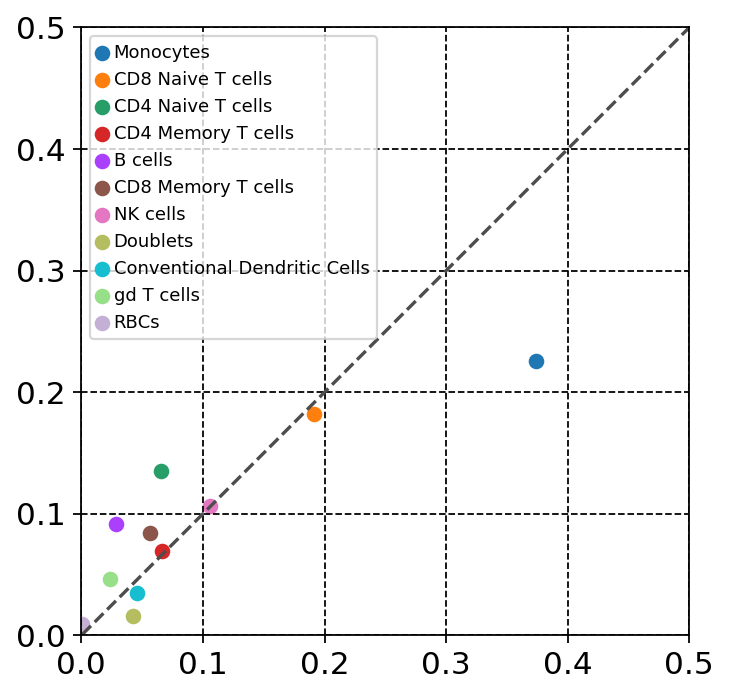

In [1242]:
#200k donor0 sng, TMA-001
fig, ax = plt.subplots()

x=d0_200k_sng_proportions
y=cytof_umap_proportions_001
xlabel='d0_200k_singlets'
ylabel='cytof_TMA_001'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


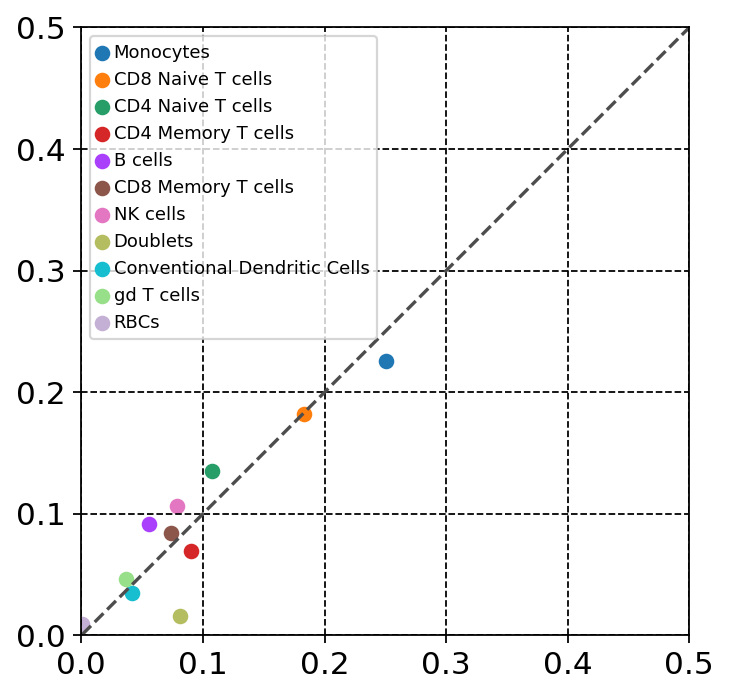

In [1243]:
#200k donor0 mpl, TMA-001
fig, ax = plt.subplots()

x=d0_200k_mpl_proportions
y=cytof_umap_proportions_001
xlabel='d0_200k_multiplets'
ylabel='cytof_TMA_001'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


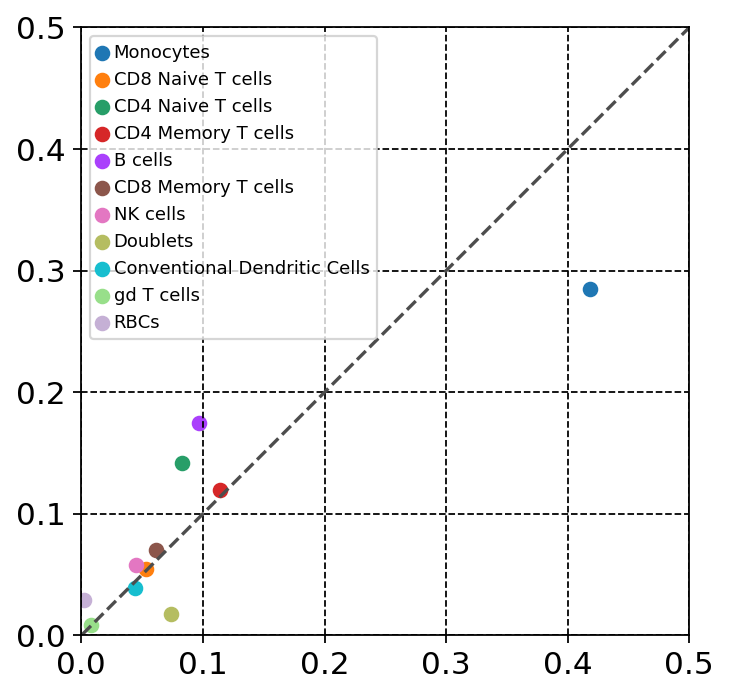

In [1247]:
#200k donor1 all, TMA-003
fig, ax = plt.subplots()

x=d1_200k_all_proportions
y=cytof_umap_proportions_003
xlabel='d1_200k_all'
ylabel='cytof_TMA_003'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


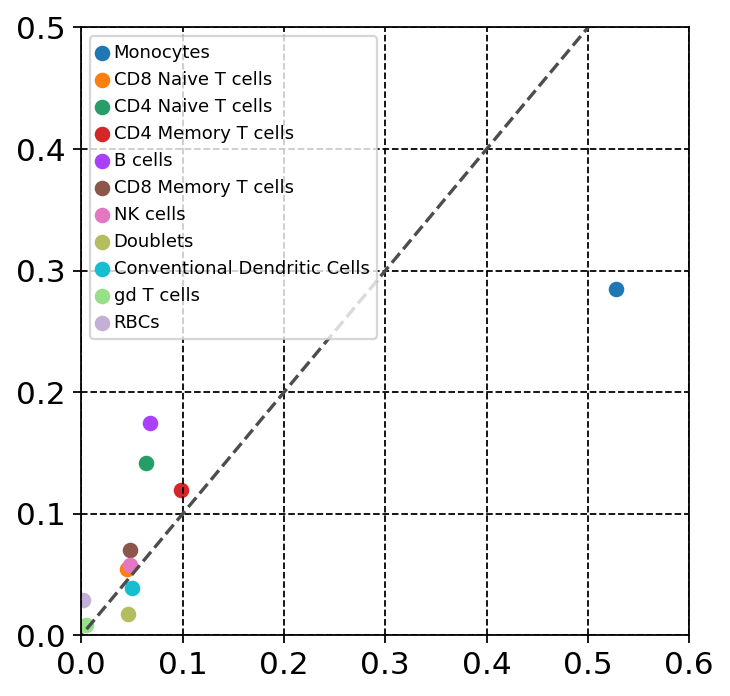

In [1253]:
#200k donor1 sng, TMA-003
fig, ax = plt.subplots()

x=d1_200k_sng_proportions
y=cytof_umap_proportions_003
xlabel='d1_200k_singlets'
ylabel='cytof_TMA_003'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.6))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


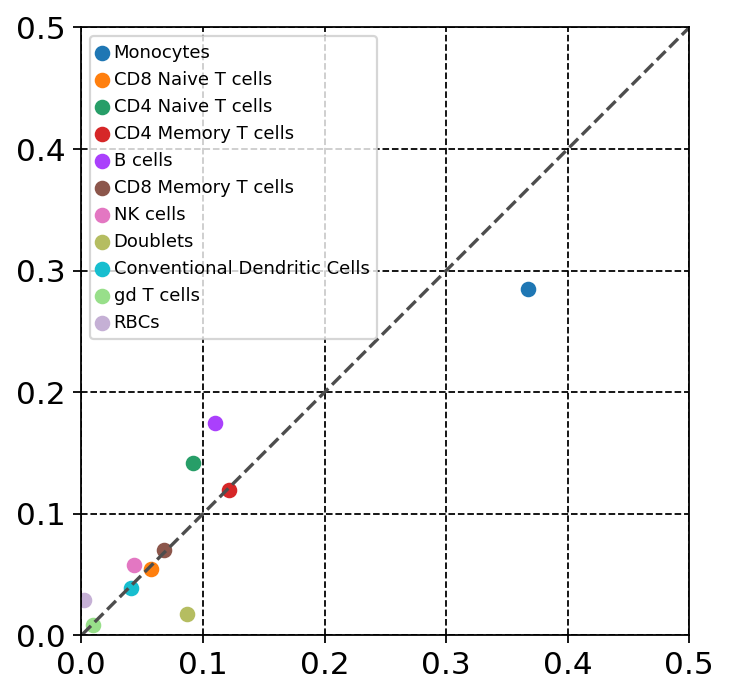

In [1249]:
#200k donor1 mpl, TMA-003
fig, ax = plt.subplots()

x=d1_200k_mpl_proportions
y=cytof_umap_proportions_003
xlabel='d1_200k_multiplets'
ylabel='cytof_TMA_003'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


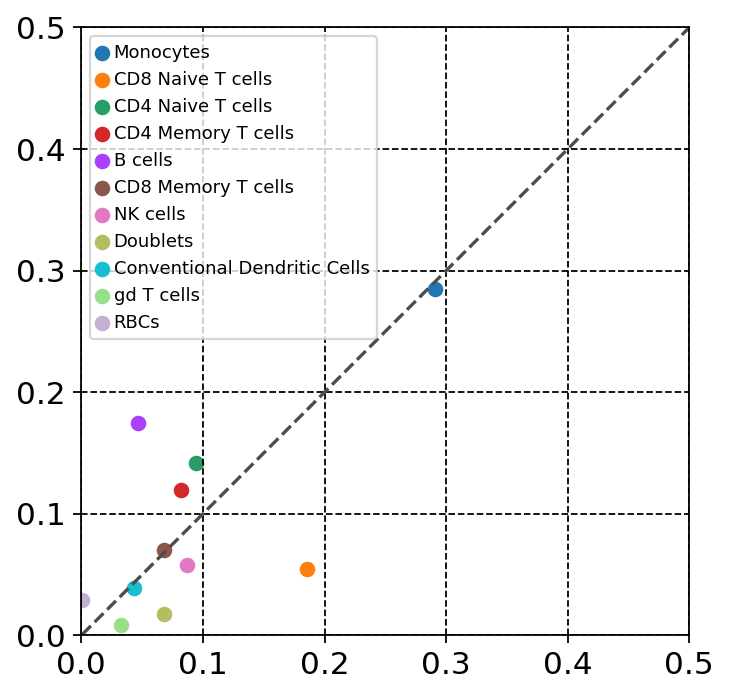

In [1305]:
#200k donor0 all, TMA-003
fig, ax = plt.subplots()

x=d0_200k_all_proportions
y=cytof_umap_proportions_003
xlabel='d0_200k_all'
ylabel='cytof_TMA_003'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


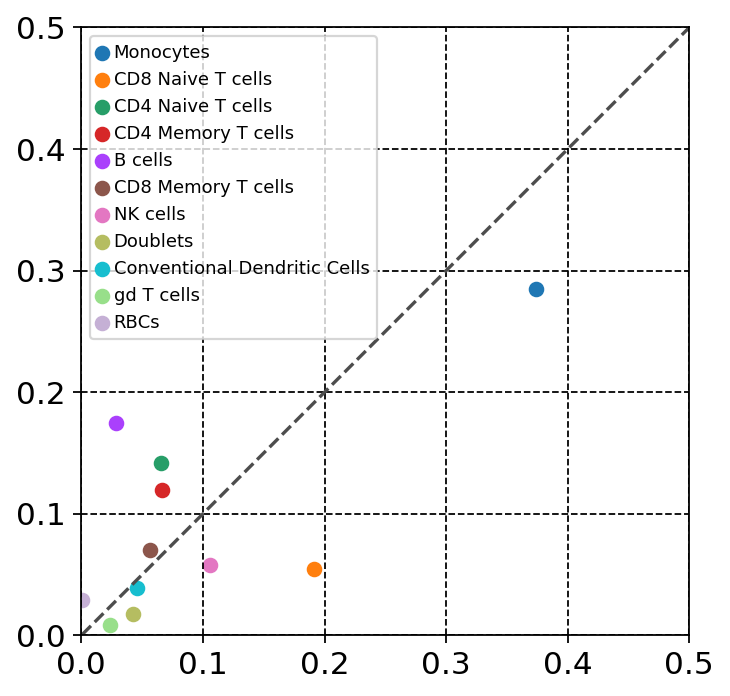

In [1306]:
#200k donor0 sng, TMA-003
fig, ax = plt.subplots()

x=d0_200k_sng_proportions
y=cytof_umap_proportions_003
xlabel='d0_200k_singlets'
ylabel='cytof_TMA_003'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


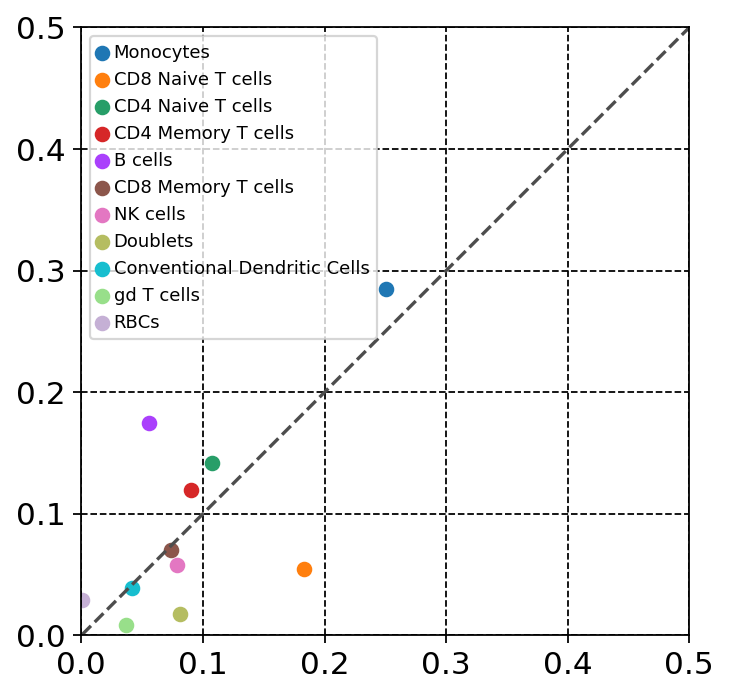

In [1307]:
#200k donor0 mpl, TMA-003
fig, ax = plt.subplots()

x=d0_200k_mpl_proportions
y=cytof_umap_proportions_003
xlabel='d0_200k_multiplets'
ylabel='cytof_TMA_003'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


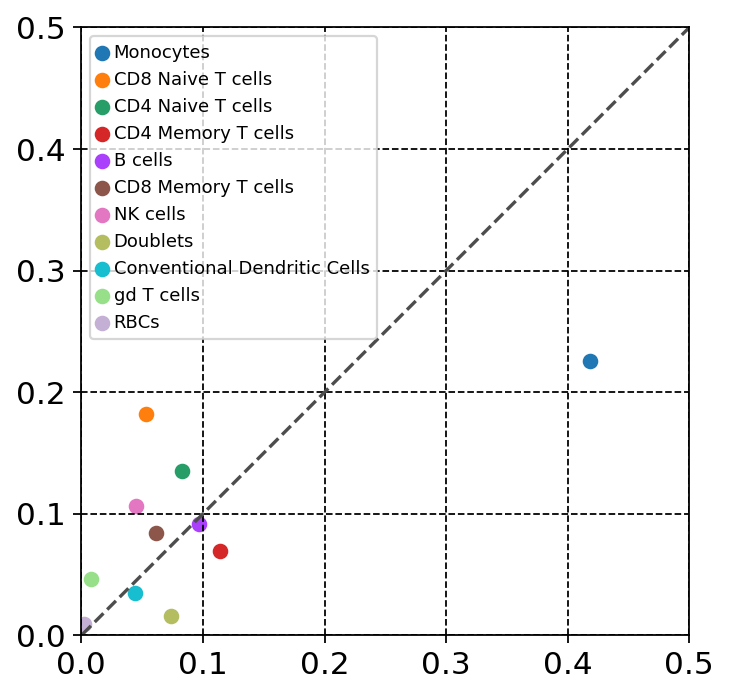

In [1311]:
#200k donor1 all, TMA-001
fig, ax = plt.subplots()

x=d1_200k_all_proportions
y=cytof_umap_proportions_001
xlabel='d1_200k_all'
ylabel='cytof_TMA_001'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


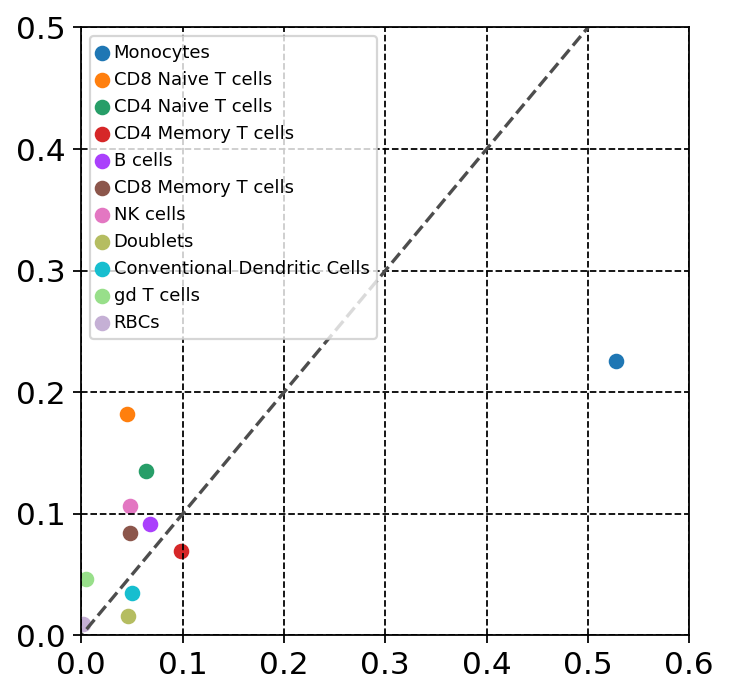

In [1312]:
#200k donor1 sng, TMA-001
fig, ax = plt.subplots()

x=d1_200k_sng_proportions
y=cytof_umap_proportions_001
xlabel='d1_200k_singlets'
ylabel='cytof_TMA_001'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.6))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


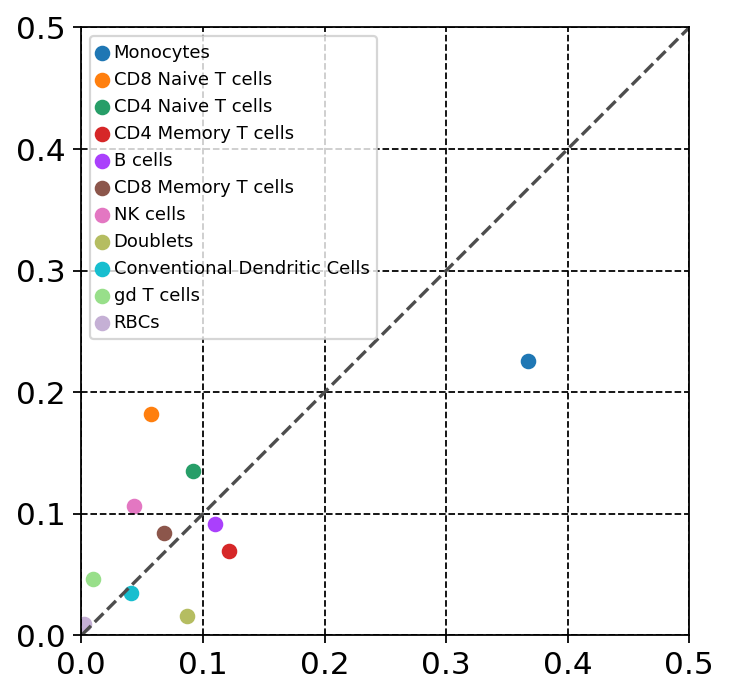

In [1313]:
#200k donor1 mpl, TMA-001
fig, ax = plt.subplots()

x=d1_200k_mpl_proportions
y=cytof_umap_proportions_001
xlabel='d1_200k_multiplets'
ylabel='cytof_TMA_001'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

In [1244]:
stats.pearsonr(d0_200k_all_proportions, cytof_umap_proportions_001)

(0.9083490618447366, 0.00010940630201415221)

In [1245]:
stats.pearsonr(d0_200k_sng_proportions, cytof_umap_proportions_001)

(0.8740039822159776, 0.000435284832086007)

In [1246]:
stats.pearsonr(d0_200k_mpl_proportions, cytof_umap_proportions_001)

(0.9133345017177846, 8.569211906659027e-05)

In [1250]:
stats.pearsonr(d1_200k_all_proportions, cytof_umap_proportions_003)

(0.8824146160437956, 0.00032302486679157335)

In [1251]:
stats.pearsonr(d1_200k_sng_proportions, cytof_umap_proportions_003)

(0.8441396423539611, 0.0010836319522668858)

In [1252]:
stats.pearsonr(d1_200k_mpl_proportions, cytof_umap_proportions_003)

(0.8990040441544345, 0.00016701941705506404)

In [1308]:
stats.pearsonr(d0_200k_all_proportions, cytof_umap_proportions_003)

(0.6898184891543225, 0.018828424421351297)

In [1309]:
stats.pearsonr(d0_200k_sng_proportions, cytof_umap_proportions_003)

(0.6892757417830592, 0.018960493470575927)

In [1310]:
stats.pearsonr(d0_200k_mpl_proportions, cytof_umap_proportions_003)

(0.6747653849749132, 0.022742073047860932)

In [1314]:
stats.pearsonr(d1_200k_all_proportions, cytof_umap_proportions_001)

(0.6983674981632857, 0.016833867971322004)

In [1315]:
stats.pearsonr(d1_200k_sng_proportions, cytof_umap_proportions_001)

(0.6941162173793062, 0.017805749346478668)

In [1316]:
stats.pearsonr(d1_200k_mpl_proportions, cytof_umap_proportions_001)

(0.6933507889304339, 0.017984906090452214)

In [ ]:
# 100K no demux doublets

In [1261]:
no_demux_doublets_100k = per_batch_norm_from_R_adata[(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0')|(per_batch_norm_from_R_adata.obs['Demuxlet']=='donor1')|((per_batch_norm_from_R_adata.obs['Demuxlet']=='donor0,donor1')&(per_batch_norm_from_R_adata.obs['Type']=='Doublet'))]


In [1262]:
sc.tl.pca(no_demux_doublets_100k, svd_solver='arpack', use_highly_variable=None)
sc.pp.neighbors(no_demux_doublets_100k, n_neighbors=10, n_pcs=15)
sc.tl.umap(no_demux_doublets_100k)
sc.tl.leiden(no_demux_doublets_100k)

/wynton/home/ye/davidslee/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../home/ye/davidslee/anaconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


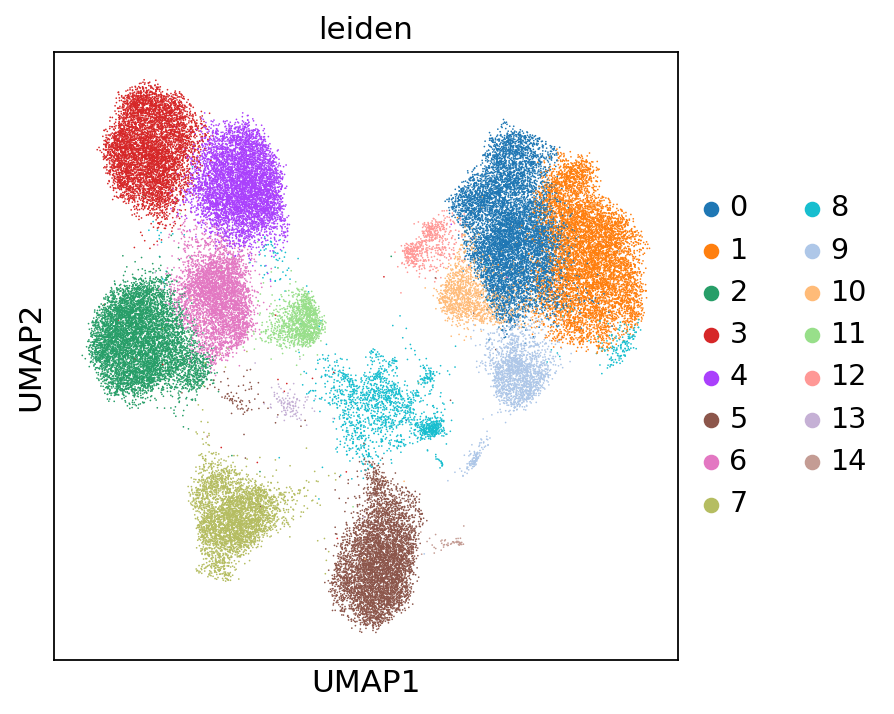

In [1263]:
sc.pl.umap(no_demux_doublets_100k,color = 'leiden')

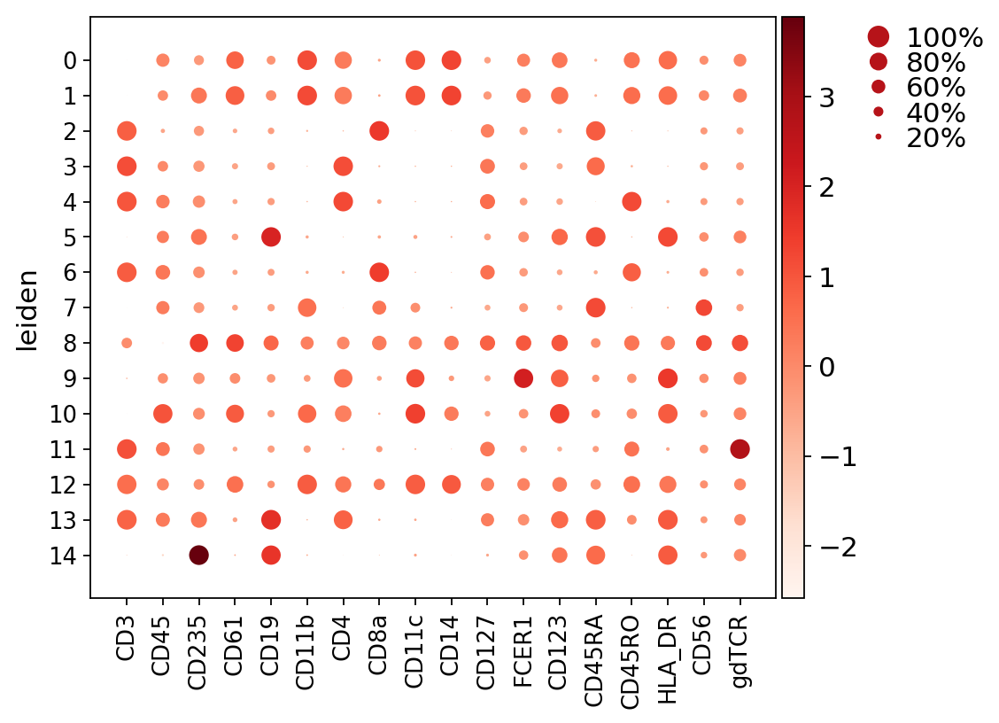

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[6.3, 0, 0.2, 0.5, 0.25])

In [1264]:
sc.pl.dotplot(no_demux_doublets_100k, groupby = 'leiden', var_names = ['CD3','CD45','CD235','CD61','CD19','CD11b','CD4','CD8a','CD11c','CD14','CD127', 'FCER1','CD123', 'CD45RA','CD45RO', 'HLA_DR','CD56','gdTCR'])


In [1266]:
new_cluster_names = ['Monocytes','Monocytes-2','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'Natural Killer cells','Doublets','Conventional Dendritic Cells','Monocytes-3',
                     'gd T cells','Doublets-2','Doublets-3','RBCs']
no_demux_doublets_100k.rename_categories('leiden', new_cluster_names)

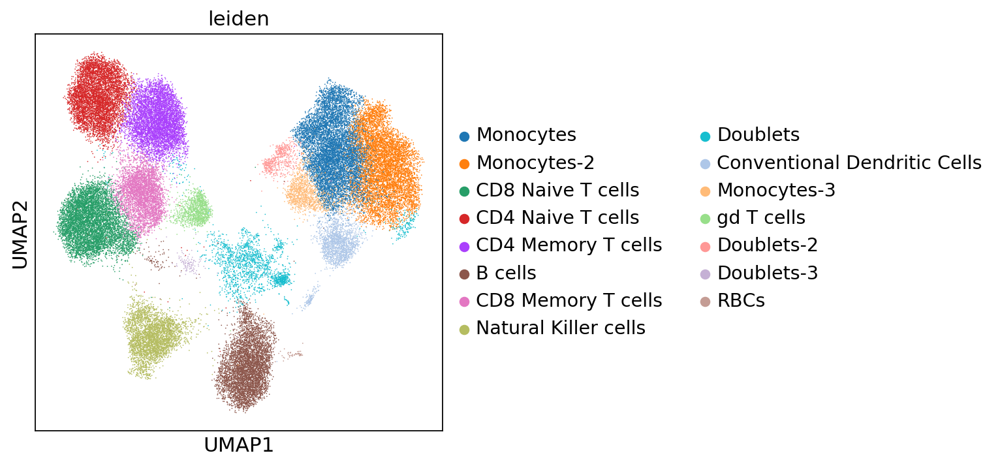

In [1267]:
sc.pl.umap(no_demux_doublets_100k, color = 'leiden', save='100k_1_resolution_leiden.png')

In [1268]:
#combine clusters
no_demux_doublets_100k.obs['leiden']=no_demux_doublets_100k.obs['leiden'].where(no_demux_doublets_100k.obs['leiden']!='Monocytes-2','Monocytes')
no_demux_doublets_100k.obs['leiden']=no_demux_doublets_100k.obs['leiden'].where(no_demux_doublets_100k.obs['leiden']!='Monocytes-3','Monocytes')

no_demux_doublets_100k.obs['leiden']=no_demux_doublets_100k.obs['leiden'].where(no_demux_doublets_100k.obs['leiden']!='Doublets-2','Doublets')
no_demux_doublets_100k.obs['leiden']=no_demux_doublets_100k.obs['leiden'].where(no_demux_doublets_100k.obs['leiden']!='Doublets-3','Doublets')




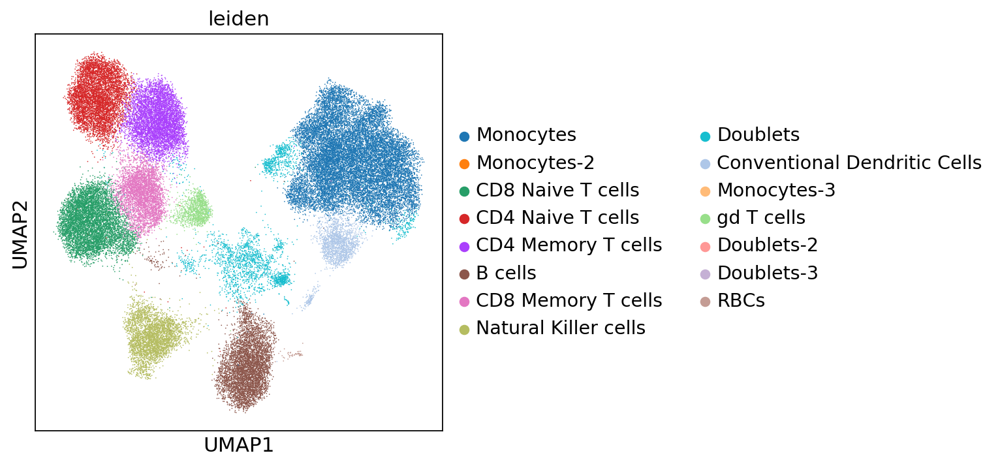

In [1269]:
sc.pl.umap(no_demux_doublets_100k, color = 'leiden', save='100k_1_resolution_leiden_merged.png')

In [1270]:
#donor0 100k all cell proportions
m_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['leiden']=='Monocytes')].shape[0]/(no_demux_doublets_100k.obs.shape[0])
cd8n_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['leiden']=='CD8 Naive T cells')].shape[0]/no_demux_doublets_100k.obs.shape[0]
cd4n_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['leiden']=='CD4 Naive T cells')].shape[0]/no_demux_doublets_100k.obs.shape[0]
cd4m_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['leiden']=='CD4 Memory T cells')].shape[0]/no_demux_doublets_100k.obs.shape[0]
b_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['leiden']=='B cells')].shape[0]/no_demux_doublets_100k.obs.shape[0]
cd8m_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['leiden']=='CD8 Memory T cells') ].shape[0]/no_demux_doublets_100k.obs.shape[0]
nk_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['leiden']=='Natural Killer cells')].shape[0]/no_demux_doublets_100k.obs.shape[0]
dbl_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['leiden']=='Doublets')].shape[0]/no_demux_doublets_100k.obs.shape[0]
cdc_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/no_demux_doublets_100k.obs.shape[0]
gdt_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['leiden']=='gd T cells')].shape[0]/no_demux_doublets_100k.obs.shape[0]
rbc_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['leiden']=='RBCs')].shape[0]/no_demux_doublets_100k.obs.shape[0]

no_demux_doublets_100k_proportions = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(no_demux_doublets_100k_proportions)


1.0

In [1271]:
no_demux_doublets_100k_proportions

[0.3088503996954701,
 0.126798629615531,
 0.10905976398934146,
 0.10624286258089075,
 0.09851541682527598,
 0.07379139703083365,
 0.06937571374191093,
 0.05007613247049867,
 0.03385991625428245,
 0.022516178149980966,
 0.0009135896459840122]

In [1272]:
d0_100k_all = no_demux_doublets_100k[no_demux_doublets_100k.obs['Demuxlet']=='donor0']
d1_100k_all = no_demux_doublets_100k[no_demux_doublets_100k.obs['Demuxlet']=='donor1']

In [1273]:
d0_100k_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['Type']=='Singlet')&(no_demux_doublets_100k.obs['Demuxlet']=='donor0')]
d0_100k_mpl = no_demux_doublets_100k[(no_demux_doublets_100k.obs['Type']=='Doublet')&(no_demux_doublets_100k.obs['Demuxlet']=='donor0')]

In [1274]:
d1_100k_sng = no_demux_doublets_100k[(no_demux_doublets_100k.obs['Type']=='Singlet')&(no_demux_doublets_100k.obs['Demuxlet']=='donor1')]
d1_100k_mpl = no_demux_doublets_100k[(no_demux_doublets_100k.obs['Type']=='Doublet')&(no_demux_doublets_100k.obs['Demuxlet']=='donor1')]

In [1275]:
#donor0 100k all
m_all = d0_100k_all[(d0_100k_all.obs['leiden']=='Monocytes')].shape[0]/(d0_100k_all.obs.shape[0])
cd8n_all = d0_100k_all[(d0_100k_all.obs['leiden']=='CD8 Naive T cells')].shape[0]/d0_100k_all.obs.shape[0]
cd4n_all = d0_100k_all[(d0_100k_all.obs['leiden']=='CD4 Naive T cells')].shape[0]/d0_100k_all.obs.shape[0]
cd4m_all = d0_100k_all[(d0_100k_all.obs['leiden']=='CD4 Memory T cells')].shape[0]/d0_100k_all.obs.shape[0]
b_all = d0_100k_all[(d0_100k_all.obs['leiden']=='B cells')].shape[0]/d0_100k_all.obs.shape[0]
cd8m_all = d0_100k_all[(d0_100k_all.obs['leiden']=='CD8 Memory T cells') ].shape[0]/d0_100k_all.obs.shape[0]
nk_all = d0_100k_all[(d0_100k_all.obs['leiden']=='Natural Killer cells')].shape[0]/d0_100k_all.obs.shape[0]
dbl_all = d0_100k_all[(d0_100k_all.obs['leiden']=='Doublets')].shape[0]/d0_100k_all.obs.shape[0]
cdc_all = d0_100k_all[(d0_100k_all.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/d0_100k_all.obs.shape[0]
gdt_all = d0_100k_all[(d0_100k_all.obs['leiden']=='gd T cells')].shape[0]/d0_100k_all.obs.shape[0]
rbc_all = d0_100k_all[(d0_100k_all.obs['leiden']=='RBCs')].shape[0]/d0_100k_all.obs.shape[0]

d0_100k_all_proportions = [m_all,cd8n_all,cd4n_all,cd4m_all,b_all,cd8m_all,nk_all,dbl_all,cdc_all,gdt_all,rbc_all]

np.sum(d0_100k_all_proportions)



1.0

In [1276]:
#donor1 100k all
m_all = d1_100k_all[(d1_100k_all.obs['leiden']=='Monocytes')].shape[0]/(d1_100k_all.obs.shape[0])
cd8n_all = d1_100k_all[(d1_100k_all.obs['leiden']=='CD8 Naive T cells')].shape[0]/d1_100k_all.obs.shape[0]
cd4n_all = d1_100k_all[(d1_100k_all.obs['leiden']=='CD4 Naive T cells')].shape[0]/d1_100k_all.obs.shape[0]
cd4m_all = d1_100k_all[(d1_100k_all.obs['leiden']=='CD4 Memory T cells')].shape[0]/d1_100k_all.obs.shape[0]
b_all = d1_100k_all[(d1_100k_all.obs['leiden']=='B cells')].shape[0]/d1_100k_all.obs.shape[0]
cd8m_all = d1_100k_all[(d1_100k_all.obs['leiden']=='CD8 Memory T cells') ].shape[0]/d1_100k_all.obs.shape[0]
nk_all = d1_100k_all[(d1_100k_all.obs['leiden']=='Natural Killer cells')].shape[0]/d1_100k_all.obs.shape[0]
dbl_all = d1_100k_all[(d1_100k_all.obs['leiden']=='Doublets')].shape[0]/d1_100k_all.obs.shape[0]
cdc_all = d1_100k_all[(d1_100k_all.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/d1_100k_all.obs.shape[0]
gdt_all = d1_100k_all[(d1_100k_all.obs['leiden']=='gd T cells')].shape[0]/d1_100k_all.obs.shape[0]
rbc_all = d1_100k_all[(d1_100k_all.obs['leiden']=='RBCs')].shape[0]/d1_100k_all.obs.shape[0]

d1_100k_all_proportions = [m_all,cd8n_all,cd4n_all,cd4m_all,b_all,cd8m_all,nk_all,dbl_all,cdc_all,gdt_all,rbc_all]

np.sum(d1_100k_all_proportions)




1.0

In [1277]:
#donor0 100k singlets
m_sng = d0_100k_sng[(d0_100k_sng.obs['leiden']=='Monocytes')].shape[0]/(d0_100k_sng.obs.shape[0])
cd8n_sng = d0_100k_sng[(d0_100k_sng.obs['leiden']=='CD8 Naive T cells')].shape[0]/d0_100k_sng.obs.shape[0]
cd4n_sng = d0_100k_sng[(d0_100k_sng.obs['leiden']=='CD4 Naive T cells')].shape[0]/d0_100k_sng.obs.shape[0]
cd4m_sng = d0_100k_sng[(d0_100k_sng.obs['leiden']=='CD4 Memory T cells')].shape[0]/d0_100k_sng.obs.shape[0]
b_sng = d0_100k_sng[(d0_100k_sng.obs['leiden']=='B cells')].shape[0]/d0_100k_sng.obs.shape[0]
cd8m_sng = d0_100k_sng[(d0_100k_sng.obs['leiden']=='CD8 Memory T cells') ].shape[0]/d0_100k_sng.obs.shape[0]
nk_sng = d0_100k_sng[(d0_100k_sng.obs['leiden']=='Natural Killer cells')].shape[0]/d0_100k_sng.obs.shape[0]
dbl_sng = d0_100k_sng[(d0_100k_sng.obs['leiden']=='Doublets')].shape[0]/d0_100k_sng.obs.shape[0]
cdc_sng = d0_100k_sng[(d0_100k_sng.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/d0_100k_sng.obs.shape[0]
gdt_sng = d0_100k_sng[(d0_100k_sng.obs['leiden']=='gd T cells')].shape[0]/d0_100k_sng.obs.shape[0]
rbc_sng = d0_100k_sng[(d0_100k_sng.obs['leiden']=='RBCs')].shape[0]/d0_100k_sng.obs.shape[0]

d0_100k_sng_proportions = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(d0_100k_sng_proportions)



1.0

In [1278]:
#donor0 100k multiplets
m_mpl = d0_100k_mpl[(d0_100k_mpl.obs['leiden']=='Monocytes')].shape[0]/(d0_100k_mpl.obs.shape[0])
cd8n_mpl = d0_100k_mpl[(d0_100k_mpl.obs['leiden']=='CD8 Naive T cells')].shape[0]/d0_100k_mpl.obs.shape[0]
cd4n_mpl = d0_100k_mpl[(d0_100k_mpl.obs['leiden']=='CD4 Naive T cells')].shape[0]/d0_100k_mpl.obs.shape[0]
cd4m_mpl = d0_100k_mpl[(d0_100k_mpl.obs['leiden']=='CD4 Memory T cells')].shape[0]/d0_100k_mpl.obs.shape[0]
b_mpl = d0_100k_mpl[(d0_100k_mpl.obs['leiden']=='B cells')].shape[0]/d0_100k_mpl.obs.shape[0]
cd8m_mpl = d0_100k_mpl[(d0_100k_mpl.obs['leiden']=='CD8 Memory T cells') ].shape[0]/d0_100k_mpl.obs.shape[0]
nk_mpl = d0_100k_mpl[(d0_100k_mpl.obs['leiden']=='Natural Killer cells')].shape[0]/d0_100k_mpl.obs.shape[0]
dbl_mpl = d0_100k_mpl[(d0_100k_mpl.obs['leiden']=='Doublets')].shape[0]/d0_100k_mpl.obs.shape[0]
cdc_mpl = d0_100k_mpl[(d0_100k_mpl.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/d0_100k_mpl.obs.shape[0]
gdt_mpl = d0_100k_mpl[(d0_100k_mpl.obs['leiden']=='gd T cells')].shape[0]/d0_100k_mpl.obs.shape[0]
rbc_mpl = d0_100k_mpl[(d0_100k_mpl.obs['leiden']=='RBCs')].shape[0]/d0_100k_mpl.obs.shape[0]

d0_100k_mpl_proportions = [m_mpl,cd8n_mpl,cd4n_mpl,cd4m_mpl,b_mpl,cd8m_mpl,nk_mpl,dbl_mpl,cdc_mpl,gdt_mpl,rbc_mpl]

np.sum(d0_100k_mpl_proportions)




1.0

In [1279]:
#donor1 100k singlets
m_sng = d1_100k_sng[(d1_100k_sng.obs['leiden']=='Monocytes')].shape[0]/(d1_100k_sng.obs.shape[0])
cd8n_sng = d1_100k_sng[(d1_100k_sng.obs['leiden']=='CD8 Naive T cells')].shape[0]/d1_100k_sng.obs.shape[0]
cd4n_sng = d1_100k_sng[(d1_100k_sng.obs['leiden']=='CD4 Naive T cells')].shape[0]/d1_100k_sng.obs.shape[0]
cd4m_sng = d1_100k_sng[(d1_100k_sng.obs['leiden']=='CD4 Memory T cells')].shape[0]/d1_100k_sng.obs.shape[0]
b_sng = d1_100k_sng[(d1_100k_sng.obs['leiden']=='B cells')].shape[0]/d1_100k_sng.obs.shape[0]
cd8m_sng = d1_100k_sng[(d1_100k_sng.obs['leiden']=='CD8 Memory T cells') ].shape[0]/d1_100k_sng.obs.shape[0]
nk_sng = d1_100k_sng[(d1_100k_sng.obs['leiden']=='Natural Killer cells')].shape[0]/d1_100k_sng.obs.shape[0]
dbl_sng = d1_100k_sng[(d1_100k_sng.obs['leiden']=='Doublets')].shape[0]/d1_100k_sng.obs.shape[0]
cdc_sng = d1_100k_sng[(d1_100k_sng.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/d1_100k_sng.obs.shape[0]
gdt_sng = d1_100k_sng[(d1_100k_sng.obs['leiden']=='gd T cells')].shape[0]/d1_100k_sng.obs.shape[0]
rbc_sng = d1_100k_sng[(d1_100k_sng.obs['leiden']=='RBCs')].shape[0]/d1_100k_sng.obs.shape[0]

d1_100k_sng_proportions = [m_sng,cd8n_sng,cd4n_sng,cd4m_sng,b_sng,cd8m_sng,nk_sng,dbl_sng,cdc_sng,gdt_sng,rbc_sng]

np.sum(d1_100k_sng_proportions)




1.0

In [1280]:
#donor1 100k all cell proportions
m_mpl = d1_100k_mpl[(d1_100k_mpl.obs['leiden']=='Monocytes')].shape[0]/(d1_100k_mpl.obs.shape[0])
cd8n_mpl = d1_100k_mpl[(d1_100k_mpl.obs['leiden']=='CD8 Naive T cells')].shape[0]/d1_100k_mpl.obs.shape[0]
cd4n_mpl = d1_100k_mpl[(d1_100k_mpl.obs['leiden']=='CD4 Naive T cells')].shape[0]/d1_100k_mpl.obs.shape[0]
cd4m_mpl = d1_100k_mpl[(d1_100k_mpl.obs['leiden']=='CD4 Memory T cells')].shape[0]/d1_100k_mpl.obs.shape[0]
b_mpl = d1_100k_mpl[(d1_100k_mpl.obs['leiden']=='B cells')].shape[0]/d1_100k_mpl.obs.shape[0]
cd8m_mpl = d1_100k_mpl[(d1_100k_mpl.obs['leiden']=='CD8 Memory T cells') ].shape[0]/d1_100k_mpl.obs.shape[0]
nk_mpl = d1_100k_mpl[(d1_100k_mpl.obs['leiden']=='Natural Killer cells')].shape[0]/d1_100k_mpl.obs.shape[0]
dbl_mpl = d1_100k_mpl[(d1_100k_mpl.obs['leiden']=='Doublets')].shape[0]/d1_100k_mpl.obs.shape[0]
cdc_mpl = d1_100k_mpl[(d1_100k_mpl.obs['leiden']=='Conventional Dendritic Cells')].shape[0]/d1_100k_mpl.obs.shape[0]
gdt_mpl = d1_100k_mpl[(d1_100k_mpl.obs['leiden']=='gd T cells')].shape[0]/d1_100k_mpl.obs.shape[0]
rbc_mpl = d1_100k_mpl[(d1_100k_mpl.obs['leiden']=='RBCs')].shape[0]/d1_100k_mpl.obs.shape[0]

d1_100k_mpl_proportions = [m_mpl,cd8n_mpl,cd4n_mpl,cd4m_mpl,b_mpl,cd8m_mpl,nk_mpl,dbl_mpl,cdc_mpl,gdt_mpl,rbc_mpl]

np.sum(d1_100k_mpl_proportions)




1.0

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


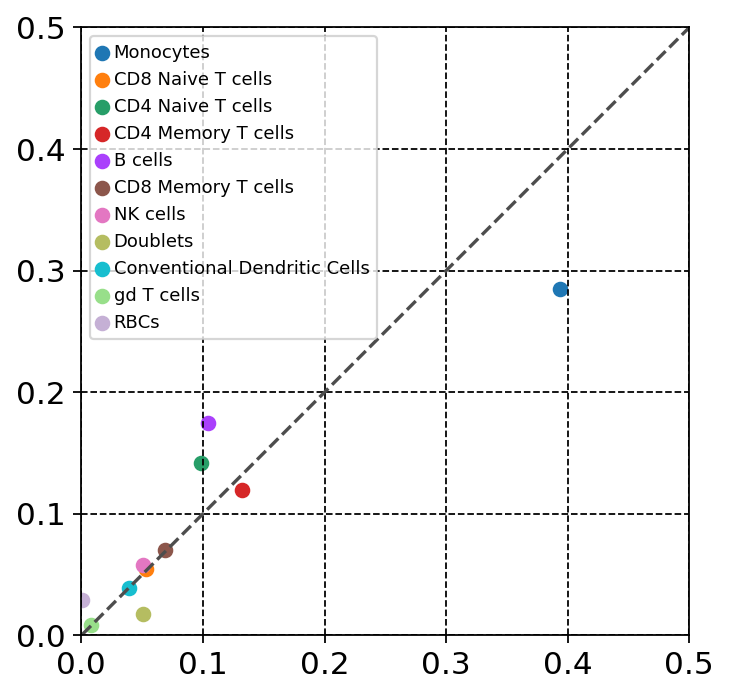

In [1293]:
#100k donor0 all, TMA-003
fig, ax = plt.subplots()

x=d0_100k_all_proportions
y=cytof_umap_proportions_003
xlabel='d0_100k_all'
ylabel='cytof_TMA_003'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


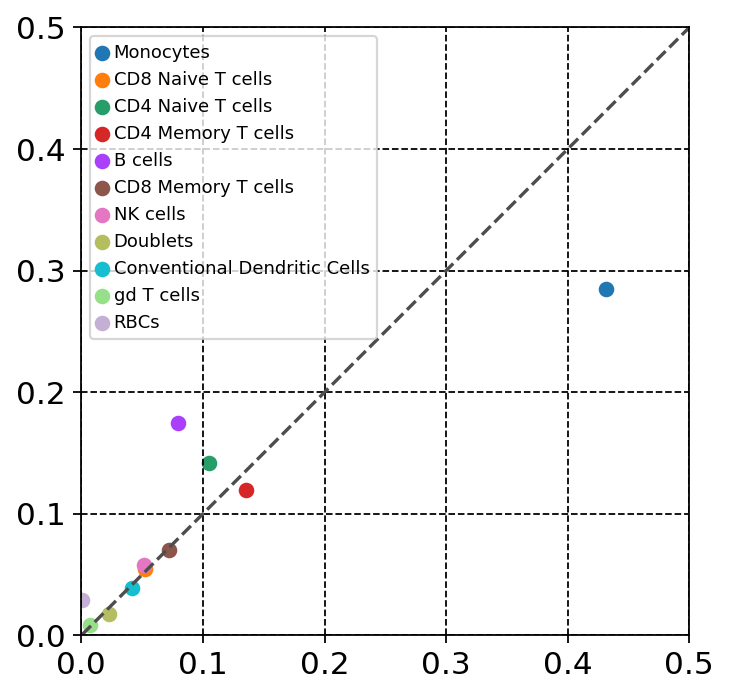

In [1294]:
#100k donor0 sng, TMA-003
fig, ax = plt.subplots()

x=d0_100k_sng_proportions
y=cytof_umap_proportions_003
xlabel='d0_100k_singlets'
ylabel='cytof_TMA_003'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


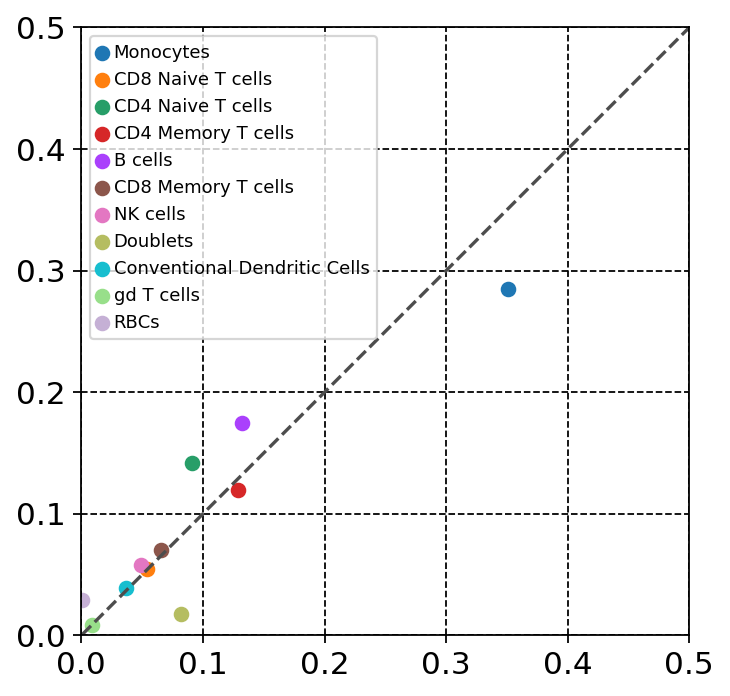

In [1295]:
#100k donor0 mpl, TMA-003
fig, ax = plt.subplots()

x=d0_100k_mpl_proportions
y=cytof_umap_proportions_003
xlabel='d0_100k_multiplets'
ylabel='cytof_TMA_003'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


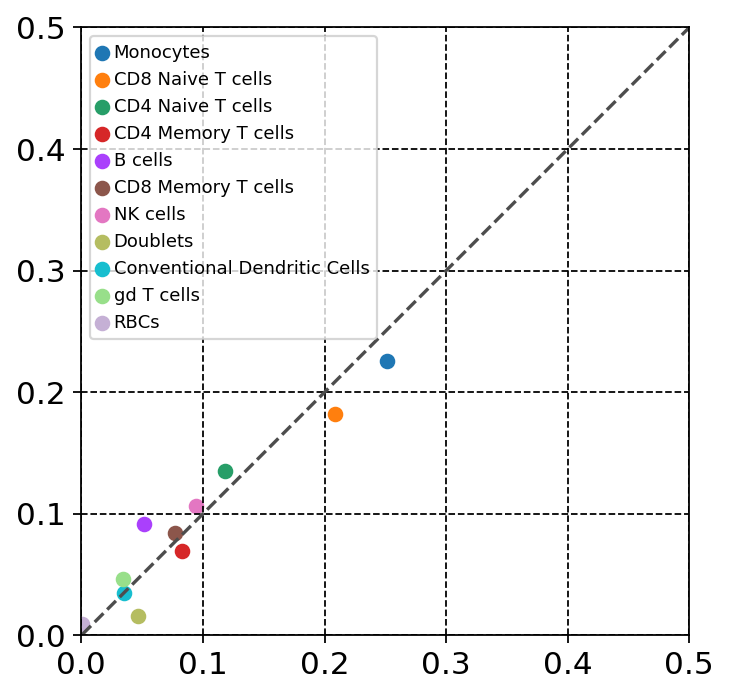

In [1299]:
#100k donor1 all, TMA-001
fig, ax = plt.subplots()

x=d1_100k_all_proportions
y=cytof_umap_proportions_001
xlabel='d1_100k_all'
ylabel='cytof_TMA_001'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


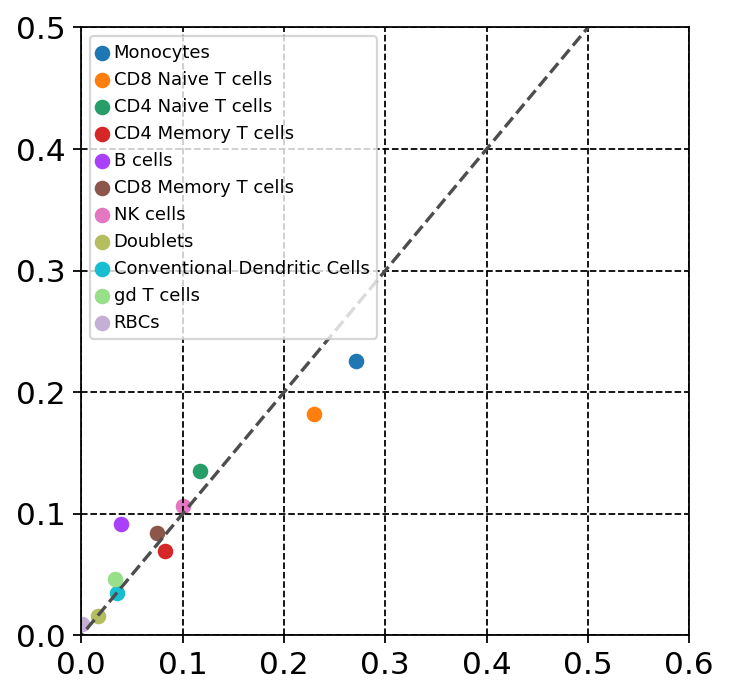

In [1300]:
#100k donor1 sng, TMA-001
fig, ax = plt.subplots()

x=d1_100k_sng_proportions
y=cytof_umap_proportions_001
xlabel='d1_100k_singlets'
ylabel='cytof_TMA_001'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.6))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


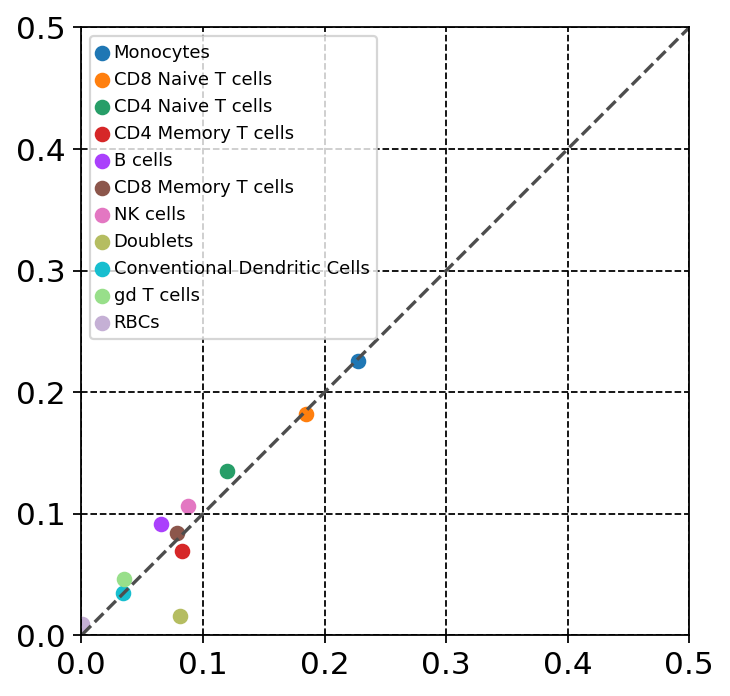

In [1301]:
#100k donor1 mpl, TMA-001
fig, ax = plt.subplots()

x=d1_100k_mpl_proportions
y=cytof_umap_proportions_001
xlabel='d1_100k_multiplets'
ylabel='cytof_TMA_001'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


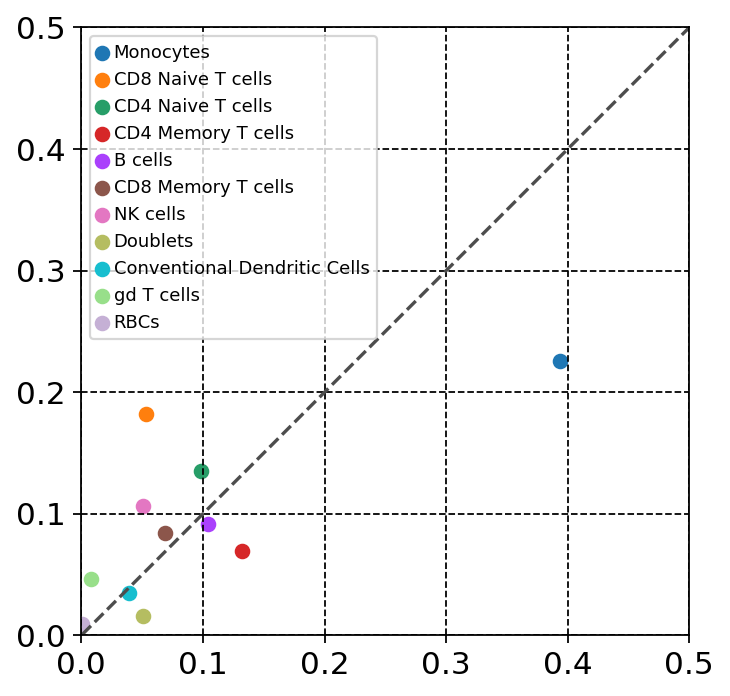

In [1281]:
#100k donor0 all, TMA-001
fig, ax = plt.subplots()

x=d0_100k_all_proportions
y=cytof_umap_proportions_001
xlabel='d0_100k_all'
ylabel='cytof_TMA_001'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


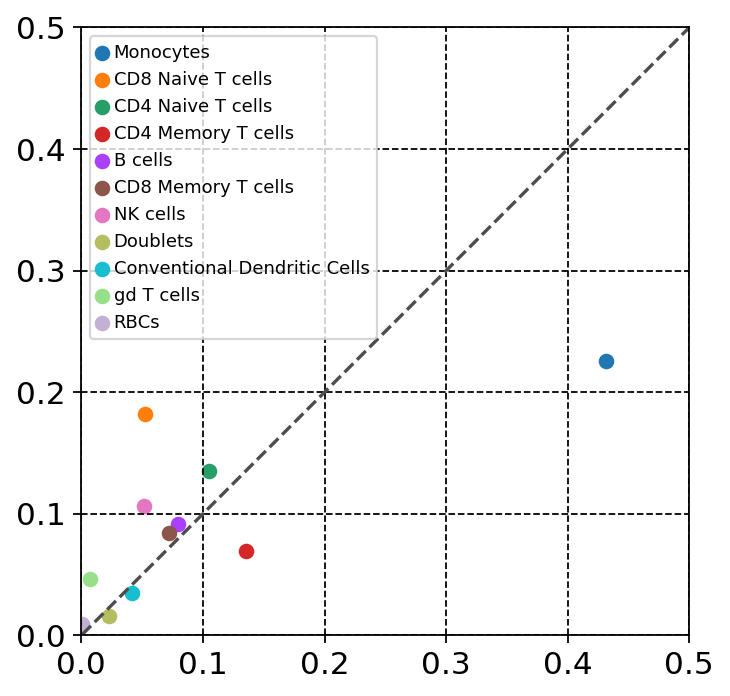

In [1282]:
#100k donor0 sng, TMA-001
fig, ax = plt.subplots()

x=d0_100k_sng_proportions
y=cytof_umap_proportions_001
xlabel='d0_100k_singlets'
ylabel='cytof_TMA_001'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


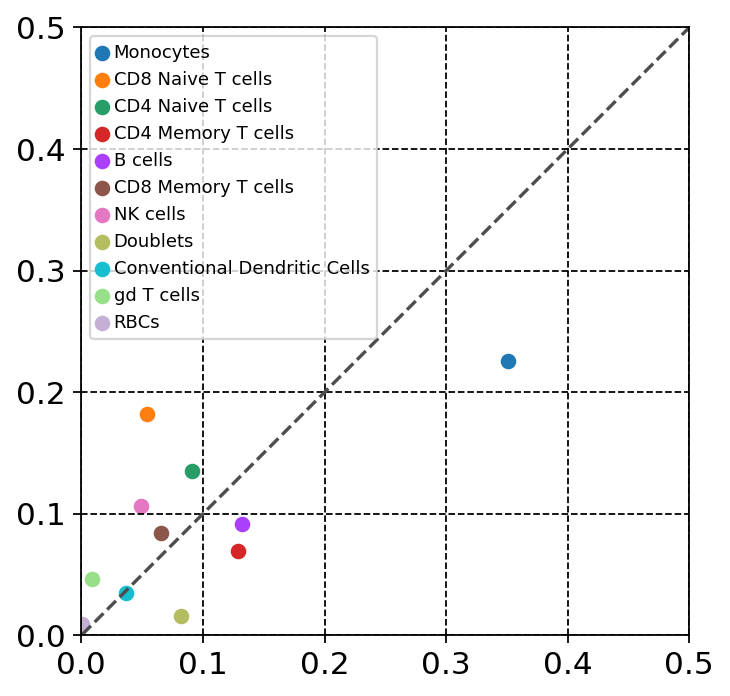

In [1283]:
#100k donor0 mpl, TMA-001
fig, ax = plt.subplots()

x=d0_100k_mpl_proportions
y=cytof_umap_proportions_001
xlabel='d0_100k_multiplets'
ylabel='cytof_TMA_001'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


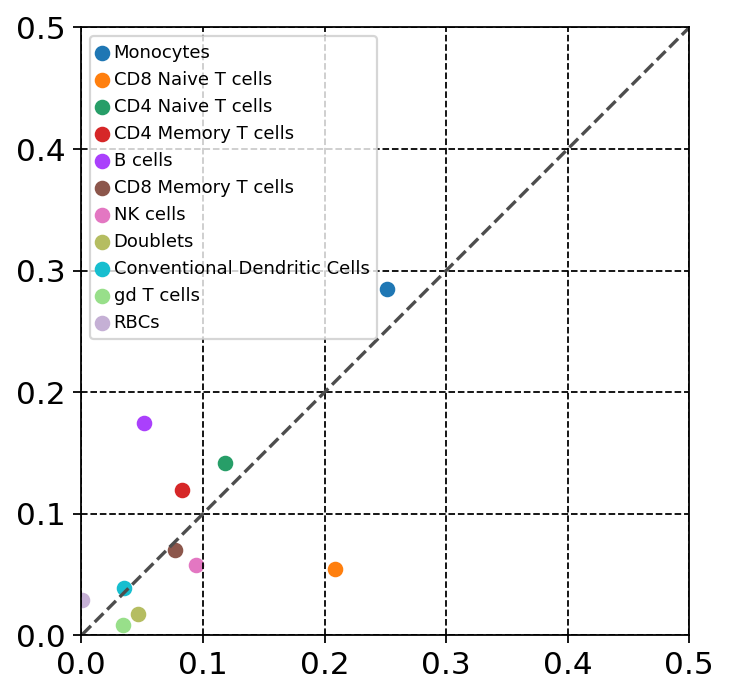

In [1287]:
#100k donor1 all, TMA-003
fig, ax = plt.subplots()

x=d1_100k_all_proportions
y=cytof_umap_proportions_003
xlabel='d1_100k_all'
ylabel='cytof_TMA_003'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


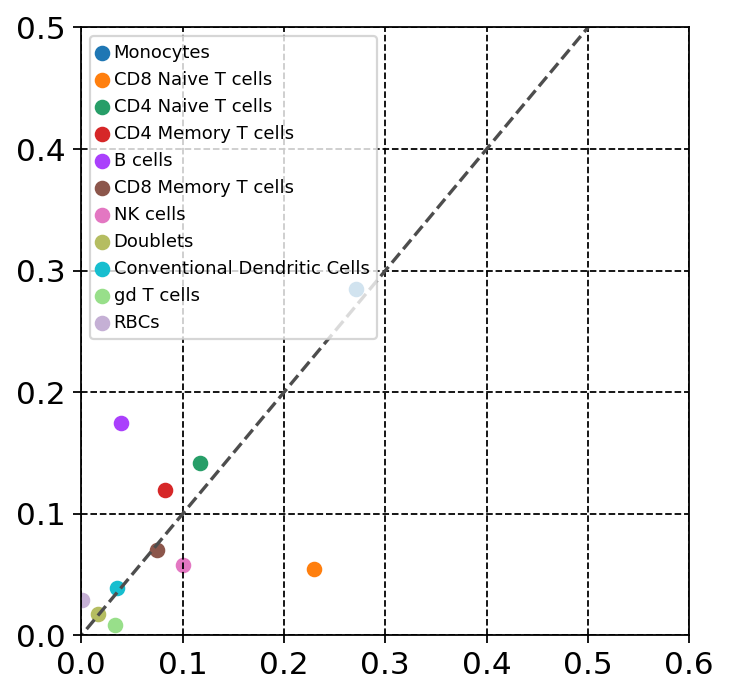

In [1288]:
#100k donor1 sng, TMA-003
fig, ax = plt.subplots()

x=d1_100k_sng_proportions
y=cytof_umap_proportions_003
xlabel='d1_100k_singlets'
ylabel='cytof_TMA_003'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.6))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

/wynton/group/ye/david/Cyto-seq/200204/200219
/wynton/group/ye/david/Cyto-seq/200204


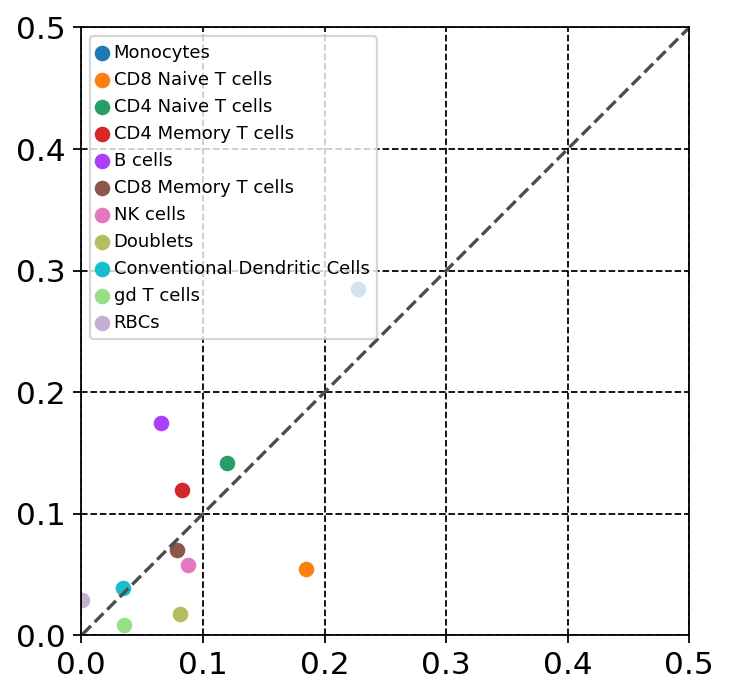

In [1289]:
#100k donor1 mpl, TMA-003
fig, ax = plt.subplots()

x=d1_100k_mpl_proportions
y=cytof_umap_proportions_003
xlabel='d1_100k_multiplets'
ylabel='cytof_TMA_003'

colors = vega_20_scanpy[0:20]
CD14 = plt.scatter(x[0], y[0], marker='o', color=colors[0])
CD8_naive = plt.scatter(x[1], y[1], marker='o', color=colors[1])
CD4_naive  = plt.scatter(x[2], y[2], marker='o', color=colors[2])
CD4_mem  = plt.scatter(x[3], y[3], marker='o', color=colors[3])
B  = plt.scatter(x[4], y[4], marker='o', color=colors[4])
CD8_mem = plt.scatter(x[5], y[5], marker='o', color=colors[5])
NK = plt.scatter(x[6], y[6], marker='o', color=colors[6])
doublets = plt.scatter(x[7], y[7], marker='o', color=colors[7])
cDC = plt.scatter(x[8], y[8], marker='o', color=colors[8])
gd  = plt.scatter(x[9], y[9], marker='o', color=colors[11])
rbc  = plt.scatter(x[10], y[10], marker='o', color=colors[13])

plt.legend((CD14,CD8_naive,CD4_naive,CD4_mem,B,CD8_mem,NK,doublets,cDC,gd,rbc),
           ('Monocytes','CD8 Naive T cells','CD4 Naive T cells','CD4 Memory T cells','B cells','CD8 Memory T cells',
                     'NK cells','Doublets','Conventional Dendritic Cells',
                     'gd T cells','RBCs'),loc = 'upper left', fontsize = 'xx-small')

ax.plot([-1,1],[-1,1],ls="--", c=".3")
ax.set_xlim((0,.5))
ax.set_ylim((0,.5))
x0,x1 = ax.get_xlim()
y0,y1 = ax.get_ylim()
ax.set_aspect(abs(x1-x0)/abs(y1-y0))
ax.grid(b=True, which='major', color='k', linestyle='--')

%cd "200219"
fig.savefig((xlabel+'_'+ylabel+'_correlation'), dpi=600)
%cd "/wynton/group/ye/david/Cyto-seq/200204"

In [1296]:
stats.pearsonr(d0_100k_all_proportions, cytof_umap_proportions_003)

(0.9185605862480786, 6.527448924001673e-05)

In [1297]:
stats.pearsonr(d0_100k_sng_proportions, cytof_umap_proportions_003)

(0.9023195270666244, 0.0001444357722000025)

In [1298]:
stats.pearsonr(d0_100k_mpl_proportions, cytof_umap_proportions_003)

(0.9239522238184391, 4.8342709791759594e-05)

In [1302]:
stats.pearsonr(d1_100k_all_proportions, cytof_umap_proportions_001)

(0.9607612928409139, 2.5974676654865934e-06)

In [1303]:
stats.pearsonr(d1_100k_sng_proportions, cytof_umap_proportions_001)

(0.961959012443055, 2.2631990468839775e-06)

In [1304]:
stats.pearsonr(d1_100k_mpl_proportions, cytof_umap_proportions_001)

(0.9359368319146705, 2.2742164213560468e-05)

In [1284]:
stats.pearsonr(d0_100k_all_proportions, cytof_umap_proportions_001)

(0.724107703209672, 0.011742773410942342)

In [1285]:
stats.pearsonr(d0_100k_sng_proportions, cytof_umap_proportions_001)

(0.7393733601311383, 0.009312401994065422)

In [1286]:
stats.pearsonr(d0_100k_mpl_proportions, cytof_umap_proportions_001)

(0.6893125515513205, 0.018951515532091023)

In [1290]:
stats.pearsonr(d1_100k_all_proportions, cytof_umap_proportions_003)

(0.6465494454509836, 0.03157784759873397)

In [1291]:
stats.pearsonr(d1_100k_sng_proportions, cytof_umap_proportions_003)

(0.6265971180804246, 0.03911925928085521)

In [1292]:
stats.pearsonr(d1_100k_mpl_proportions, cytof_umap_proportions_003)

(0.6614661548732232, 0.026652426521563514)

In [ ]:
#sng/mpl comparisons

In [1319]:
stats.pearsonr(d0_200k_sng_proportions, d0_200k_mpl_proportions)

(0.9475680473215399, 9.39008224150133e-06)

In [1321]:
stats.pearsonr(d1_200k_sng_proportions, d1_200k_mpl_proportions)

(0.9722720689813311, 5.536190892363973e-07)

In [1320]:
stats.pearsonr(d0_100k_sng_proportions, d0_100k_mpl_proportions)

(0.9679387198419189, 1.0574778661432174e-06)

In [1322]:
stats.pearsonr(d1_100k_sng_proportions, d1_100k_mpl_proportions)

(0.9605341078825341, 2.6649516143078087e-06)